In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from matplotlib import colors
from mpl_toolkits.mplot3d import Axes3D  # noqa
from matplotlib.colors import hsv_to_rgb
from itertools import chain
from yaniv_region_growing import regionGrow
import pandas as pd

In [2]:
# from utils.plots import get_pixel_colors,plotRGB,plotHSV,plot_images
# from utils.smoothing import mean_smooth_rgb
# from utils.segmenting import segment_kmeans,pick_color_segment
# from utils.hough import r_theta_to_points,find_parallel_lines,draw_hough_lines,hough_line,show_hough_line
# from utils.fourier import fourier_trans,plot_fourier,build_circle_mask,build_rectangle_low_pass,build_rectangle_mask,mask_fourier

In [3]:
def get_pixel_colors(img_rgb):
    pixel_colors = img_rgb.reshape((np.shape(img_rgb)[0] * np.shape(img_rgb)[1], 3))
    norm = colors.Normalize(vmin=-1.0, vmax=1.0)
    norm.autoscale(pixel_colors)
    return norm(pixel_colors).tolist()
    

def plotRGB(img,pixel_colors):
    r, g, b = cv2.split(img)

    fig = plt.figure()
    axis = fig.add_subplot(1, 1, 1, projection="3d")
    

    axis.scatter(
        r.flatten(), g.flatten(), b.flatten(), facecolors=pixel_colors, marker="."
    )
    axis.set_xlabel("Red")
    axis.set_ylabel("Green")
    axis.set_zlabel("Blue")
    plt.show()

def plotHSV(img,pixel_colors):
    
    h, s, v = cv2.split(img)

    fig = plt.figure()
    axis = fig.add_subplot(1, 1, 1, projection="3d")
    #pixel_colors = pic.reshape((np.shape(pic)[0] * np.shape(pic)[1], 3))
    axis.scatter(
        h.flatten(), s.flatten(), v.flatten(), facecolors=pixel_colors, marker="."
    )
    axis.set_xlabel("Hue")
    axis.set_ylabel("Saturation")
    axis.set_zlabel("Value")
    plt.show()
    
def plot_images(imgs,titles,n_rows,n_cols,figsize=(20,20)):
    fig,axes = plt.subplots(n_rows,n_cols,figsize=figsize)
    
    for ax,image,title in zip(axes.flatten(),imgs,titles):
        ax.imshow(image)
        ax.set_title(title)

def mean_smooth_rgb(img,kernel_size):
    def mean_smooth_channel(channel,kernel_size):
        mean_kernel = np.ones(kernel_size,np.float32)/(kernel_size[0]*kernel_size[1])
        return cv2.filter2D(channel,-1,mean_kernel)
    r,g,b = cv2.split(img)
    
    r = mean_smooth_channel(r,kernel_size)
    g = mean_smooth_channel(g,kernel_size)
    b = mean_smooth_channel(b,kernel_size)
    
    return cv2.merge((r,g,b))

def segment_kmeans(img, n_clusters,random_state=0):
    img_normalized = img/255.0
    img_n = img_normalized.reshape(img_normalized.shape[0]*img_normalized.shape[1], img_normalized.shape[2]) # transform to 2d array
    kmeans = KMeans(n_clusters=n_clusters,random_state=random_state).fit(img_n)
    colors_pool = np.array([
        [255,77,0],
        [30,144,255],
        [173,255,47],        
        [255,0,0],
        [0,0,0],
        [255,255,255],
        [255,4,0]
        
    ])
    len_ = colors_pool.shape[0]
    segments_colors = np.array([colors_pool[i%len_] for i in range(len(kmeans.cluster_centers_))])
    img_segmented = segments_colors[kmeans.labels_]
    return img_segmented.reshape(img.shape[0],img.shape[1],img.shape[2])

def segment_kmeans_labels(img, n_clusters,random_state=0):
    img_normalized = img/255.0
    img_n = img_normalized.reshape(img_normalized.shape[0]*img_normalized.shape[1], img_normalized.shape[2]) # transform to 2d array
    kmeans = KMeans(n_clusters=n_clusters,random_state=random_state).fit(img_n)
    colors_pool = np.array([
        [255,77,0],
        [30,144,255],
        [173,255,47],        
        [255,0,0],
        [0,0,0],
        [255,255,255],
        [255,4,0]
        
    ])
    
    return kmeans.labels_.reshape(img.shape[0],img.shape[1])#img_segmented.reshape(img.shape[0],img.shape[1],img.shape[2])


def pick_color_segment(img_hsv,img_rgb,color="orange"):
    #img_rpf_000102_kmeans_hsv = cv2.cvtColor((kmeans_img*255).astype(np.uint8),cv2.COLOR_RGB2HSV)
    light_orange = (1, 190, 200)
    dark_orange = (18, 255, 255)
    orange_mask = cv2.inRange(img_hsv,light_orange,dark_orange)
    #segment_orange_img = cv2.bitwise_and((kmeans_img*255).astype(np.uint8),(kmeans_img*255).astype(np.uint8),mask=orange_mask)
    segment_orange_img = cv2.bitwise_and(img_rgb,img_rgb,mask=orange_mask)
    return orange_mask,segment_orange_img
    #plot_images([orange_mask,segment_orange_img],["orange_mask","segment_orange_img"],1,2)

def r_theta_to_points(r,theta,point_distance=1000):
    a,b = np.cos(theta), np.sin(theta)
    x0,y0 = a*r, b*r
    x1,y1 = int(x0 + point_distance * (-b)), int(y0 + point_distance*a)
    x2,y2 = int(x0 - point_distance * (-b)), int(y0 - point_distance*a)
    return [(x1,y1),(x2,y2)]

def find_parallel_lines(out_lines,max_theta_thresh = 0.06,min_r_thresh = 100):
    parrallel_lines = [] # will contain indexes from out_lines
    for line_i in range(len(out_lines)):
        for line_j in range(len(out_lines)):
            if line_i == line_j:
                continue
                
            # check for duplicates
            if (line_j,line_i) in parrallel_lines or (line_i,line_j) in parrallel_lines:
                continue
            r_diff = abs(out_lines[line_i][0]-out_lines[line_j][0])
            theta_diff = abs(out_lines[line_i][1]-out_lines[line_j][1])
            if  r_diff > min_r_thresh and theta_diff < max_theta_thresh:
                parrallel_lines.append((line_i,line_j))
    return parrallel_lines

def find_most_parallel_line(out_lines):
    '''
        This problematic because to which feature you give the prefered ordering? 
    '''
    chosen_lines_i = out_lines[0] # will contain indexes from out_lines
    min_r_dif = 999999999999
    min_theta_diff = 9999999999
    for line_i in range(len(out_lines)):
            r_diff = abs(out_lines[line_i][0]-out_lines[chosen_lines_i][0])
            theta_diff = abs(out_lines[line_i][1]-out_lines[chosen_lines_i][1])
            if  r_diff > min_r_dif and theta_diff < min_theta_diff:
                min_r_dif
                
    return parrallel_lines

def draw_hough_lines(img,edge_map,
                     theta_res,rho_res=1,min_votes=150,point_distance=1000,
                    lines_color = (255,0,0)):
    '''
        theta_res = np.pi/180
    '''
    
    lines_map = cv2.HoughLines(edge_map,rho_res,theta_res,min_votes,0,0)
    
    #print(lines_map)
    
    
    outlines  = []
    #for r,theta in lines_map:
    for line in lines_map:
        r,theta = line[0]
        a,b = np.cos(theta), np.sin(theta)
        x0,y0 = a*r, b*r
        x1,y1 = int(x0 + point_distance * (-b)), int(y0 + point_distance*a)
        x2,y2 = int(x0 - point_distance * (-b)), int(y0 - point_distance*a)
        outlines.append([r,theta])
        cv2.line(img,(x1,y1),(x2,y2),lines_color,2)
    return img,outlines


import imageio
import math

def hough_line(img, angle_step=1, lines_are_white=True, value_threshold=5):
    """
    Hough transform for lines
    Input:
    img - 2D binary image with nonzeros representing edges
    angle_step - Spacing between angles to use every n-th angle
                 between -90 and 90 degrees. Default step is 1.
    lines_are_white - boolean indicating whether lines to be detected are white
    value_threshold - Pixel values above or below the value_threshold are edges
    Returns:
    accumulator - 2D array of the hough transform accumulator
    theta - array of angles used in computation, in radians.
    rhos - array of rho values. Max size is 2 times the diagonal
           distance of the input image.
    """
    # Rho and Theta ranges
    thetas = np.deg2rad(np.arange(-90.0, 90.0, angle_step))
    width, height = img.shape
    diag_len = int(round(math.sqrt(width * width + height * height)))
    rhos = np.linspace(-diag_len, diag_len, diag_len * 2)

    # Cache some resuable values
    cos_t = np.cos(thetas)
    sin_t = np.sin(thetas)
    num_thetas = len(thetas)

    # Hough accumulator array of theta vs rho
    accumulator = np.zeros((2 * diag_len, num_thetas), dtype=np.uint8)
    # (row, col) indexes to edges
    are_edges = img > value_threshold if lines_are_white else img < value_threshold
    y_idxs, x_idxs = np.nonzero(are_edges)

    # Vote in the hough accumulator
    for i in range(len(x_idxs)):
        x = x_idxs[i]
        y = y_idxs[i]

        for t_idx in range(num_thetas):
            # Calculate rho. diag_len is added for a positive index
            rho = diag_len + int(round(x * cos_t[t_idx] + y * sin_t[t_idx]))
            accumulator[rho, t_idx] += 1

    return accumulator, thetas, rhos


def show_hough_line(img, accumulator, thetas, rhos, save_path=None):
    plt.imshow(accumulator, aspect='auto',cmap='jet', extent=[np.rad2deg(thetas[-1]), np.rad2deg(thetas[0]), rhos[-1], rhos[0]])
    if save_path is not None:
        plt.savefig(save_path, bbox_inches='tight')
    plt.show()

def fourier_trans(img_,mask):
    img_fft = np.fft.fft2(img_)
    fshift = np.fft.fftshift(img_fft)
    amplitude = 20 * np.log(np.abs(fshift) + 1)
    fshift*=mask
    amplitude_filtered = 20 * np.log(np.abs(fshift) + 1) 
    return np.abs(np.fft.ifft2(np.fft.ifftshift(fshift))),amplitude,amplitude_filtered #np.abs

def plot_fourier(img,amplitude,mask,amplitude_filtered,img_filtered):
    fig, axes = plt.subplots(2,3, figsize=(20, 10))
    fig.delaxes(axes[1,2])
    for img, ax, title in zip([img, amplitude, mask, amplitude_filtered, np.abs(img_filtered)],
                              chain.from_iterable(axes), 
                              ["img", "Amplitude Spectrum", "Filter", "Filtered Amplitude Spectrum", "img filtered"]):
        ax.imshow(img, cmap='gray')
        
def build_circle_mask(radius,channel):
    circle_mask = np.zeros_like(channel)
    rows,cols = channel.shape
    crow,ccol = rows//2,cols//2

    for i in range(crow-radius, crow+radius):
            for j in range(ccol-radius, ccol + radius):
                if (crow - i) ** 2 + (ccol - j) ** 2 <= radius**2:
                    circle_mask[i,j]=1
    return circle_mask

def build_rectangle_low_pass(height,width,channel):
    zeros = np.zeros_like(channel)
    rows,cols = channel.shape
    crow,ccol = rows//2,cols//2
    zeros[crow-height:crow+height,ccol-width:ccol+width] = 1
    return zeros

def build_rectangle_mask(height,width,channel,crow,ccol):
    ones = np.ones_like(channel)
    print(ccol)
    print(ccol+width)
    ones[crow-height//2:crow+height//2,ccol-width//2:ccol+width//2] = 0
    return ones


def mask_fourier(channels,masks):
    filtered_channels = []
    for channel,mask in zip(channels,masks):
        filtered_channel,amplitude,amplitude_filtered = fourier_trans(channel,mask)
        filtered_channels.append(filtered_channel)
        plot_fourier(channel,amplitude,mask,amplitude_filtered,filtered_channel)
    
    return np.dstack([filtered_channels[0].astype(int), 
                       filtered_channels[1].astype(int), 
                       filtered_channels[2].astype(int)])

In [11]:
fragments_names = []
borders_widths = []
averaged_colors = []

# RPf_00004

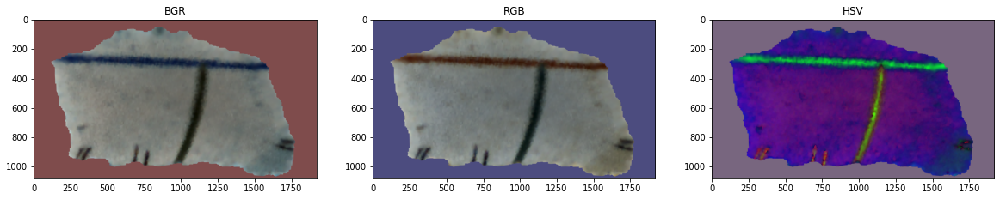

In [4]:
img_name = "RPf_00004.png"
img = cv2.imread(f"images/raw/border/done/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
plot_images([img,img_rgb,img_hsv],["BGR","RGB","HSV"],1,3)

In [5]:
smoothed_img = cv2.bilateralFilter(img_rgb,25,100,100) #cv2.bilateralFilter(mean_smooth_rgb(img_rpf_000102_rgb,(100,100)),9,75,75)

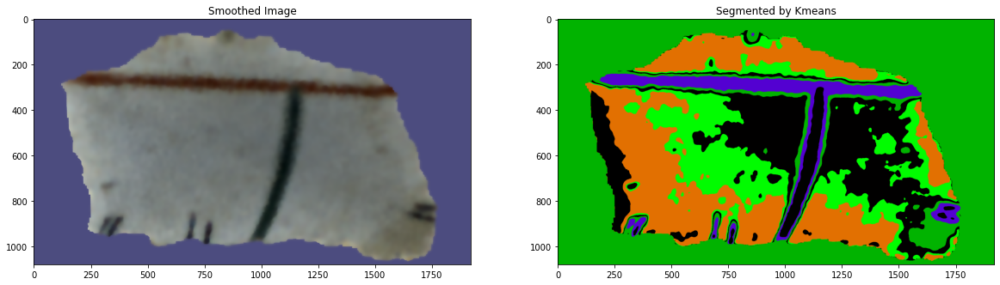

In [6]:
kmeans_img = segment_kmeans(smoothed_img,10)
plot_images([smoothed_img,(kmeans_img*255).astype(np.uint8)],["Smoothed Image","Segmented by Kmeans"],1,2)

C:\Users\yaniv\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in true_divide
  This is separate from the ipykernel package so we can avoid doing imports until


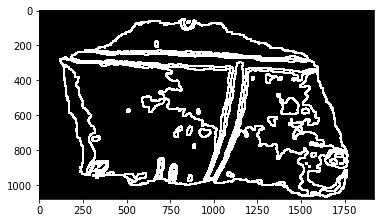

In [7]:
img_kmeans_gray = cv2.cvtColor((kmeans_img*255).astype(np.uint8),cv2.COLOR_RGB2GRAY)
img_edge_map = cv2.Canny(img_kmeans_gray,70,150)
plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")

[[214.0, 1.6231562], [206.0, 1.6231562], [231.0, 1.6057029], [269.0, 1.6231562]]


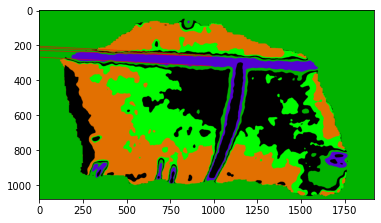

In [8]:
img_with_lines,out_lines = draw_hough_lines(
        (kmeans_img*255).astype(np.uint8),
        img_edge_map, #1/(1+np.abs(rpf_000102_gray_edge_map))
        1*np.pi/180,min_votes=200,
        lines_color=(255,0,0))
plt.imshow(img_with_lines)
print(out_lines)

In [9]:
max_theta_thresh = 0.01
min_r_thresh = 30
parrallel_lines = find_parallel_lines(out_lines,max_theta_thresh=max_theta_thresh,min_r_thresh=5)
parrallel_lines

[(0, 1), (0, 3), (1, 3)]

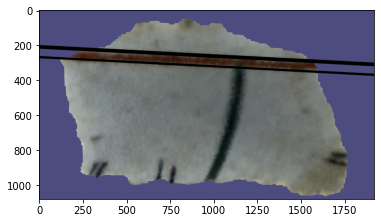

In [10]:
img_rgb_with_lines = np.copy(img_rgb)
lines_color=(0,0,0)
for parralel_pair in parrallel_lines:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1],point_distance=2000)
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
    #second_line = parralel_pair[1]
plt.imshow(img_rgb_with_lines)

In [120]:
out_lines[parrallel_lines[0][0]]

[214.0, 1.6231562]

In [12]:
fragments_names.append(img_name)
print(fragments_names)
#for parralel_pair in parrallel_lines:
    

['RPf_00004.png']


In [13]:
lines_diff = out_lines[parrallel_lines[0][0]][0] - out_lines[parrallel_lines[0][1]][0]
print(lines_diff)
borders_widths.append(lines_diff)
print(borders_widths)

8.0
[8.0]


[0 1 2 3 4 5 6 7 8 9]
6


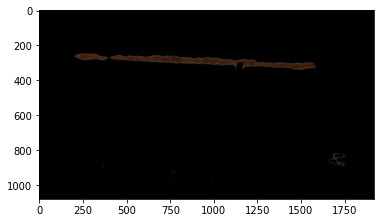

In [15]:
kmeans_labels = segment_kmeans_labels(smoothed_img,10)

label_ = kmeans_labels[219,1000]
print(np.unique(kmeans_labels))
print(label_)

label_ = 2

label_mask = np.where(kmeans_labels == label_, 1,0)

# r_,g_,b_ = cv2.split(img_rgb)
# r_ = np.where(r_==label_,r_,0)
# b_ = np.bitwise_and(b_,label_mask)
# g_ = np.bitwise_and(g_,label_mask)
# img_rgb_masked = cv2.merge((r_,g_,b_))

new_img = np.copy(img_rgb)#.reshape(img_rgb.shape[0]*img_rgb.shape[1], img_rgb.shape[2])


for i in range(img_rgb.shape[0]):
    for j in range(img_rgb.shape[1]):
        if label_mask[i,j] != 1:
            new_img[i,j] = (0,0,0)
plt.imshow(new_img)

In [19]:
img_as_vec = new_img.reshape(img_rgb.shape[0]*img_rgb.shape[1], img_rgb.shape[2])
zeros = np.zeros((1,3))
#img_as_vec = img_as_vec[np.all()]
new_vector = []

for i_row in range(img_as_vec.shape[0]):
    if not np.all(img_as_vec[i_row] == zeros):
        new_vector.append(img_as_vec[i_row])

mean_ = np.mean(new_vector,axis=0)
averaged_colors.append(mean_)
print(len(new_vector))
print(mean_)


46252
[63.30692727 38.90960391 25.48341693]


# RPf_00006

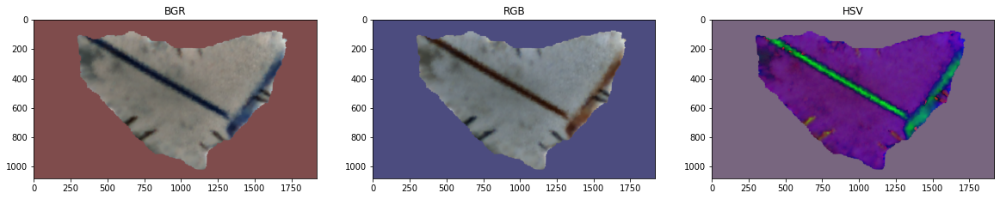

In [15]:
img_name = "RPf_00006.png"
img = cv2.imread(f"images/raw/border/done/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
plot_images([img,img_rgb,img_hsv],["BGR","RGB","HSV"],1,3)

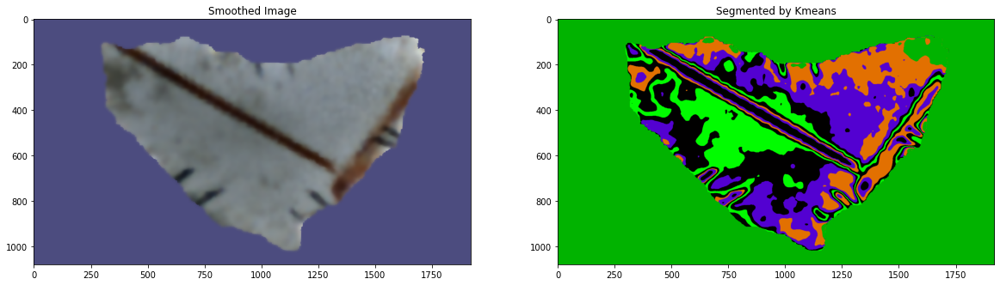

In [16]:
smoothed_img = cv2.bilateralFilter(img_rgb,25,100,100) #cv2.bilateralFilter(mean_smooth_rgb(img_rpf_000102_rgb,(100,100)),9,75,75)

kmeans_img = segment_kmeans(smoothed_img,10)
plot_images([smoothed_img,(kmeans_img*255).astype(np.uint8)],["Smoothed Image","Segmented by Kmeans"],1,2)

In [31]:
img_kmeans_gray = cv2.cvtColor((kmeans_img*255).astype(np.uint8),cv2.COLOR_RGB2GRAY)
img_edge_map = cv2.Canny(img_kmeans_gray,70,150)
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")

img_with_lines,out_lines = draw_hough_lines(
        (kmeans_img*255).astype(np.uint8),
        img_edge_map, #1/(1+np.abs(rpf_000102_gray_edge_map))
        1*np.pi/180,min_votes=200,
        lines_color=(255,0,0))
#plt.imshow(img_with_lines)
print(out_lines)
max_theta_thresh = 0.001
min_r_thresh = 30
parrallel_lines = find_parallel_lines(out_lines,max_theta_thresh=max_theta_thresh,min_r_thresh=min_r_thresh)
parrallel_lines

[[-45.0, 2.0769417], [-62.0, 2.0943952], [-53.0, 2.0769417], [-102.0, 2.0943952], [-109.0, 2.0943952], [-58.0, 2.0943952], [-73.0, 2.1118484], [-129.0, 2.1118484], [-115.0, 2.0943952], [-83.0, 2.1118484], [-93.0, 2.0769417], [-70.0, 2.0943952], [-135.0, 2.1118484], [-41.0, 2.0769417], [-121.0, 2.1118484], [-99.0, 2.0769417], [-95.0, 2.1293018], [-143.0, 2.146755], [-31.0, 2.0594885], [-21.0, 2.0594885], [-133.0, 2.1118484], [-91.0, 2.0769417]]


[(0, 10),
 (0, 15),
 (0, 21),
 (1, 3),
 (1, 4),
 (1, 8),
 (2, 10),
 (2, 15),
 (2, 21),
 (3, 5),
 (3, 11),
 (4, 5),
 (4, 11),
 (5, 8),
 (6, 7),
 (6, 12),
 (6, 14),
 (6, 20),
 (7, 9),
 (8, 11),
 (9, 12),
 (9, 14),
 (9, 20),
 (10, 13),
 (13, 15),
 (13, 21)]

C:\Users\yaniv\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in true_divide
  if sys.path[0] == '':


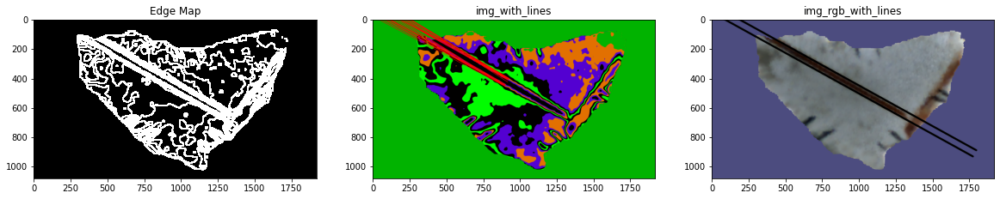

In [34]:
img_rgb_with_lines = np.copy(img_rgb)
lines_color=(0,0,0)
for parralel_pair in parrallel_lines[:1]:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1],point_distance=2000)
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
    #second_line = parralel_pair[1]
#plt.imshow(img_rgb_with_lines)
figsize=(20,20)
fig,axes = plt.subplots(1,3,figsize=figsize)
axes[0].imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
axes[0].set_title("Edge Map")
for ax,image,title in zip(axes.flatten()[1:],[img_with_lines,img_rgb_with_lines],["img_with_lines","img_rgb_with_lines"]):
    ax.imshow(image)
    ax.set_title(title)

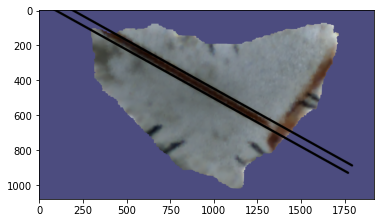

In [35]:
plt.imshow(img_rgb_with_lines)

In [24]:
fragments_names.append(img_name)
print(fragments_names)

['RPf_00004.png', 'RPf_00006.png']


In [25]:
lines_diff = out_lines[parrallel_lines[0][0]][0] - out_lines[parrallel_lines[0][1]][0]
print(lines_diff)
borders_widths.append(lines_diff)
print(borders_widths)

8.0
[8.0, 8.0]


[0 1 2 3 4 5 6 7 8 9]
6


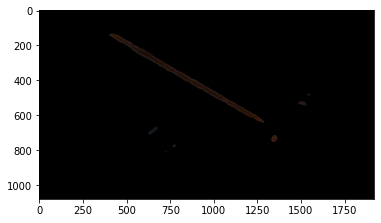

In [28]:
kmeans_labels = segment_kmeans_labels(smoothed_img,10)

label_ = kmeans_labels[219,1000]
print(np.unique(kmeans_labels))
print(label_)

label_ = 4

label_mask = np.where(kmeans_labels == label_, 1,0)

# r_,g_,b_ = cv2.split(img_rgb)
# r_ = np.where(r_==label_,r_,0)
# b_ = np.bitwise_and(b_,label_mask)
# g_ = np.bitwise_and(g_,label_mask)
# img_rgb_masked = cv2.merge((r_,g_,b_))

new_img = np.copy(img_rgb)#.reshape(img_rgb.shape[0]*img_rgb.shape[1], img_rgb.shape[2])


for i in range(img_rgb.shape[0]):
    for j in range(img_rgb.shape[1]):
        if label_mask[i,j] != 1:
            new_img[i,j] = (0,0,0)
plt.imshow(new_img)

In [29]:
img_as_vec = new_img.reshape(img_rgb.shape[0]*img_rgb.shape[1], img_rgb.shape[2])
zeros = np.zeros((1,3))
#img_as_vec = img_as_vec[np.all()]
new_vector = []

for i_row in range(img_as_vec.shape[0]):
    if not np.all(img_as_vec[i_row] == zeros):
        new_vector.append(img_as_vec[i_row])

mean_ = np.mean(new_vector,axis=0)
averaged_colors.append(mean_)
print(len(new_vector))
print(mean_)


31623
[41.23520855 24.60380103 18.23103437]


# RPf_00008

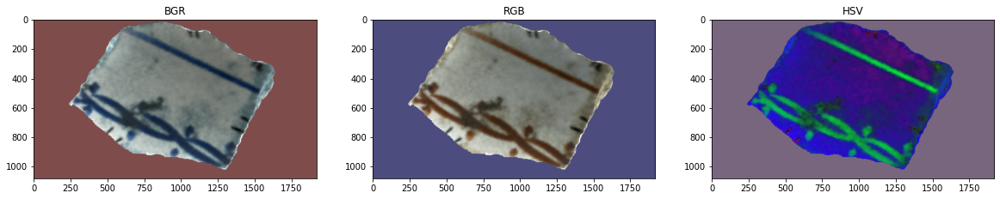

In [36]:
img_name = "RPf_00008.png"
img = cv2.imread(f"images/raw/border/done/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
plot_images([img,img_rgb,img_hsv],["BGR","RGB","HSV"],1,3)

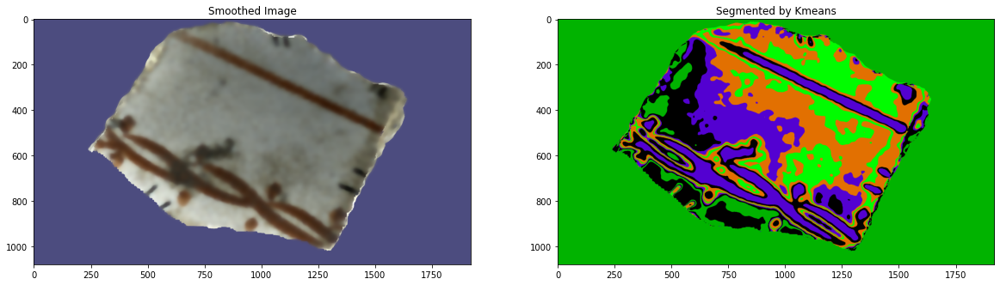

In [37]:
smoothed_img = cv2.bilateralFilter(img_rgb,25,100,100) #cv2.bilateralFilter(mean_smooth_rgb(img_rpf_000102_rgb,(100,100)),9,75,75)

kmeans_img = segment_kmeans(smoothed_img,10)
plot_images([smoothed_img,(kmeans_img*255).astype(np.uint8)],["Smoothed Image","Segmented by Kmeans"],1,2)

In [39]:
img_kmeans_gray = cv2.cvtColor((kmeans_img*255).astype(np.uint8),cv2.COLOR_RGB2GRAY)
img_edge_map = cv2.Canny(img_kmeans_gray,70,150)
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")

img_with_lines,out_lines = draw_hough_lines(
        (kmeans_img*255).astype(np.uint8),
        img_edge_map, #1/(1+np.abs(rpf_000102_gray_edge_map))
        1*np.pi/180,min_votes=200,
        lines_color=(255,0,0))
#plt.imshow(img_with_lines)
print(out_lines)
max_theta_thresh = 0.001
min_r_thresh = 30
parrallel_lines = find_parallel_lines(out_lines,
                                      max_theta_thresh=max_theta_thresh,
                                      min_r_thresh=min_r_thresh)
print(parrallel_lines)

[[167.0, 2.1293018], [-211.0, 2.024582], [-221.0, 2.0071287], [-204.0, 2.024582], [-245.0, 2.024582], [184.0, 2.1118484]]
[(1, 4), (3, 4)]


In [40]:
img_rgb_with_lines = np.copy(img_rgb)
lines_color=(0,0,0)
for parralel_pair in parrallel_lines:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1],points_distance=2000)
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
    #second_line = parralel_pair[1]
#plt.imshow(img_rgb_with_lines)
figsize=(20,20)
fig,axes = plt.subplots(1,3,figsize=figsize)
axes[0].imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
axes[0].set_title("Edge Map")
for ax,image,title in zip(axes.flatten()[1:],[img_with_lines,img_rgb_with_lines],["img_with_lines","img_rgb_with_lines"]):
    ax.imshow(image)
    ax.set_title(title)

TypeError: r_theta_to_points() got an unexpected keyword argument 'points_distance'

In [33]:
fragments_names.append(img_name)
print(fragments_names)

['RPf_00004.png', 'RPf_00006.png', 'RPf_00008.png']


In [64]:
parrallel_lines
print(fragments_names)

['RPf_00004.png', 'RPf_00006.png', 'RPf_00008.png']


In [37]:
lines_diff = out_lines[parrallel_lines[1][0]][0] - out_lines[parrallel_lines[1][1]][0]
print(lines_diff)
print(borders_widths)

41.0
[8.0, 8.0]


In [39]:
borders_widths.append(lines_diff)

[0 1 2 3 4 5 6 7 8 9]
5


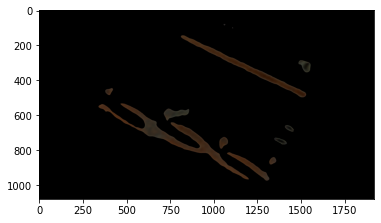

In [62]:
kmeans_labels = segment_kmeans_labels(smoothed_img,10)

label_ = kmeans_labels[219,1000]
print(np.unique(kmeans_labels))
print(label_)

label_ = 2

label_mask = np.where(kmeans_labels == label_, 1,0)

# r_,g_,b_ = cv2.split(img_rgb)
# r_ = np.where(r_==label_,r_,0)
# b_ = np.bitwise_and(b_,label_mask)
# g_ = np.bitwise_and(g_,label_mask)
# img_rgb_masked = cv2.merge((r_,g_,b_))

new_img = np.copy(img_rgb)#.reshape(img_rgb.shape[0]*img_rgb.shape[1], img_rgb.shape[2])


for i in range(img_rgb.shape[0]):
    for j in range(img_rgb.shape[1]):
        if label_mask[i,j] != 1:
            new_img[i,j] = (0,0,0)
plt.imshow(new_img)

In [65]:
img_as_vec = new_img.reshape(img_rgb.shape[0]*img_rgb.shape[1], img_rgb.shape[2])
zeros = np.zeros((1,3))
#img_as_vec = img_as_vec[np.all()]
new_vector = []

for i_row in range(img_as_vec.shape[0]):
    if not np.all(img_as_vec[i_row] == zeros):
        new_vector.append(img_as_vec[i_row])

mean_ = np.mean(new_vector,axis=0)
averaged_colors.append(mean_)
print(len(new_vector))
print(mean_)


88263
[64.43370382 44.07734838 28.07722375]


# RPf_00017

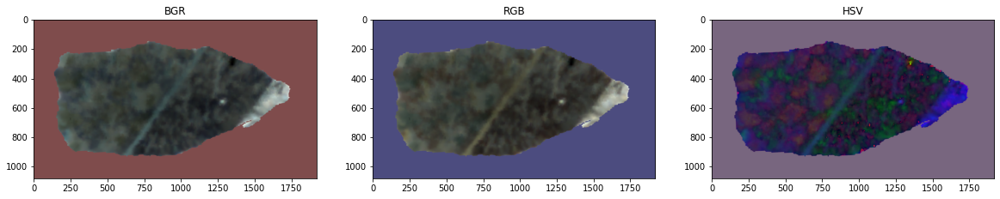

In [91]:
img_name = "RPf_00017.png"
img = cv2.imread(f"images/raw/border/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
plot_images([img,img_rgb,img_hsv],["BGR","RGB","HSV"],1,3)

In [95]:
r,g,b = cv2.split(img_rgb)
rows,cols = r.shape
crow,ccol = rows//2,cols//2

None
962
970
958
966
962
970
958
966
962
970
958
966


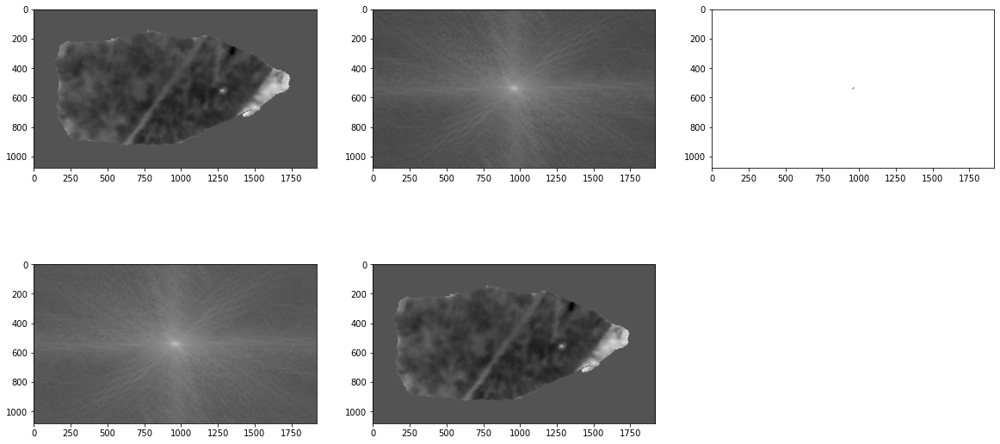

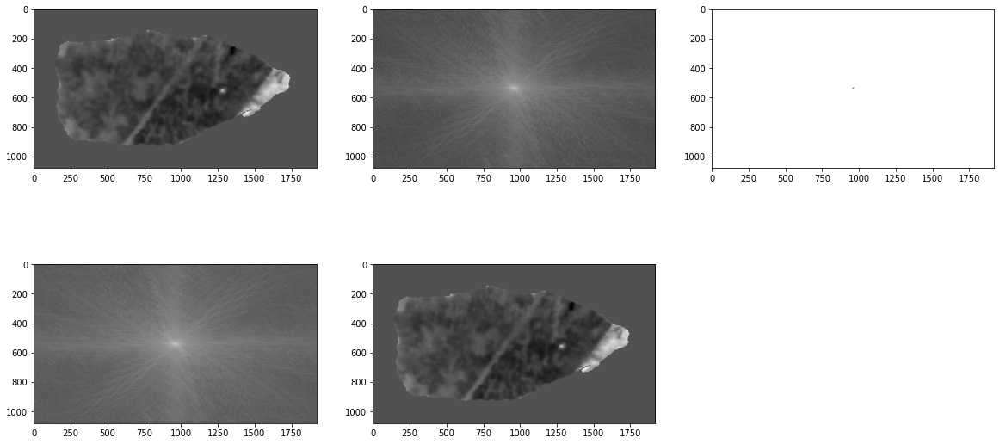

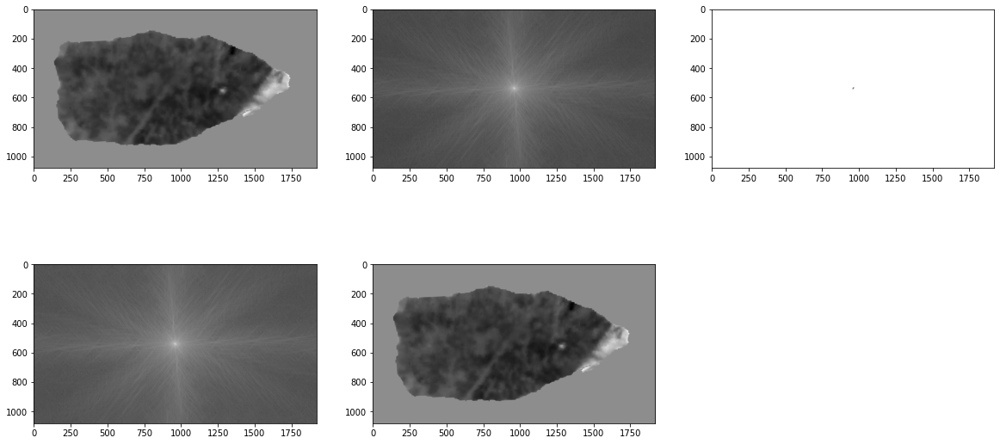

In [105]:
shift_=None
shift_col = 2
shift_row = 3
height_ = 4 # 300
width_ = 8 # 400
print(shift_)
fourier_img = mask_fourier([r,g,b],
                           [np.bitwise_not(
                               np.bitwise_xor(
                                   build_rectangle_mask(height_,width_,ch,crow-shift_row,ccol+shift_col),
                                   build_rectangle_mask(height_,width_,ch,crow+shift_row,ccol-shift_col)))
                            for ch in [r,g,b]])
#fourier_img = mask_fourier([r,g,b],[build_rectangle_mask(50*2,850*2,ch,crow,ccol) for ch in [r,g,b]])

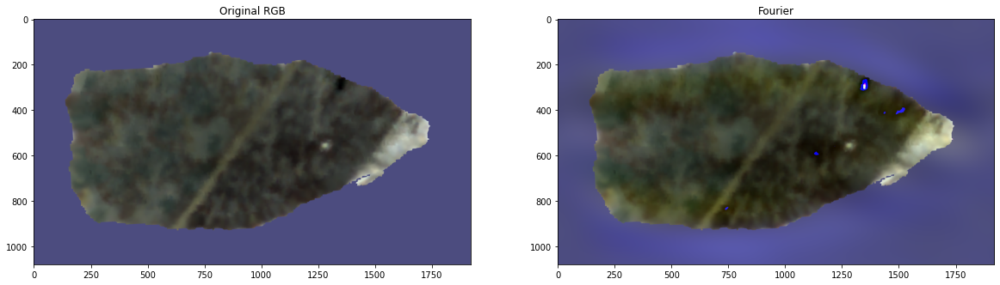

In [106]:
plot_images([img_rgb,(fourier_img*255).astype(np.uint8)],["Original RGB","Fourier"],1,2)

In [ ]:
smoothed_img = cv2.bilateralFilter(img_rgb,25,100,100) #cv2.bilateralFilter(mean_smooth_rgb(img_rpf_000102_rgb,(100,100)),9,75,75)

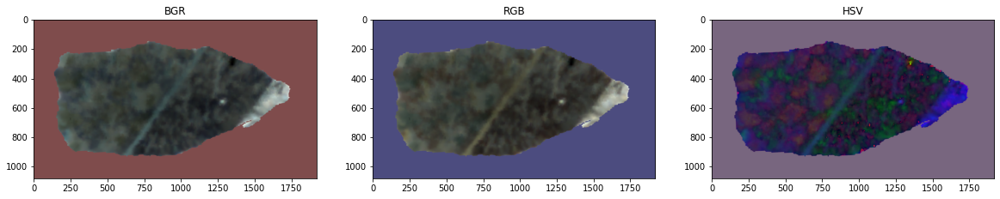

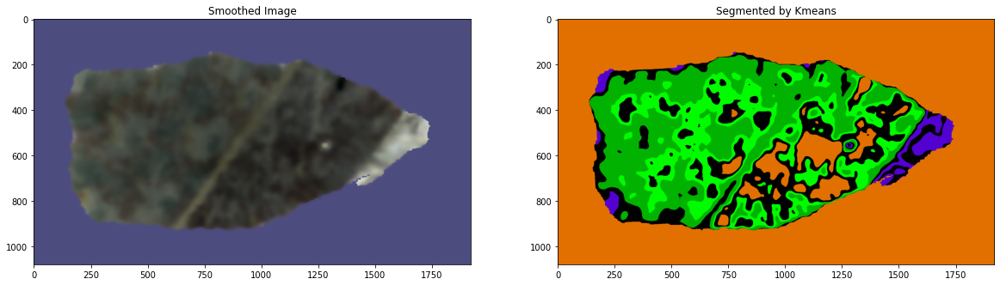

In [89]:
kmeans_img = segment_kmeans(smoothed_img,10)
plot_images([smoothed_img,(kmeans_img*255).astype(np.uint8)],["Smoothed Image","Segmented by Kmeans"],1,2)

In [90]:
img_kmeans_gray = cv2.cvtColor((kmeans_img*255).astype(np.uint8),cv2.COLOR_RGB2GRAY)
img_edge_map = cv2.Canny(img_kmeans_gray,70,150)
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")

img_with_lines,out_lines = draw_hough_lines(
        (kmeans_img*255).astype(np.uint8),
        img_edge_map, #1/(1+np.abs(rpf_000102_gray_edge_map))
        1*np.pi/180,min_votes=200,
        lines_color=(255,0,0))
#plt.imshow(img_with_lines)
print(out_lines)
max_theta_thresh = 0.001
min_r_thresh = 500
parrallel_lines = find_parallel_lines(out_lines,
                                      max_theta_thresh=max_theta_thresh,
                                      min_r_thresh=min_r_thresh)
print(parrallel_lines)

img_rgb_with_lines = np.copy(img_rgb)
lines_color=(0,0,0)
for parralel_pair in parrallel_lines:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1])
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,2)
    #second_line = parralel_pair[1]
#plt.imshow(img_rgb_with_lines)
figsize=(20,20)
fig,axes = plt.subplots(1,3,figsize=figsize)
axes[0].imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
axes[0].set_title("Edge Map")
for ax,image,title in zip(axes.flatten()[1:],[img_with_lines,img_rgb_with_lines],["img_with_lines","img_rgb_with_lines"]):
    ax.imshow(image)
    ax.set_title(title)

TypeError: 'NoneType' object is not iterable

# RPf_00018

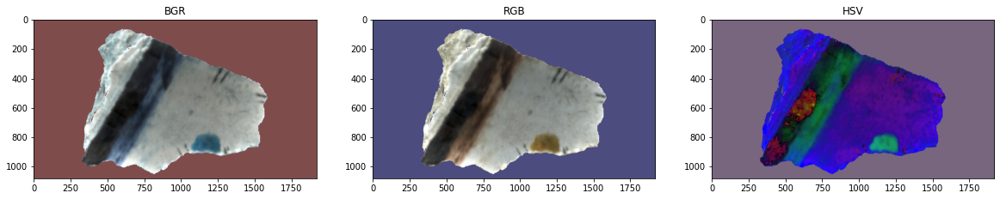

In [66]:
img_name = "RPf_00018.png"
img = cv2.imread(f"images/raw/border/done/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
plot_images([img,img_rgb,img_hsv],["BGR","RGB","HSV"],1,3)

In [67]:
smoothed_img = cv2.bilateralFilter(img_rgb,25,100,100) #cv2.bilateralFilter(mean_smooth_rgb(img_rpf_000102_rgb,(100,100)),9,75,75)

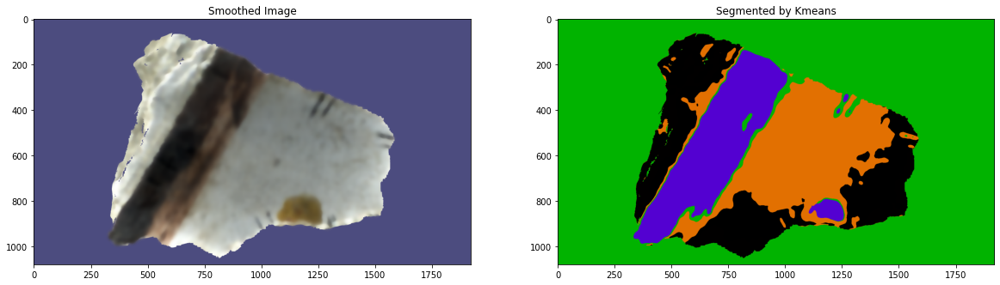

In [68]:
kmeans_img = segment_kmeans(smoothed_img,5)
plot_images([smoothed_img,(kmeans_img*255).astype(np.uint8)],["Smoothed Image","Segmented by Kmeans"],1,2)

[[766.0, 0.5235988], [764.0, 0.5235988], [769.0, 0.54105204], [765.0, 0.54105204], [775.0, 0.55850536], [761.0, 0.54105204], [749.0, 0.5061455], [772.0, 0.54105204], [746.0, 0.4886922], [759.0, 0.5061455], [1010.0, 0.55850536]]
[(4, 10)]


C:\Users\yaniv\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: divide by zero encountered in true_divide


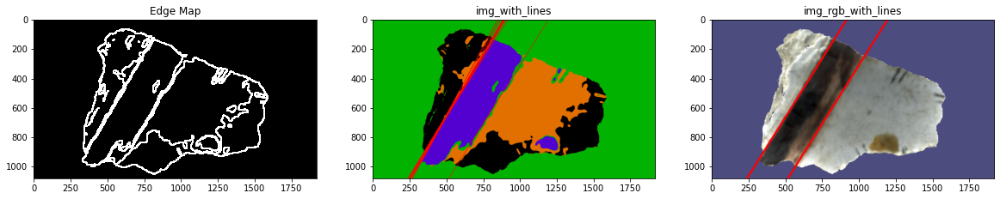

In [69]:
img_kmeans_gray = cv2.cvtColor((kmeans_img*255).astype(np.uint8),cv2.COLOR_RGB2GRAY)
img_edge_map = cv2.Canny(img_kmeans_gray,70,150)
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")

img_with_lines,out_lines = draw_hough_lines(
        (kmeans_img*255).astype(np.uint8),
        img_edge_map, #1/(1+np.abs(rpf_000102_gray_edge_map))
        1*np.pi/180,min_votes=125,
        lines_color=(255,0,0))
#plt.imshow(img_with_lines)
print(out_lines)
max_theta_thresh = 0.001
min_r_thresh = 200
parrallel_lines = find_parallel_lines(out_lines,
                                      max_theta_thresh=max_theta_thresh,
                                      min_r_thresh=min_r_thresh)
print(parrallel_lines)

img_rgb_with_lines = np.copy(img_rgb)
lines_color=(255,0,0)
for parralel_pair in parrallel_lines:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1])
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
    #second_line = parralel_pair[1]
#plt.imshow(img_rgb_with_lines)
figsize=(20,20)
fig,axes = plt.subplots(1,3,figsize=figsize)
axes[0].imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
axes[0].set_title("Edge Map")
for ax,image,title in zip(axes.flatten()[1:],[img_with_lines,img_rgb_with_lines],["img_with_lines","img_rgb_with_lines"]):
    ax.imshow(image)
    ax.set_title(title)

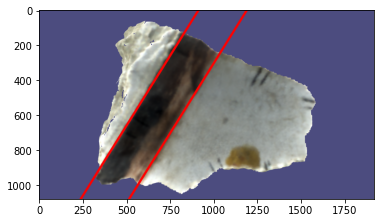

In [70]:
plt.imshow(img_rgb_with_lines)

In [71]:
fragments_names.append(img_name)
print(fragments_names)

['RPf_00004.png', 'RPf_00006.png', 'RPf_00008.png', 'RPf_00018.png']


In [72]:
lines_diff = abs(out_lines[parrallel_lines[0][0]][0] - out_lines[parrallel_lines[0][1]][0])
print(lines_diff)
borders_widths.append(lines_diff)
print(borders_widths)

235.0
[8.0, 8.0, 41.0, 235.0, 235.0]


[0 1 2 3 4]
0


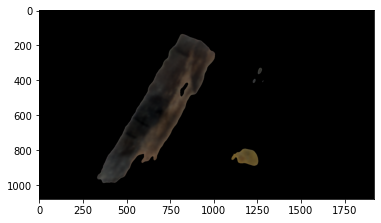

In [49]:
kmeans_labels = segment_kmeans_labels(smoothed_img,5)

label_ = kmeans_labels[219,1000]
print(np.unique(kmeans_labels))
print(label_)

label_ = 2

label_mask = np.where(kmeans_labels == label_, 1,0)

# r_,g_,b_ = cv2.split(img_rgb)
# r_ = np.where(r_==label_,r_,0)
# b_ = np.bitwise_and(b_,label_mask)
# g_ = np.bitwise_and(g_,label_mask)
# img_rgb_masked = cv2.merge((r_,g_,b_))

new_img = np.copy(img_rgb)#.reshape(img_rgb.shape[0]*img_rgb.shape[1], img_rgb.shape[2])


for i in range(img_rgb.shape[0]):
    for j in range(img_rgb.shape[1]):
        if label_mask[i,j] != 1:
            new_img[i,j] = (0,0,0)
plt.imshow(new_img)

In [57]:
img_as_vec = new_img.reshape(img_rgb.shape[0]*img_rgb.shape[1], img_rgb.shape[2])
zeros = np.zeros((1,3))
#img_as_vec = img_as_vec[np.all()]
new_vector = []

for i_row in range(img_as_vec.shape[0]):
    if not np.all(img_as_vec[i_row] == zeros):
        new_vector.append(img_as_vec[i_row])

mean_ = np.mean(new_vector,axis=0)
averaged_colors.append(mean_)
print(len(new_vector))
print(mean_)

211664
[50.22947691 43.85209105 37.53676109]


In [63]:
fragments_names.pop()

'RPf_00018.png'

In [78]:
averaged_colors_ = averaged_colors[:2]
averaged_colors_.append(averaged_colors[3])
averaged_colors_.append(averaged_colors[2])
print(averaged_colors_)
print(len(averaged_colors_))

[array([63.30692727, 38.90960391, 25.48341693]), array([41.23520855, 24.60380103, 18.23103437]), array([64.43370382, 44.07734838, 28.07722375]), array([50.22947691, 43.85209105, 37.53676109])]
4


In [79]:
averaged_colors = averaged_colors_

In [80]:
print((averaged_colors))
print(len(fragments_names))

[array([63.30692727, 38.90960391, 25.48341693]), array([41.23520855, 24.60380103, 18.23103437]), array([64.43370382, 44.07734838, 28.07722375]), array([50.22947691, 43.85209105, 37.53676109])]
4


In [82]:
r_val = []
g_val = []
b_val = []

for co in averaged_colors:
    r_val.append(co[0])
    g_val.append(co[1])
    b_val.append(co[2])

print(r_val)
print(g_val)
print(b_val)

[63.306927268010035, 41.235208550738385, 64.43370381700146, 50.229476906795675]
[38.90960390902015, 24.603801030895234, 44.07734837927558, 43.852091049965985]
[25.483416933321802, 18.231034373715335, 28.077223751741954, 37.536761093053144]


In [84]:
pd.DataFrame({
    "fragment": fragments_names,
    "width": borders_widths,
    "r":r_val,
    "g":g_val,
    "b":b_val
}).to_csv("0927.csv")

# RPf_00019

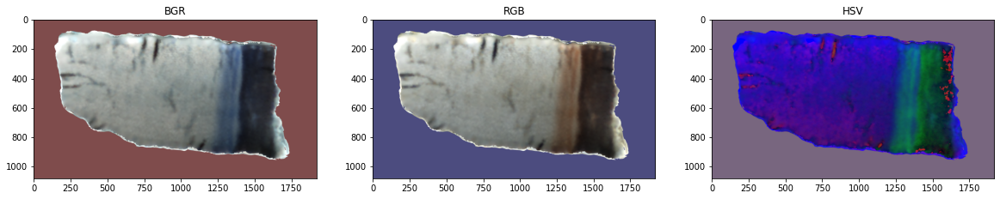

In [28]:
img_name = "RPf_00019.png"
img = cv2.imread(f"images/raw/border/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
plot_images([img,img_rgb,img_hsv],["BGR","RGB","HSV"],1,3)

In [37]:
h,s,v = cv2.split(img_hsv)
rows,cols = h.shape
crow,ccol = rows//2,cols//2

None
960
962
960
962
960
962


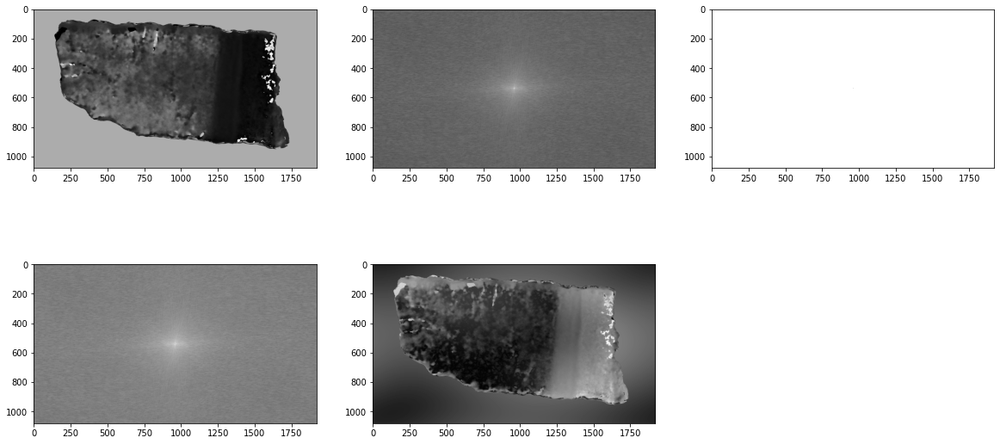

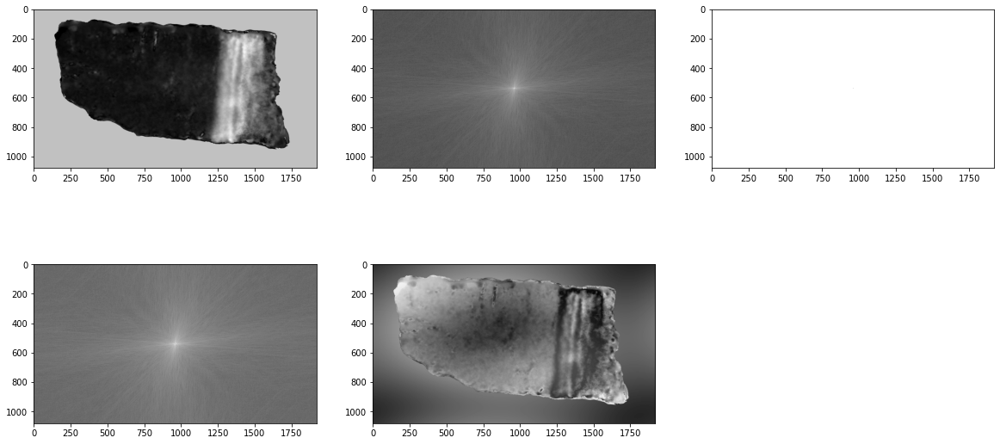

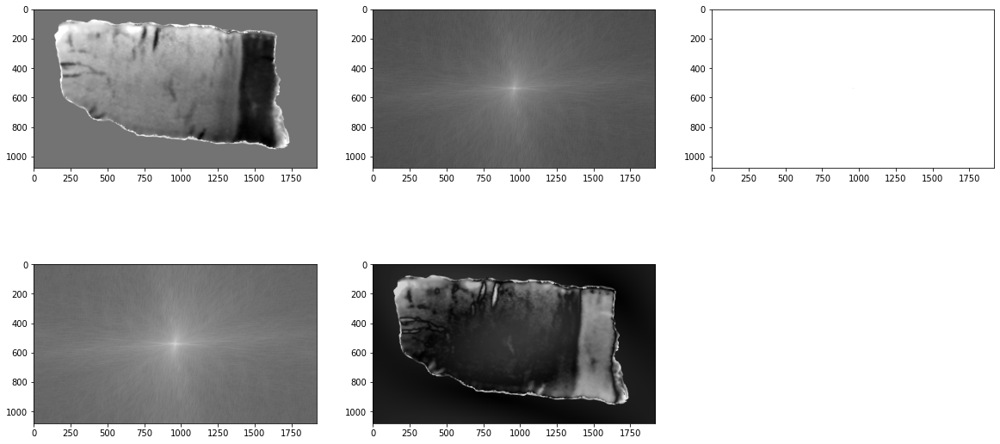

In [48]:
shift_=None
shift_col = 2
shift_row = 3
height_ = 4 # 300
width_ = 8 # 400
print(shift_)
# fourier_img = mask_fourier([h,s,v],
#                            [np.bitwise_not(
#                                np.bitwise_xor(
#                                    build_rectangle_mask(height_,width_,ch,crow-shift_row,ccol+shift_col),
#                                    build_rectangle_mask(height_,width_,ch,crow+shift_row,ccol-shift_col)))
#                             for ch in [h,s,v]])
fourier_img = mask_fourier([h,s,v],[build_rectangle_mask(2,2,ch,crow,ccol) for ch in [h,s,v]])

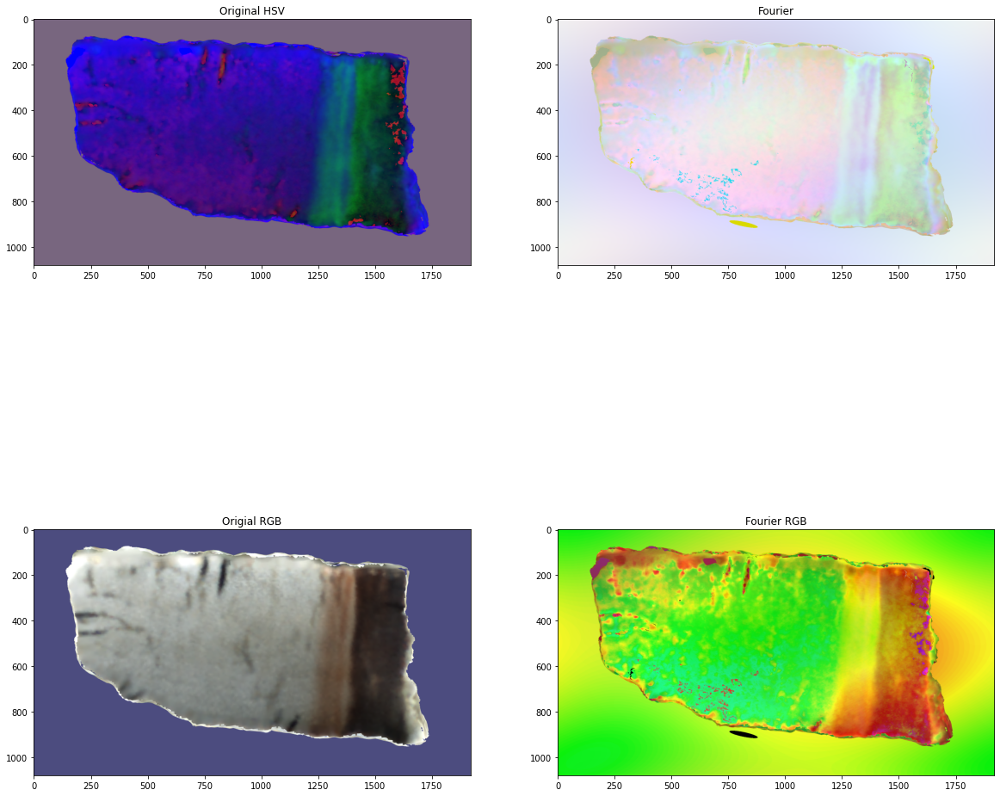

In [49]:
plot_images([img_hsv,(fourier_img*255).astype(np.uint8),
             img_rgb,(cv2.cvtColor((fourier_img*255).astype(np.uint8),cv2.COLOR_HSV2RGB))],
            ["Original HSV","Fourier","Origial RGB","Fourier RGB"],2,2)

In [50]:
r,g,b = cv2.split(img_rgb)
rows,cols = h.shape
crow,ccol = rows//2,cols//2

None


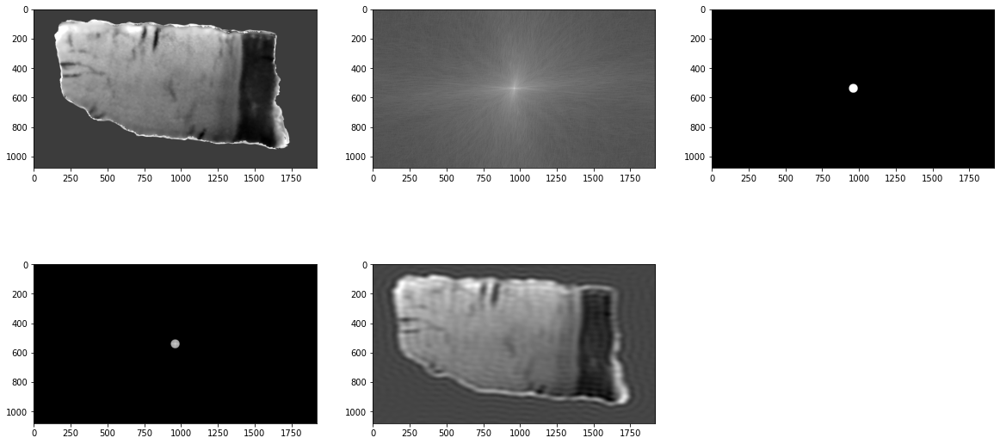

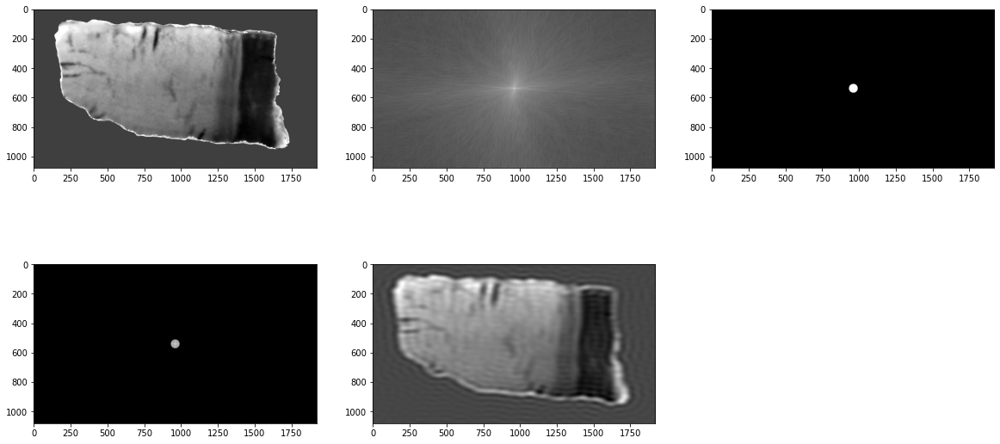

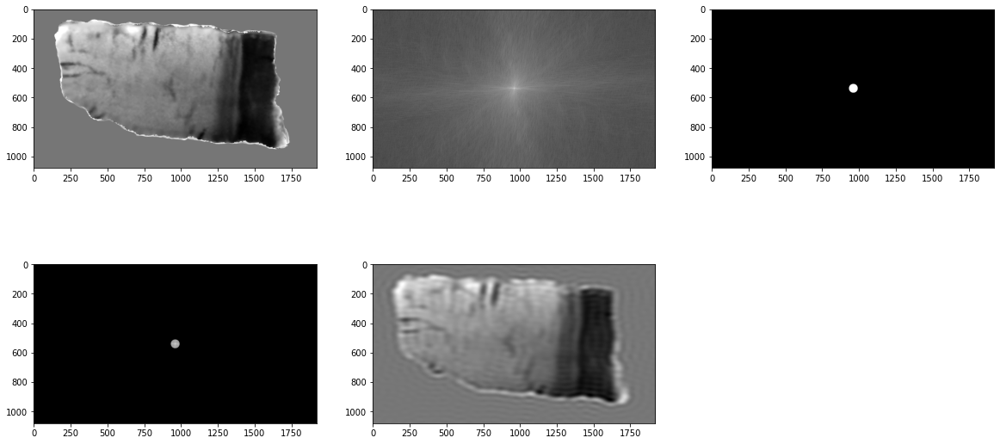

In [73]:
rows,cols = r.shape
crow,ccol = rows//2,cols//2
shift_col = 2
shift_row = 5
height_ = 3 # 300
width_ = 2 # 400
print(shift_)
# fourier_img = mask_fourier([r,g,b],
#                            [np.bitwise_not(
#                                np.bitwise_xor(
#                                    build_rectangle_mask(height_,width_,ch,crow-shift_row,ccol+shift_col),
#                                    build_rectangle_mask(height_,width_,ch,crow+shift_row,ccol-shift_col)))
#                             for ch in [r,g,b]])

fourier_img = mask_fourier([r,g,b],
                           [build_circle_mask(30,ch)
                            for ch in [r,g,b]])


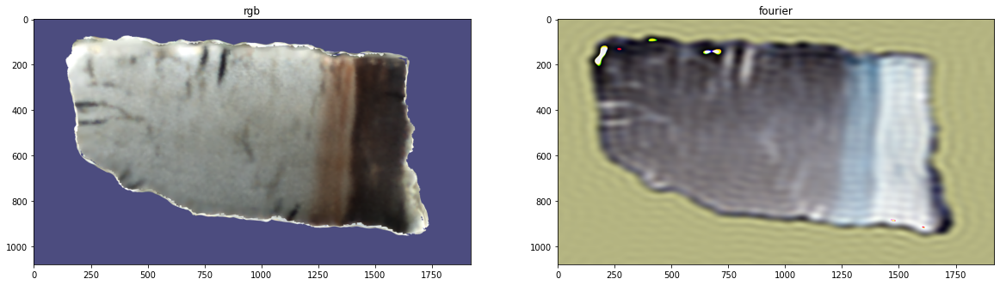

In [74]:
plot_images([img_rgb,(fourier_img*255).astype(np.uint8)],["rgb","fourier"],1,2)

None


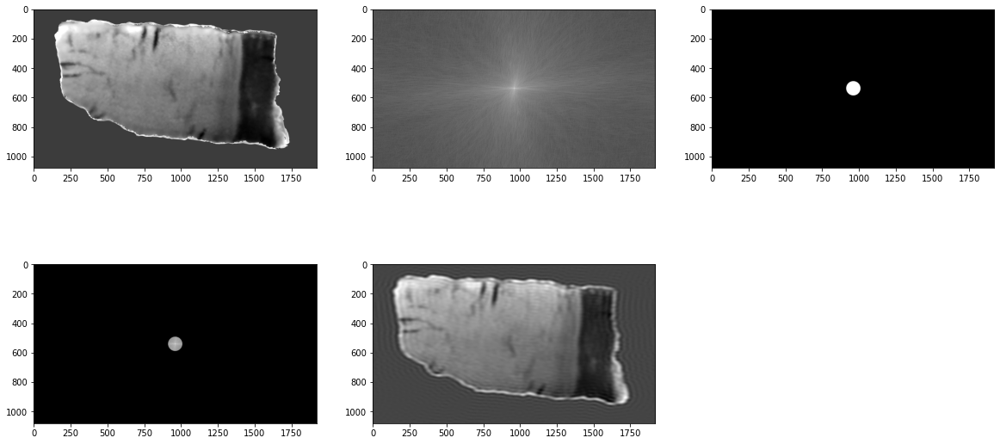

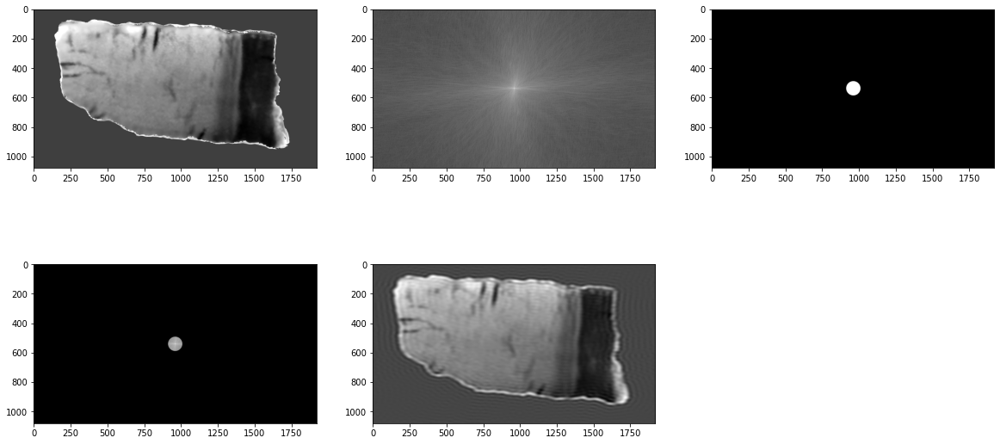

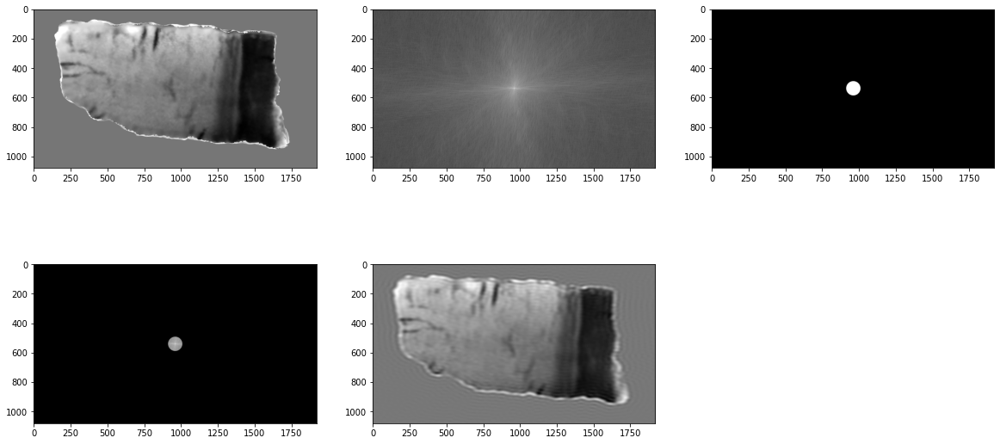

In [93]:
rows,cols = r.shape
crow,ccol = rows//2,cols//2
shift_col = 2
shift_row = 5
height_ = 3 # 300
width_ = 2 # 400

gauss_kernel = (71,71)
print(shift_)
# fourier_img = mask_fourier([r,g,b],
#                            [np.bitwise_not(
#                                np.bitwise_xor(
#                                    build_rectangle_mask(height_,width_,ch,crow-shift_row,ccol+shift_col),
#                                    build_rectangle_mask(height_,width_,ch,crow+shift_row,ccol-shift_col)))
#                             for ch in [r,g,b]])

fourier_img = mask_fourier([r,g,b],
                           [
                               cv2.GaussianBlur(build_circle_mask(50,ch),gauss_kernel,0)
                            for ch in [r,g,b]])


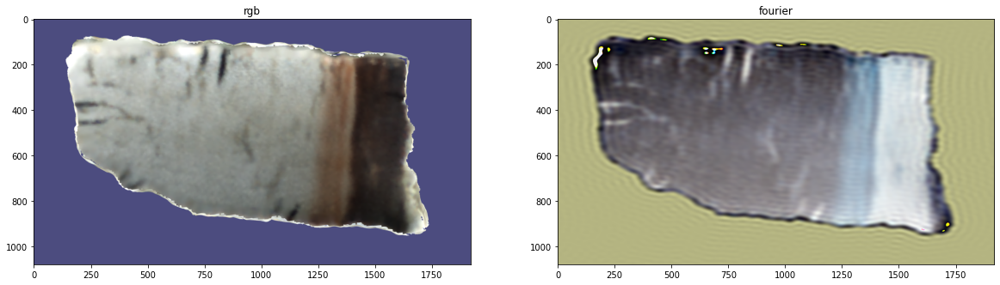

In [94]:
plot_images([img_rgb,(fourier_img*255).astype(np.uint8)],["rgb","fourier"],1,2)

In [95]:
img_rgb = (fourier_img*255).astype(np.uint8)

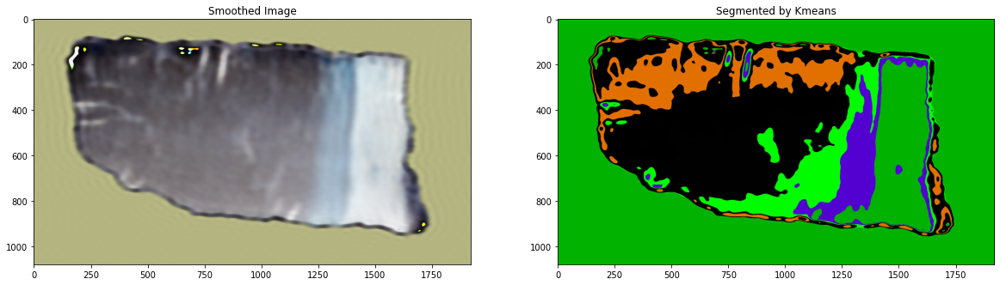

In [102]:
smoothed_img = cv2.bilateralFilter(img_rgb,25,100,100) #cv2.bilateralFilter(mean_smooth_rgb(img_rpf_000102_rgb,(100,100)),9,75,75)
kmeans_img = segment_kmeans(smoothed_img,8)
plot_images([smoothed_img,(kmeans_img*255).astype(np.uint8)],["Smoothed Image","Segmented by Kmeans"],1,2)

[[761.0, 1.6755161], [763.0, 1.6755161], [812.0, 1.6406095], [826.0, 1.6231562], [61.0, 1.6406095], [765.0, 1.6755161], [781.0, 1.6580628], [76.0, 1.6057029], [830.0, 1.6231562], [814.0, 1.6406095], [809.0, 1.6406095], [81.0, 1.5882496], [854.0, 1.6057029], [72.0, 1.6057029], [784.0, 1.6580628], [800.0, 1.6406095], [64.0, 1.6231562], [56.0, 1.6406095], [70.0, 1.6057029], [39.0, 1.6580628], [33.0, 1.6580628], [793.0, 1.6580628], [4.0, 1.6755161], [38.0, 1.6406095], [67.0, 1.6231562], [74.0, 1.6231562]]
[(0, 22), (1, 22), (2, 4), (2, 17), (2, 23), (3, 16), (3, 24), (3, 25), (4, 9), (4, 10), (4, 15), (5, 22), (6, 19), (6, 20), (7, 12), (8, 16), (8, 24), (8, 25), (9, 17), (9, 23), (10, 17), (10, 23), (12, 13), (12, 18), (14, 19), (14, 20), (15, 17), (15, 23), (19, 21), (20, 21)]


C:\Users\yaniv\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: divide by zero encountered in true_divide


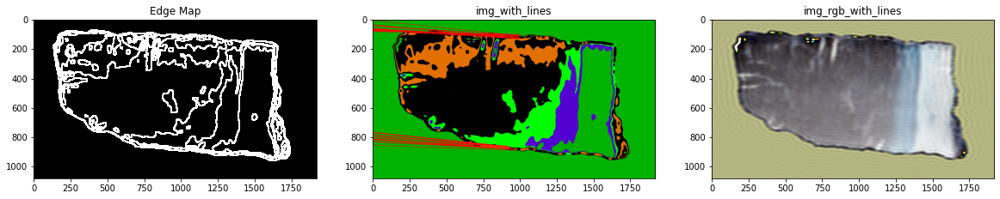

In [105]:
img_kmeans_gray = cv2.cvtColor((kmeans_img*255).astype(np.uint8),cv2.COLOR_RGB2GRAY)
img_edge_map = cv2.Canny(img_kmeans_gray,70,150)
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")

img_with_lines,out_lines = draw_hough_lines(
        (kmeans_img*255).astype(np.uint8),
        img_edge_map, #1/(1+np.abs(rpf_000102_gray_edge_map))
        1*np.pi/180,min_votes=150,
        lines_color=(255,0,0))
#plt.imshow(img_with_lines)
print(out_lines)
max_theta_thresh = 0.001
min_r_thresh = 50
parrallel_lines = find_parallel_lines(out_lines,
                                      max_theta_thresh=max_theta_thresh,
                                      min_r_thresh=min_r_thresh)
print(parrallel_lines)

img_rgb_with_lines = np.copy(img_rgb)
lines_color=(0,0,0)
for parralel_pair in parrallel_lines:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1])
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,2)
    #second_line = parralel_pair[1]
#plt.imshow(img_rgb_with_lines)
figsize=(20,20)
fig,axes = plt.subplots(1,3,figsize=figsize)
axes[0].imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
axes[0].set_title("Edge Map")
for ax,image,title in zip(axes.flatten()[1:],[img_with_lines,img_rgb_with_lines],["img_with_lines","img_rgb_with_lines"]):
    ax.imshow(image)
    ax.set_title(title)

# RPf_00020

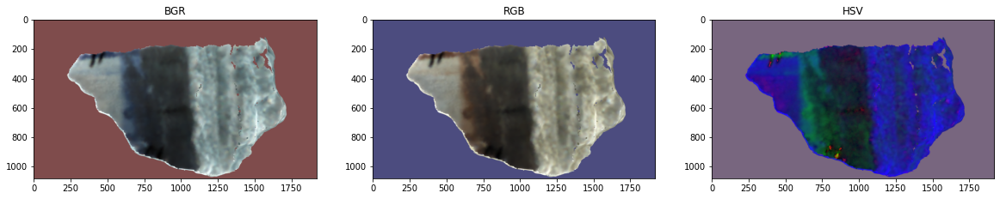

In [26]:
img_name = "RPf_00020.png"
img = cv2.imread(f"images/raw/border/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
plot_images([img,img_rgb,img_hsv],["BGR","RGB","HSV"],1,3)

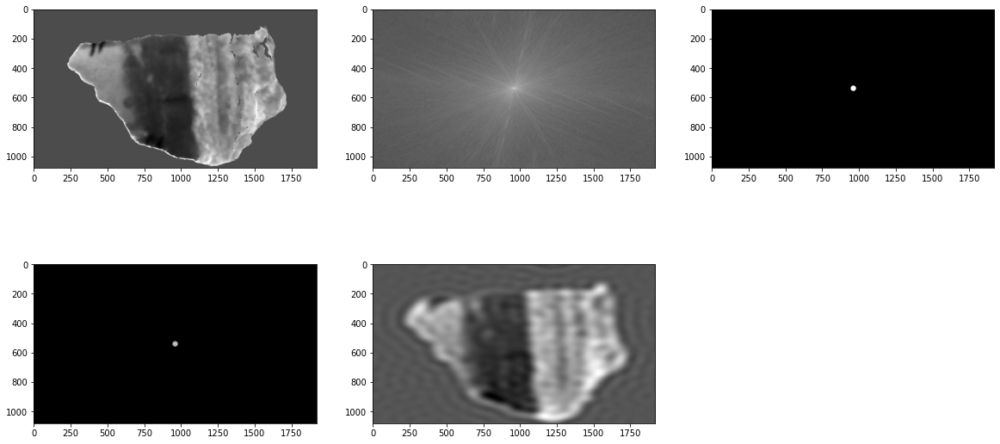

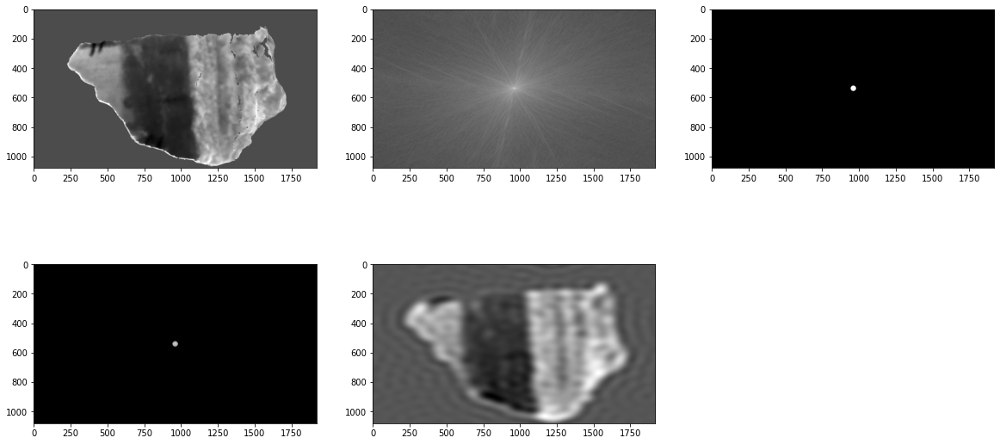

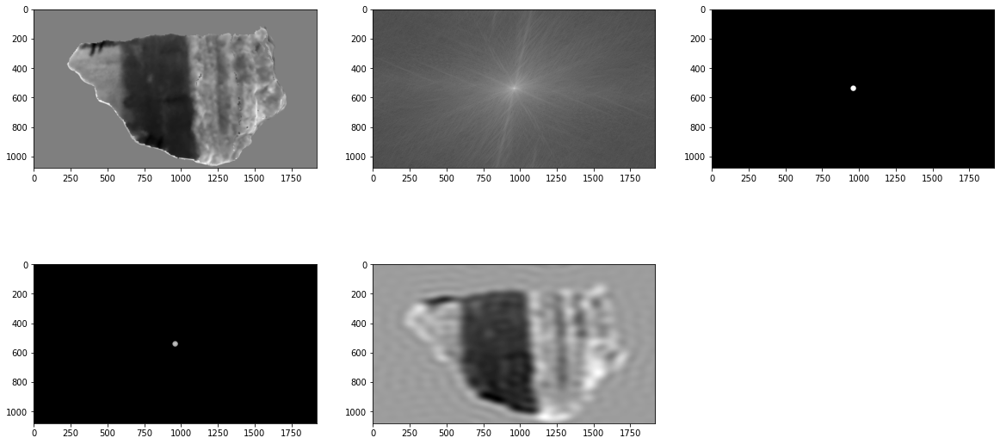

In [27]:
r,g,b = cv2.split(img_rgb)
rows,cols = r.shape
crow,ccol = rows//2,cols//2


rows,cols = r.shape
crow,ccol = rows//2,cols//2
shift_col = 2
shift_row = 5
height_ = 3 # 300
width_ = 2 # 400

gauss_kernel = (51,51)

fourier_img = mask_fourier([r,g,b],
                           [
                               cv2.GaussianBlur(build_circle_mask(20,ch),gauss_kernel,0)
                            for ch in [r,g,b]])


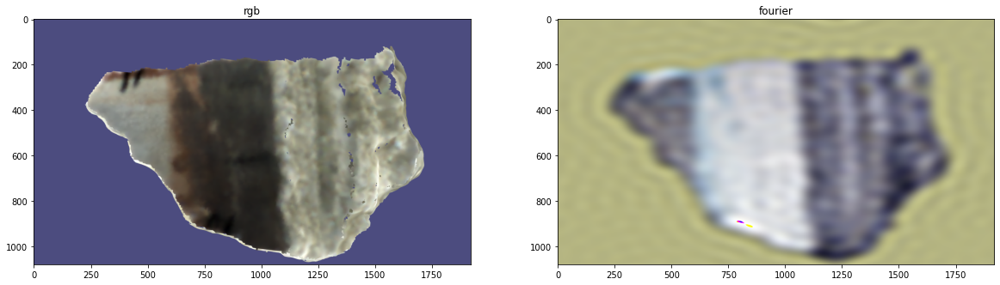

In [28]:
plot_images([img_rgb,(fourier_img*255).astype(np.uint8)],["rgb","fourier"],1,2)

In [29]:
img_rgb=(fourier_img*255).astype(np.uint8)

In [30]:
#smoothed_img = cv2.bilateralFilter(img_rgb,25,100,100) #cv2.bilateralFilter(mean_smooth_rgb(img_rpf_000102_rgb,(100,100)),9,75,75)

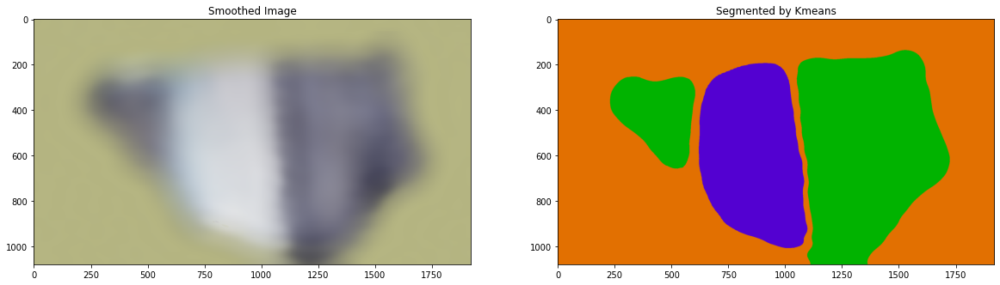

In [33]:
smoothed_img = cv2.bilateralFilter(img_rgb,200,300,300) #cv2.bilateralFilter(mean_smooth_rgb(img_rpf_000102_rgb,(100,100)),9,75,75)
kmeans_img = segment_kmeans(smoothed_img,3)
plot_images([smoothed_img,(kmeans_img*255).astype(np.uint8)],["Smoothed Image","Segmented by Kmeans"],1,2)

[[-967.0, 3.0019662], [-1039.0, 3.0892327], [631.0, 0.10471976], [-1017.0, 3.0368729], [1720.0, 0.6806784], [-975.0, 3.0194197], [195.0, 1.553343], [-946.0, 2.9670596], [637.0, 0.12217305], [172.0, 1.5707964], [240.0, 1.5184364], [218.0, 1.5358897], [-964.0, 2.984513], [-1373.0, 2.75762], [-957.0, 2.984513], [69.0, 2.4260077], [631.0, 0.017453292], [648.0, 0.05235988], [-1049.0, 3.106686], [616.0, 0.06981317], [197.0, 2.2165682], [1714.0, 0.7330383], [82.0, 2.4085543], [-942.0, 2.9670596], [-1029.0, 3.054326], [639.0, 0.034906585], [-1024.0, 3.054326], [1731.0, 0.6457718], [-1015.0, 3.0368729], [-1063.0, 3.1241393], [-1013.0, 3.0368729], [261.0, 1.5009831], [-1051.0, 3.106686], [1733.0, 0.62831855], [1725.0, 0.6632251], [326.0, 1.43117], [283.0, 1.4835298], [-1563.0, 2.984513], [624.0, 0.08726646], [-930.0, 2.9496064], [-1035.0, 3.0892327]]
[(12, 37), (14, 37)]


C:\Users\yaniv\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: divide by zero encountered in true_divide


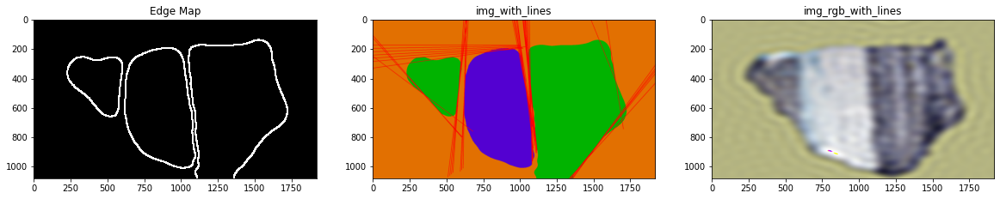

In [36]:
img_kmeans_gray = cv2.cvtColor((kmeans_img*255).astype(np.uint8),cv2.COLOR_RGB2GRAY)
img_edge_map = cv2.Canny(img_kmeans_gray,70,150)
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")

img_with_lines,out_lines = draw_hough_lines(
        (kmeans_img*255).astype(np.uint8),
        img_edge_map, #1/(1+np.abs(rpf_000102_gray_edge_map))
        1*np.pi/180,min_votes=75,
        lines_color=(255,0,0))
#plt.imshow(img_with_lines)
print(out_lines)
max_theta_thresh = 0.001
min_r_thresh = 30
parrallel_lines = find_parallel_lines(out_lines,
                                      max_theta_thresh=max_theta_thresh,
                                      min_r_thresh=min_r_thresh)
print(parrallel_lines)

img_rgb_with_lines = np.copy(img_rgb)
lines_color=(0,0,0)
for parralel_pair in parrallel_lines:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1])
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,2)
    #second_line = parralel_pair[1]
#plt.imshow(img_rgb_with_lines)
figsize=(20,20)
fig,axes = plt.subplots(1,3,figsize=figsize)
axes[0].imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
axes[0].set_title("Edge Map")
for ax,image,title in zip(axes.flatten()[1:],[img_with_lines,img_rgb_with_lines],["img_with_lines","img_rgb_with_lines"]):
    ax.imshow(image)
    ax.set_title(title)

# RPf_00022

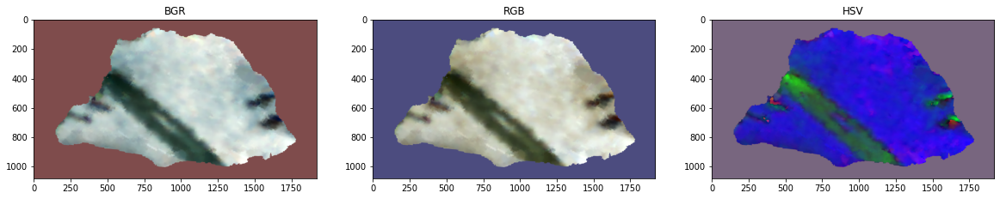

In [85]:
img_name = "RPf_00022.png"
img = cv2.imread(f"images/raw/border/done/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
plot_images([img,img_rgb,img_hsv],["BGR","RGB","HSV"],1,3)

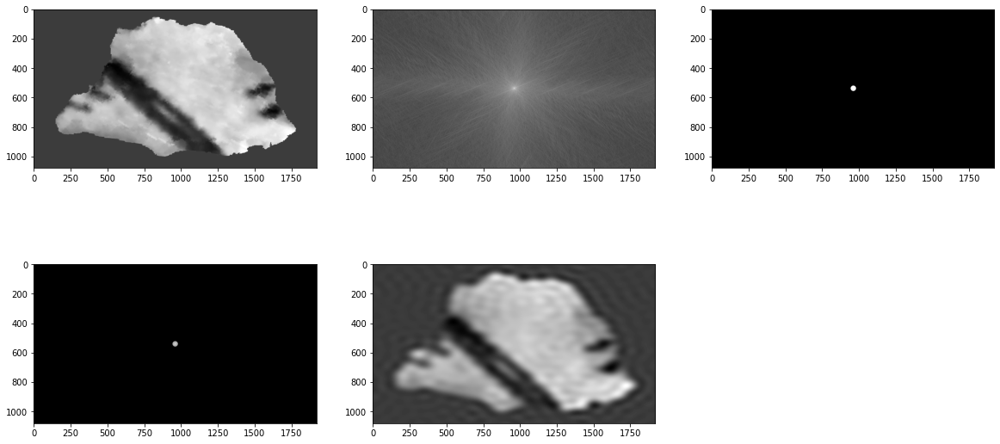

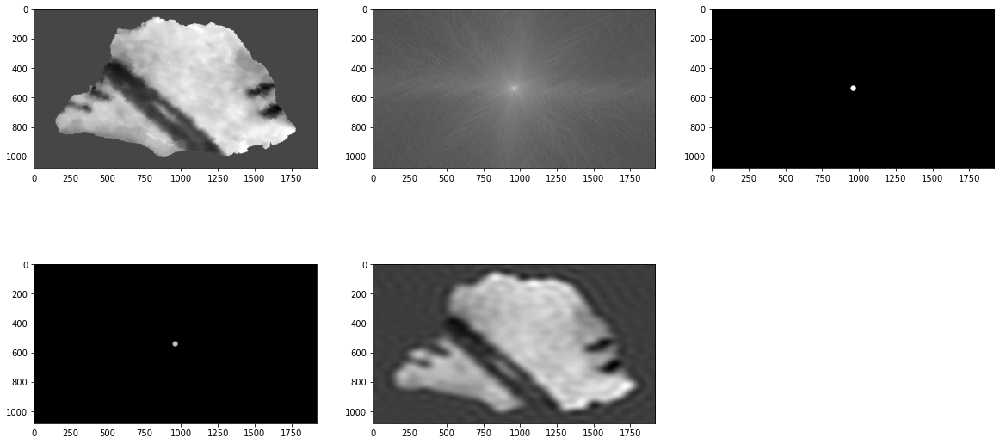

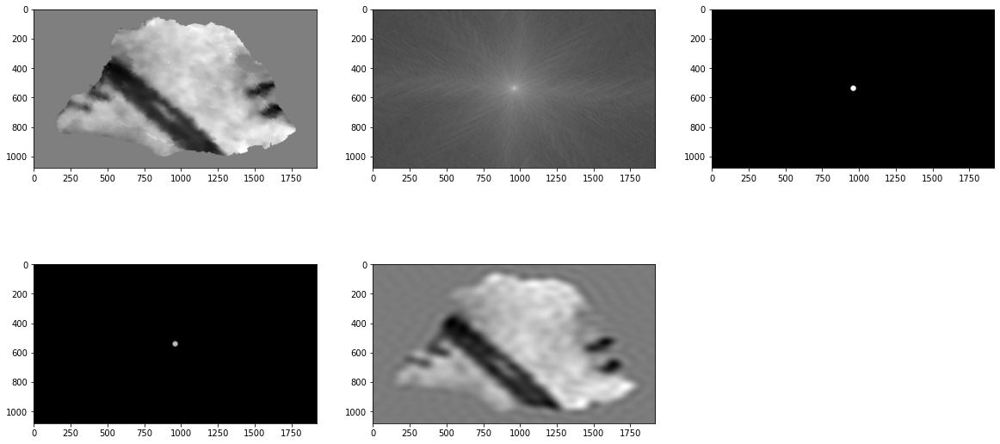

In [86]:
r,g,b = cv2.split(img_rgb)
rows,cols = r.shape
crow,ccol = rows//2,cols//2

gauss_kernel = (51,51)

fourier_img = mask_fourier([r,g,b],
                           [
                               cv2.GaussianBlur(build_circle_mask(20,ch),gauss_kernel,0)
                            for ch in [r,g,b]])


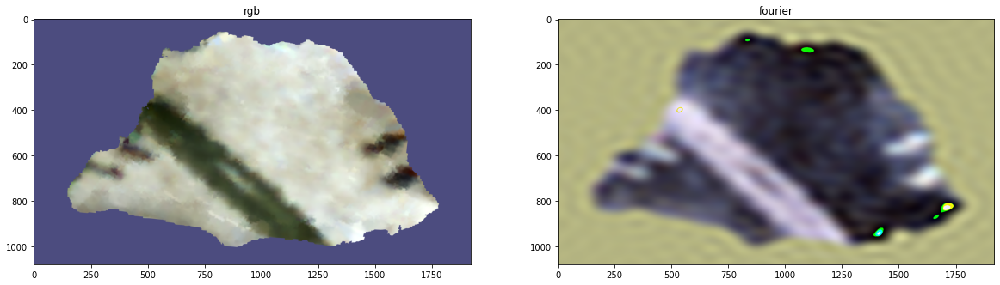

In [87]:
plot_images([img_rgb,(fourier_img*255).astype(np.uint8)],["rgb","fourier"],1,2)
img_rgb=(fourier_img*255).astype(np.uint8)

In [88]:
smoothed_img = cv2.bilateralFilter(img_rgb,200,300,300) #cv2.bilateralFilter(mean_smooth_rgb(img_rpf_000102_rgb,(100,100)),9,75,75)

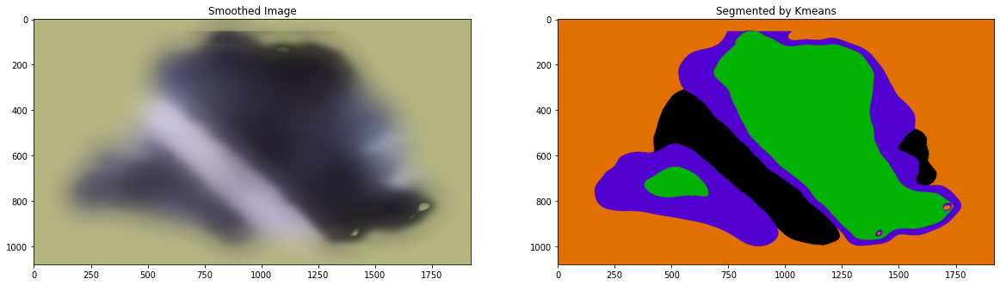

In [89]:
kmeans_img = segment_kmeans(smoothed_img,4)
plot_images([smoothed_img,(kmeans_img*255).astype(np.uint8)],["Smoothed Image","Segmented by Kmeans"],1,2)

[[53.0, 1.5707964], [771.0, 1.7453293], [44.0, 2.2863812], [-296.0, 2.3911011], [759.0, 1.7627826], [-217.0, 2.338741], [-160.0, 2.2863812], [-245.0, 2.3561945], [-143.0, 2.3038347], [-115.0, 2.2514746], [9.0, 2.1816616]]
[(2, 6)]


C:\Users\yaniv\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: divide by zero encountered in true_divide


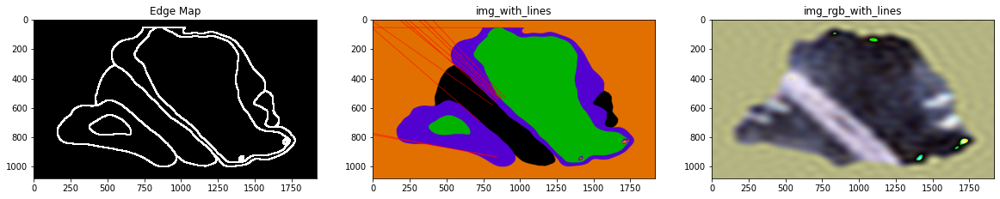

In [90]:
img_kmeans_gray = cv2.cvtColor((kmeans_img*255).astype(np.uint8),cv2.COLOR_RGB2GRAY)
img_edge_map = cv2.Canny(img_kmeans_gray,70,150)
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")

img_with_lines,out_lines = draw_hough_lines(
        (kmeans_img*255).astype(np.uint8),
        img_edge_map, #1/(1+np.abs(rpf_000102_gray_edge_map))
        1*np.pi/180,min_votes=120,
        lines_color=(255,0,0))
#plt.imshow(img_with_lines)
print(out_lines)
max_theta_thresh = 0.001
min_r_thresh = 30
parrallel_lines = find_parallel_lines(out_lines,
                                      max_theta_thresh=max_theta_thresh,
                                      min_r_thresh=min_r_thresh)
print(parrallel_lines)

img_rgb_with_lines = np.copy(img_rgb)
lines_color=(0,0,0)
for parralel_pair in parrallel_lines:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1])
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
    #second_line = parralel_pair[1]
#plt.imshow(img_rgb_with_lines)
figsize=(20,20)
fig,axes = plt.subplots(1,3,figsize=figsize)
axes[0].imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
axes[0].set_title("Edge Map")
for ax,image,title in zip(axes.flatten()[1:],[img_with_lines,img_rgb_with_lines],["img_with_lines","img_rgb_with_lines"]):
    ax.imshow(image)
    ax.set_title(title)

In [91]:
# img_rgb_with_lines = np.copy(img_rgb)
# lines_color=(0,0,0)
# for parralel_pair in parrallel_lines:
#     for ln_i in range(2):
#         line_ = out_lines[parralel_pair[ln_i]]
#         (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1])
#         cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)

h
h


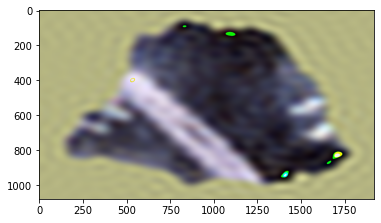

In [92]:
img_rgb_with_lines = np.copy(img_rgb)
plt.imshow(img_rgb_with_lines)

for parralel_pair in parrallel_lines[:1]:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1],point_distance=2000)
        print("h")
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
        
plt.imshow(img_rgb_with_lines)

In [93]:
fragments_names.append(img_name)
print(fragments_names)

['RPf_00004.png', 'RPf_00006.png', 'RPf_00008.png', 'RPf_00018.png', 'RPf_00022.png']


In [98]:
for pl in parrallel_lines:
    print(str(out_lines[pl[0]]) + " ----" + str(out_lines[pl[1]]))

lines_diff = abs(out_lines[parrallel_lines[0][0]][0] - out_lines[parrallel_lines[0][1]][0])
print(lines_diff)

[44.0, 2.2863812] ----[-160.0, 2.2863812]
204.0


In [99]:
borders_widths.append(lines_diff)
print(borders_widths)

[8.0, 8.0, 41.0, 235.0, 204.0]


[0 1 2 3]
0


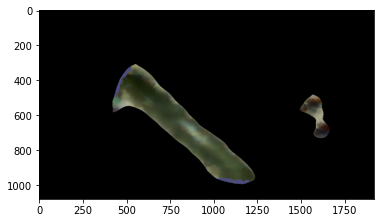

In [105]:
kmeans_labels = segment_kmeans_labels(smoothed_img,4)

label_ = kmeans_labels[219,1000]
print(np.unique(kmeans_labels))
print(label_)

label_ = 3

label_mask = np.where(kmeans_labels == label_, 1,0)

# r_,g_,b_ = cv2.split(img_rgb)
# r_ = np.where(r_==label_,r_,0)
# b_ = np.bitwise_and(b_,label_mask)
# g_ = np.bitwise_and(g_,label_mask)
# img_rgb_masked = cv2.merge((r_,g_,b_))

img = cv2.imread(f"images/raw/border/done/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)

new_img = np.copy(img_rgb)#.reshape(img_rgb.shape[0]*img_rgb.shape[1], img_rgb.shape[2])


for i in range(img_rgb.shape[0]):
    for j in range(img_rgb.shape[1]):
        if label_mask[i,j] != 1:
            new_img[i,j] = (0,0,0)
plt.imshow(new_img)

In [106]:
img_as_vec = new_img.reshape(img_rgb.shape[0]*img_rgb.shape[1], img_rgb.shape[2])
zeros = np.zeros((1,3))
#img_as_vec = img_as_vec[np.all()]
new_vector = []

for i_row in range(img_as_vec.shape[0]):
    if not np.all(img_as_vec[i_row] == zeros):
        new_vector.append(img_as_vec[i_row])

mean_ = np.mean(new_vector,axis=0)
averaged_colors.append(mean_)
print(len(new_vector))
print(mean_)


184773
[73.3656649  79.95145936 59.35242703]


In [103]:
#averaged_colors.pop()

array([164.07235138, 165.74337701, 151.46440321])

# RPf_00025

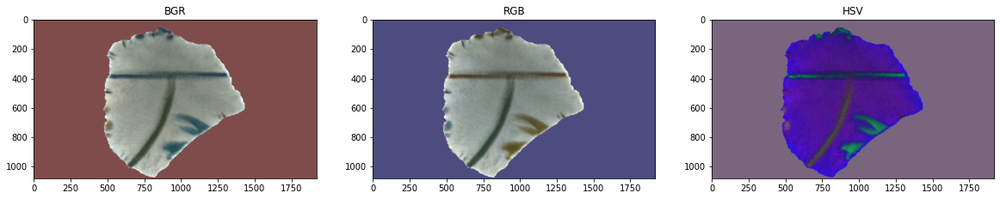

In [127]:
img_name = "RPf_00025.png"
img = cv2.imread(f"images/raw/border/done/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
plot_images([img,img_rgb,img_hsv],["BGR","RGB","HSV"],1,3)

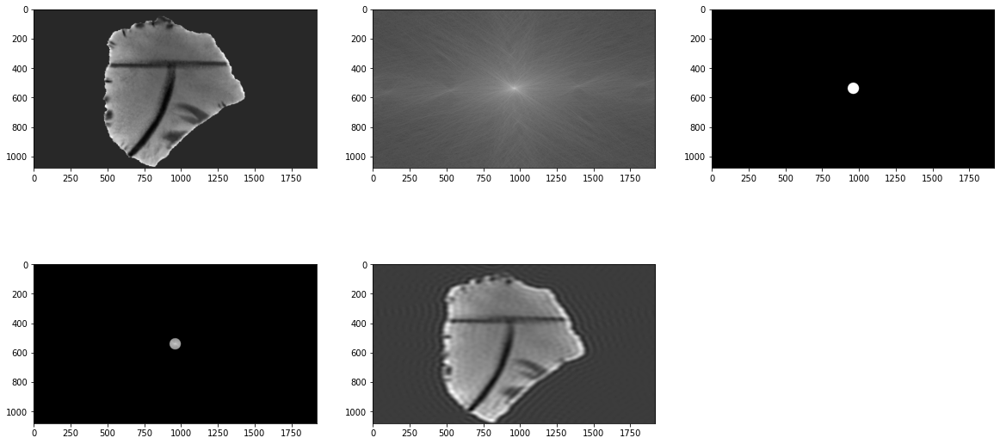

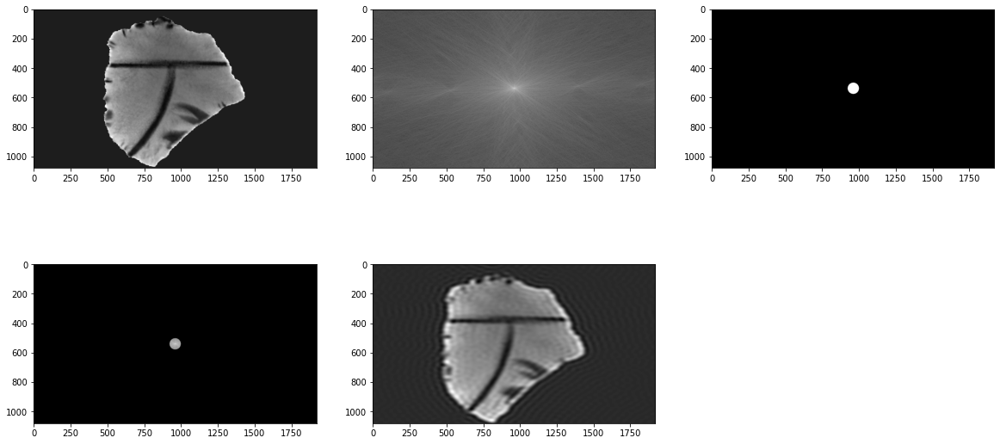

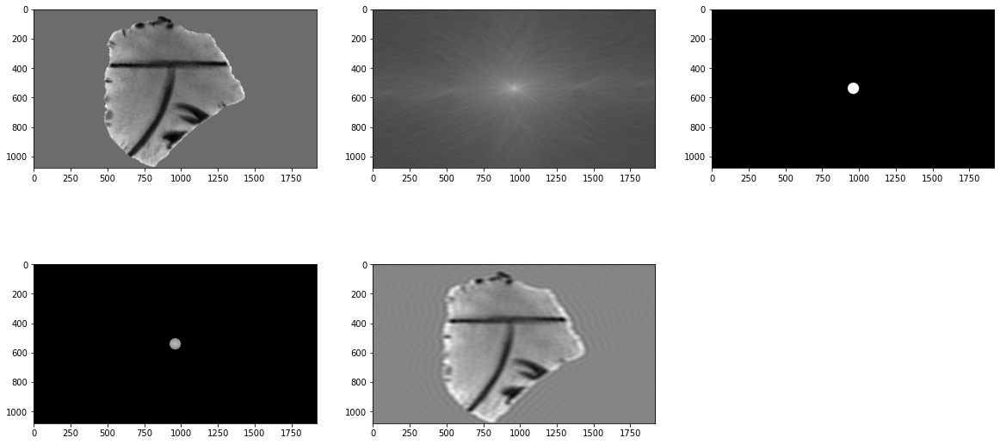

In [109]:
r,g,b = cv2.split(img_rgb)
rows,cols = r.shape
crow,ccol = rows//2,cols//2

gauss_kernel = (71,71)

fourier_img = mask_fourier([r,g,b],
                           [
                               cv2.GaussianBlur(build_circle_mask(40,ch),gauss_kernel,0)
                            for ch in [r,g,b]])


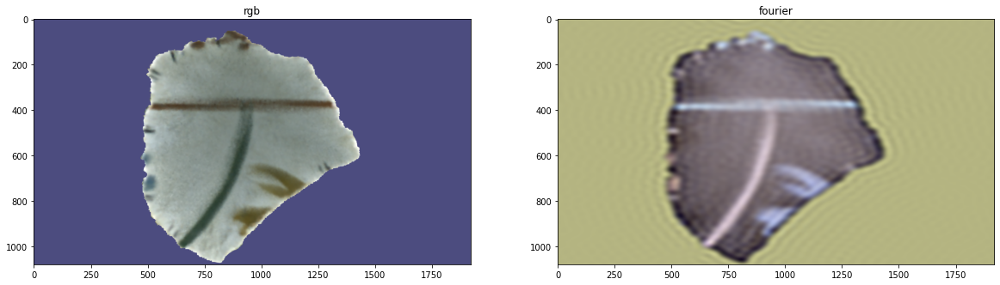

In [110]:
plot_images([img_rgb,(fourier_img*255).astype(np.uint8)],["rgb","fourier"],1,2)
img_rgb=(fourier_img*255).astype(np.uint8)

In [114]:
smoothed_img = cv2.bilateralFilter(img_rgb,9,75,75) #cv2.bilateralFilter(img_rgb,200,300,300) #cv2.bilateralFilter(mean_smooth_rgb(img_rpf_000102_rgb,(100,100)),9,75,75)

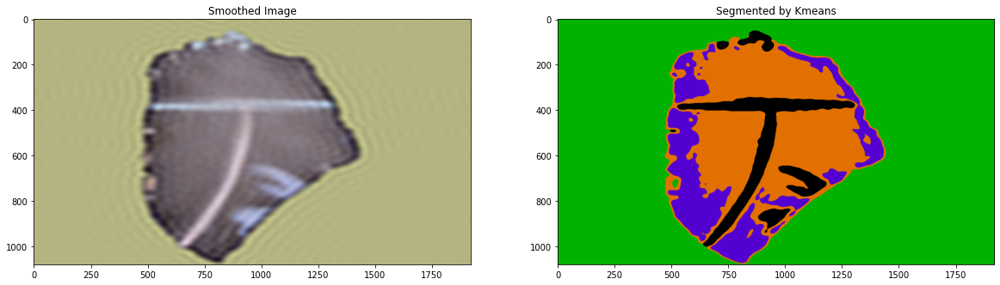

In [115]:
kmeans_img = segment_kmeans(smoothed_img,4)
plot_images([smoothed_img,(kmeans_img*255).astype(np.uint8)],["Smoothed Image","Segmented by Kmeans"],1,2)

[[314.0, 1.6057029], [405.0, 1.5707964], [1142.0, 0.5934119], [1100.0, 0.61086524], [390.0, 1.5882496], [1346.0, 0.7853982], [1345.0, 0.82030475]]
[(0, 4), (2, 3)]


C:\Users\yaniv\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: divide by zero encountered in true_divide


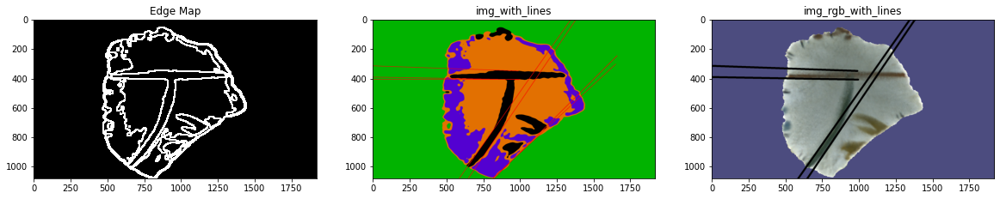

In [129]:
img_kmeans_gray = cv2.cvtColor((kmeans_img*255).astype(np.uint8),cv2.COLOR_RGB2GRAY)
img_edge_map = cv2.Canny(img_kmeans_gray,70,150)
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")

img_with_lines,out_lines = draw_hough_lines(
        (kmeans_img*255).astype(np.uint8),
        img_edge_map, #1/(1+np.abs(rpf_000102_gray_edge_map))
        1*np.pi/180,min_votes=120,
        lines_color=(255,0,0))
#plt.imshow(img_with_lines)
print(out_lines)
max_theta_thresh = 0.02
min_r_thresh = 30
parrallel_lines = find_parallel_lines(out_lines,
                                      max_theta_thresh=max_theta_thresh,
                                      min_r_thresh=min_r_thresh)
print(parrallel_lines)

img_rgb_with_lines = np.copy(img_rgb)
lines_color=(0,0,0)
for parralel_pair in parrallel_lines:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1])
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
    #second_line = parralel_pair[1]
#plt.imshow(img_rgb_with_lines)
figsize=(20,20)
fig,axes = plt.subplots(1,3,figsize=figsize)
axes[0].imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
axes[0].set_title("Edge Map")
for ax,image,title in zip(axes.flatten()[1:],[img_with_lines,img_rgb_with_lines],["img_with_lines","img_rgb_with_lines"]):
    ax.imshow(image)
    ax.set_title(title)

h


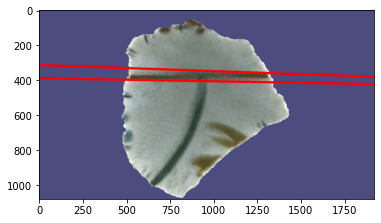

In [131]:
img_rgb_with_lines = np.copy(img_rgb)
lines_color=(255,0,0)
for parralel_pair in parrallel_lines[:1]:
    print("h")
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1],point_distance=2000)
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
plt.imshow(img_rgb_with_lines)

In [132]:
fragments_names.append(img_name)
print(fragments_names)

['RPf_00004.png', 'RPf_00006.png', 'RPf_00008.png', 'RPf_00018.png', 'RPf_00022.png', 'RPf_00025.png']


In [133]:
for pl in parrallel_lines:
    print(str(out_lines[pl[0]]) + " ----" + str(out_lines[pl[1]]))

lines_diff = abs(out_lines[parrallel_lines[0][0]][0] - out_lines[parrallel_lines[0][1]][0])
print(lines_diff)

[314.0, 1.6057029] ----[390.0, 1.5882496]
[1142.0, 0.5934119] ----[1100.0, 0.61086524]
76.0


In [134]:
borders_widths.append(lines_diff)
print(borders_widths)

[8.0, 8.0, 41.0, 235.0, 204.0, 76.0]


[0 1 2 3]
1


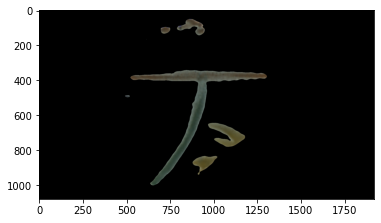

In [135]:
kmeans_labels = segment_kmeans_labels(smoothed_img,4)

label_ = kmeans_labels[219,1000]
print(np.unique(kmeans_labels))
print(label_)

label_ = 3

label_mask = np.where(kmeans_labels == label_, 1,0)

# r_,g_,b_ = cv2.split(img_rgb)
# r_ = np.where(r_==label_,r_,0)
# b_ = np.bitwise_and(b_,label_mask)
# g_ = np.bitwise_and(g_,label_mask)
# img_rgb_masked = cv2.merge((r_,g_,b_))

img = cv2.imread(f"images/raw/border/done/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)

new_img = np.copy(img_rgb)#.reshape(img_rgb.shape[0]*img_rgb.shape[1], img_rgb.shape[2])


for i in range(img_rgb.shape[0]):
    for j in range(img_rgb.shape[1]):
        if label_mask[i,j] != 1:
            new_img[i,j] = (0,0,0)
plt.imshow(new_img)

In [136]:
img_as_vec = new_img.reshape(img_rgb.shape[0]*img_rgb.shape[1], img_rgb.shape[2])
zeros = np.zeros((1,3))
#img_as_vec = img_as_vec[np.all()]
new_vector = []

for i_row in range(img_as_vec.shape[0]):
    if not np.all(img_as_vec[i_row] == zeros):
        new_vector.append(img_as_vec[i_row])

mean_ = np.mean(new_vector,axis=0)
averaged_colors.append(mean_)
print(len(new_vector))
print(mean_)


98627
[84.38423555 87.99385564 71.37764507]


In [140]:
len(fragments_names)

6

In [141]:
len(borders_widths)

6

In [142]:
r_val = []
g_val = []
b_val = []

for co in averaged_colors:
    r_val.append(co[0])
    g_val.append(co[1])
    b_val.append(co[2])

pd.DataFrame({
    "fragment": fragments_names,
    "width": borders_widths,
    "r":r_val,
    "g":g_val,
    "b":b_val
}).to_csv("1104.csv")

# RPf_00096

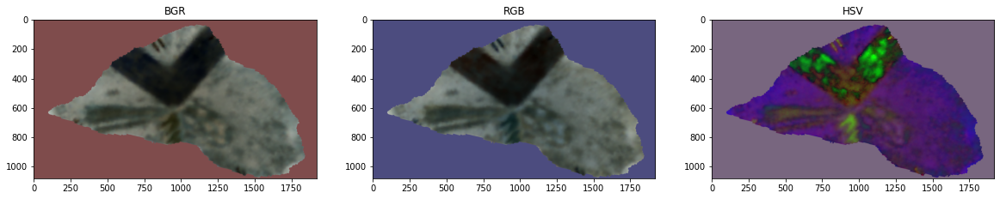

In [4]:
img_name = "RPf_00096.png"
img = cv2.imread(f"images/raw/border/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
plot_images([img,img_rgb,img_hsv],["BGR","RGB","HSV"],1,3)

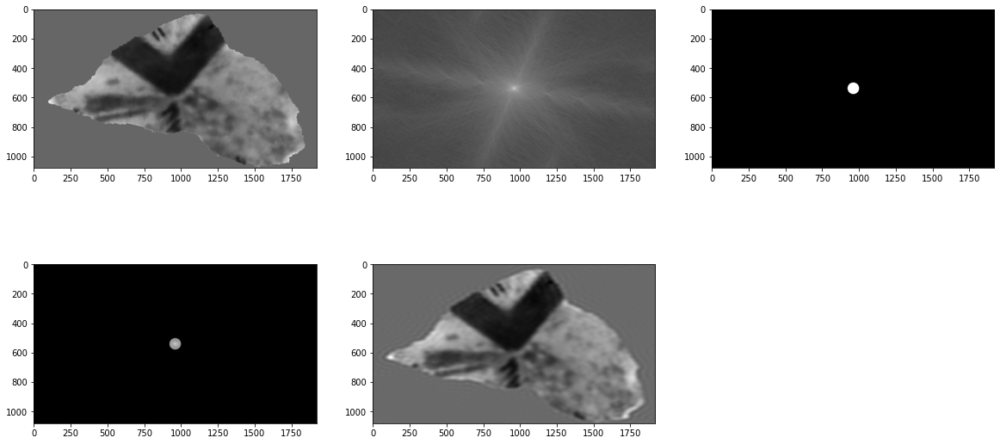

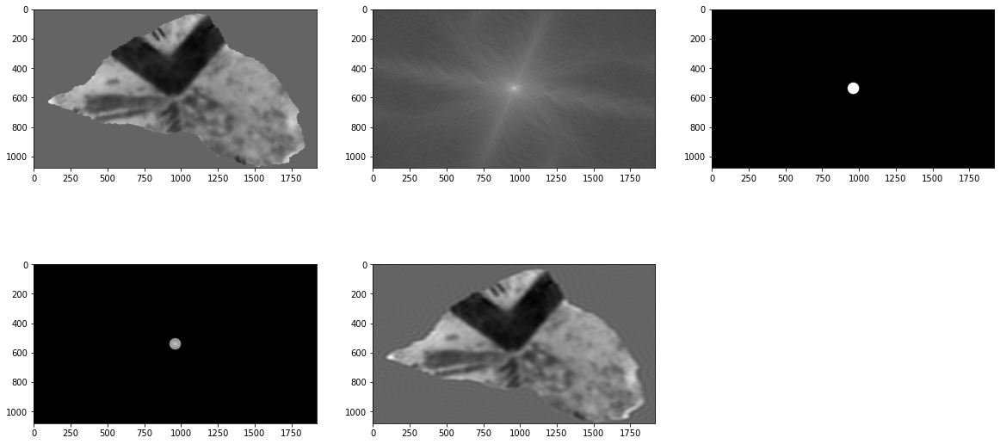

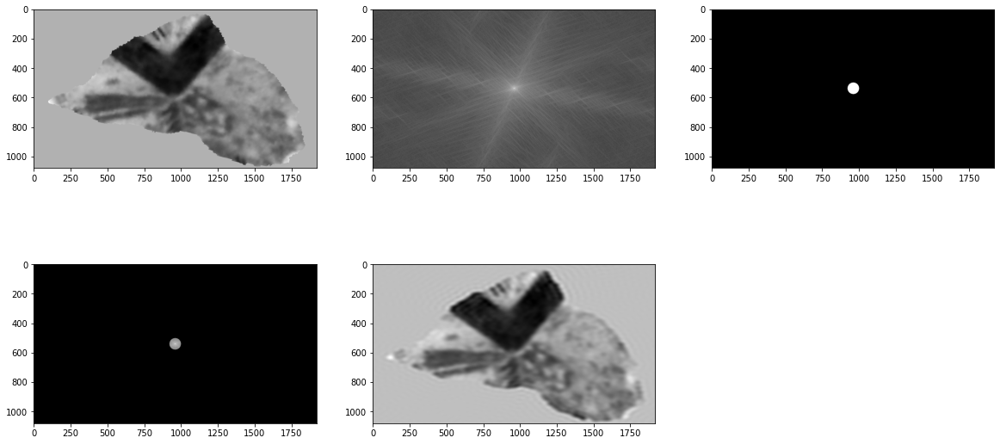

In [5]:
r,g,b = cv2.split(img_rgb)
rows,cols = r.shape
crow,ccol = rows//2,cols//2

gauss_kernel = (51,51)

fourier_img = mask_fourier([r,g,b],
                           [
                               cv2.GaussianBlur(build_circle_mask(40,ch),gauss_kernel,0)
                            for ch in [r,g,b]])


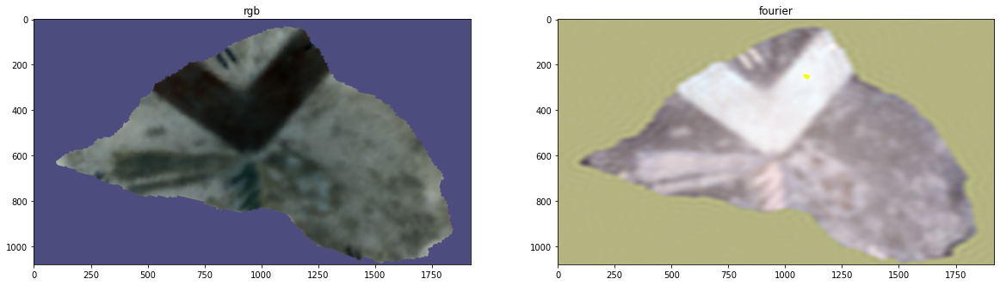

In [6]:
plot_images([img_rgb,(fourier_img*255).astype(np.uint8)],["rgb","fourier"],1,2)
img_rgb=(fourier_img*255).astype(np.uint8)

In [7]:
smoothed_img = cv2.bilateralFilter(img_rgb,200,300,300) #cv2.bilateralFilter(mean_smooth_rgb(img_rpf_000102_rgb,(100,100)),9,75,75)

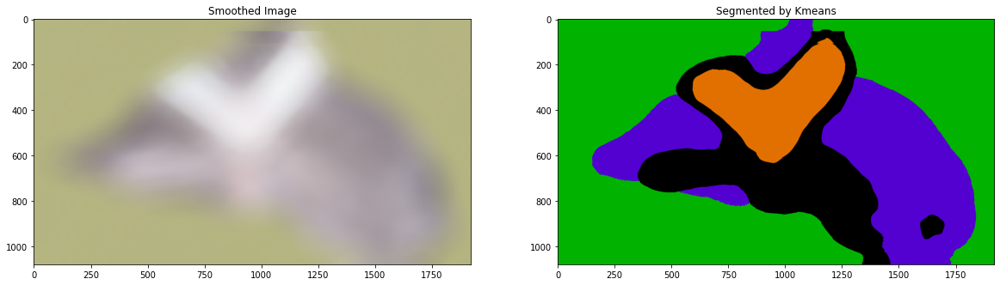

In [8]:
kmeans_img = segment_kmeans(smoothed_img,4)
plot_images([smoothed_img,(kmeans_img*255).astype(np.uint8)],["Smoothed Image","Segmented by Kmeans"],1,2)

[[53.0, 1.5707964], [900.0, 0.75049156], [-462.0, 2.3561945], [634.0, 1.7802358], [-24.0, 2.1816616], [-202.0, 2.3561945], [-36.0, 2.1991148], [909.0, 0.7330383], [-11.0, 2.1642082], [-187.0, 2.338741], [-1065.0, 2.5132742]]
[(2, 5)]


C:\Users\yaniv\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: divide by zero encountered in true_divide


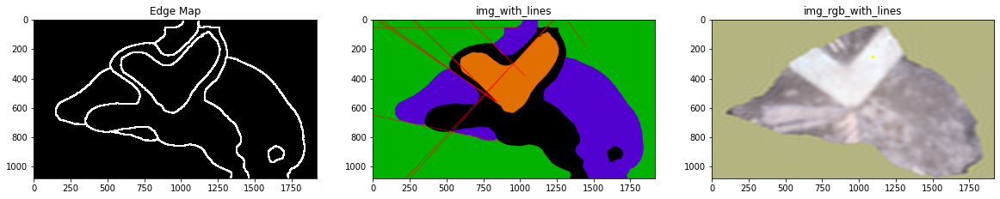

In [11]:
img_kmeans_gray = cv2.cvtColor((kmeans_img*255).astype(np.uint8),cv2.COLOR_RGB2GRAY)
img_edge_map = cv2.Canny(img_kmeans_gray,70,150)
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")

img_with_lines,out_lines = draw_hough_lines(
        (kmeans_img*255).astype(np.uint8),
        img_edge_map, #1/(1+np.abs(rpf_000102_gray_edge_map))
        1*np.pi/180,min_votes=100,
        lines_color=(255,0,0))
#plt.imshow(img_with_lines)
print(out_lines)
max_theta_thresh = 0.001
min_r_thresh = 30
parrallel_lines = find_parallel_lines(out_lines,
                                      max_theta_thresh=max_theta_thresh,
                                      min_r_thresh=min_r_thresh)
print(parrallel_lines)

img_rgb_with_lines = np.copy(img_rgb)
lines_color=(0,0,0)
for parralel_pair in parrallel_lines:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1])
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
    #second_line = parralel_pair[1]
#plt.imshow(img_rgb_with_lines)
figsize=(20,20)
fig,axes = plt.subplots(1,3,figsize=figsize)
axes[0].imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
axes[0].set_title("Edge Map")
for ax,image,title in zip(axes.flatten()[1:],[img_with_lines,img_rgb_with_lines],["img_with_lines","img_rgb_with_lines"]):
    ax.imshow(image)
    ax.set_title(title)

# RPf_00106

In [143]:
img_name = "RPf_00106.png"
img = cv2.imread(f"images/raw/border/done/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
plot_images([img,img_rgb,img_hsv],["BGR","RGB","HSV"],1,3)

error: OpenCV(4.1.2) C:\projects\opencv-python\opencv\modules\imgproc\src\color.cpp:182: error: (-215:Assertion failed) !_src.empty() in function 'cv::cvtColor'


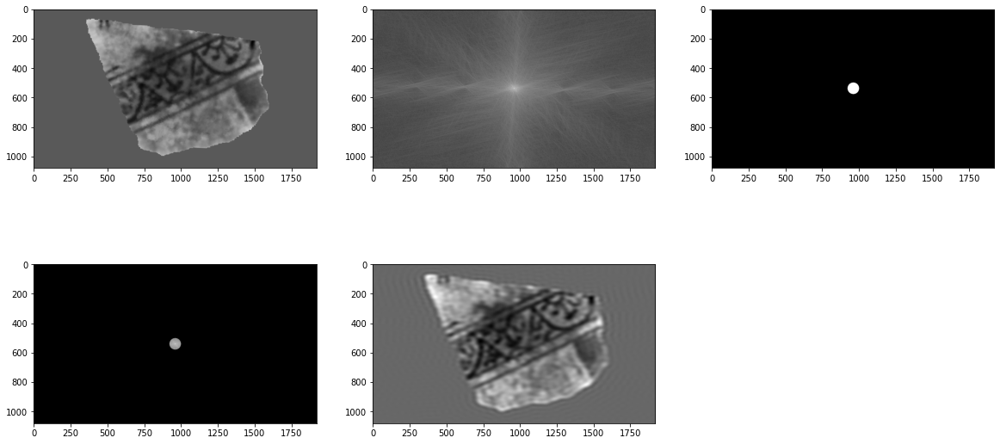

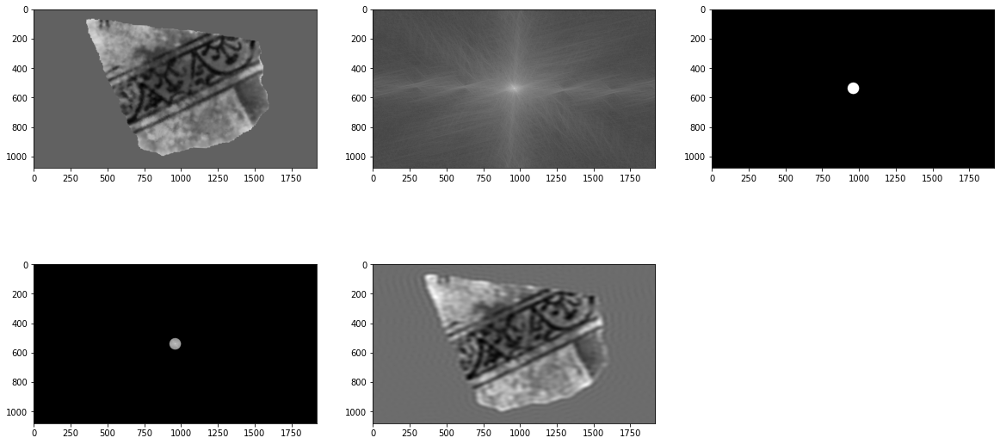

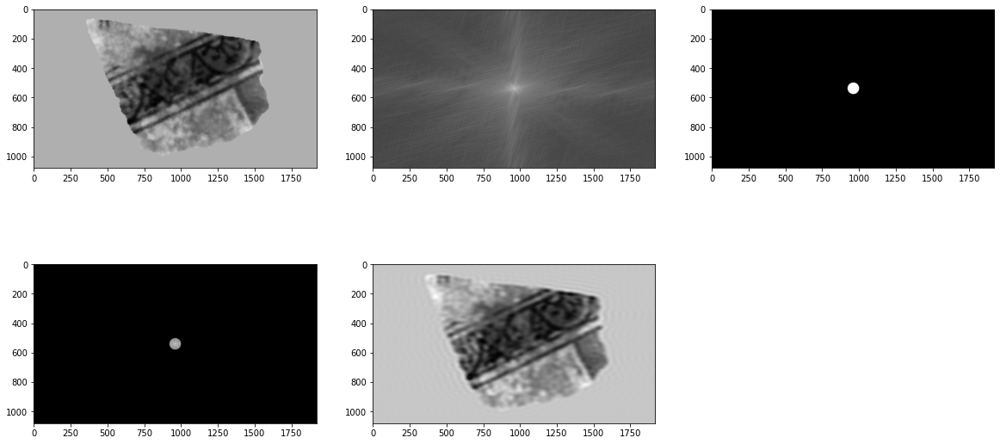

In [13]:
r,g,b = cv2.split(img_rgb)
rows,cols = r.shape
crow,ccol = rows//2,cols//2

gauss_kernel = (51,51)

fourier_img = mask_fourier([r,g,b],
                           [
                               cv2.GaussianBlur(build_circle_mask(40,ch),gauss_kernel,0)
                            for ch in [r,g,b]])


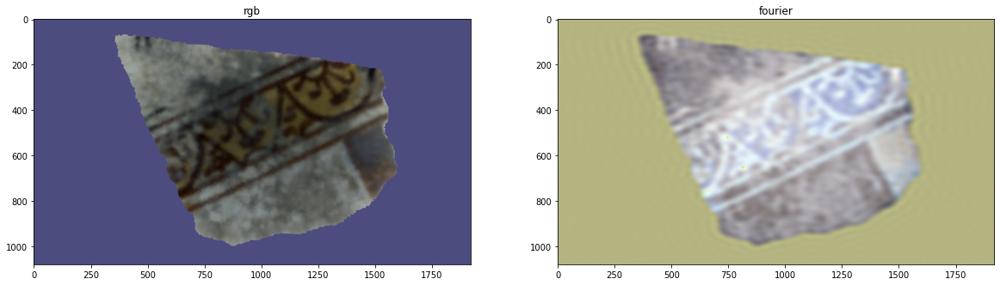

In [14]:
plot_images([img_rgb,(fourier_img*255).astype(np.uint8)],["rgb","fourier"],1,2)
img_rgb=(fourier_img*255).astype(np.uint8)

In [18]:
smoothed_img = cv2.bilateralFilter(img_rgb,9,75,75) #cv2.bilateralFilter(mean_smooth_rgb(img_rpf_000102_rgb,(100,100)),9,75,75)

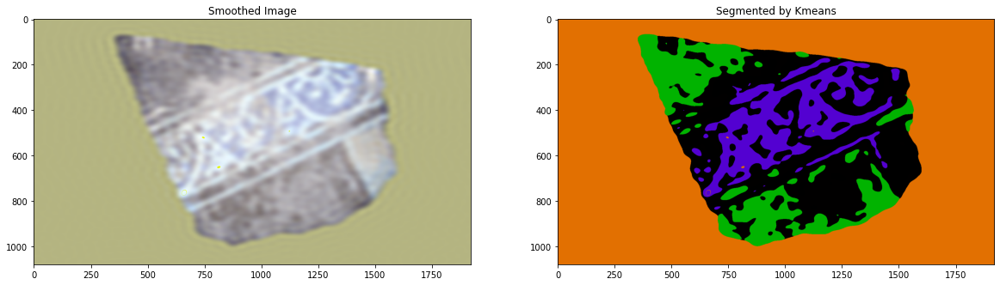

In [21]:
kmeans_img = segment_kmeans(smoothed_img,5)
plot_images([smoothed_img,(kmeans_img*255).astype(np.uint8)],["Smoothed Image","Segmented by Kmeans"],1,2)

[[-3.0, 1.7104226], [22.0, 1.6929693], [19.0, 1.6929693], [5.0, 1.7104226], [17.0, 1.6929693], [-280.0, 2.740167], [1065.0, 1.0995574], [37.0, 1.6755161], [-24.0, 1.727876], [1053.0, 1.134464], [57.0, 1.6580628], [993.0, 1.1170107], [636.0, 1.2042772], [684.0, 1.1170107]]
[(11, 13)]


C:\Users\yaniv\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: divide by zero encountered in true_divide


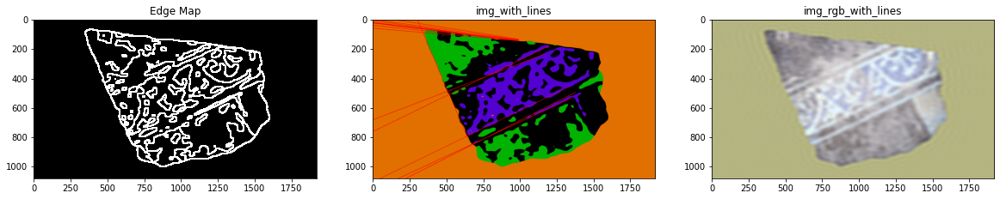

In [22]:
img_kmeans_gray = cv2.cvtColor((kmeans_img*255).astype(np.uint8),cv2.COLOR_RGB2GRAY)
img_edge_map = cv2.Canny(img_kmeans_gray,70,150)
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")

img_with_lines,out_lines = draw_hough_lines(
        (kmeans_img*255).astype(np.uint8),
        img_edge_map, #1/(1+np.abs(rpf_000102_gray_edge_map))
        1*np.pi/180,min_votes=100,
        lines_color=(255,0,0))
#plt.imshow(img_with_lines)
print(out_lines)
max_theta_thresh = 0.001
min_r_thresh = 30
parrallel_lines = find_parallel_lines(out_lines,
                                      max_theta_thresh=max_theta_thresh,
                                      min_r_thresh=min_r_thresh)
print(parrallel_lines)

img_rgb_with_lines = np.copy(img_rgb)
lines_color=(0,0,0)
for parralel_pair in parrallel_lines:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1])
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
    #second_line = parralel_pair[1]
#plt.imshow(img_rgb_with_lines)
figsize=(20,20)
fig,axes = plt.subplots(1,3,figsize=figsize)
axes[0].imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
axes[0].set_title("Edge Map")
for ax,image,title in zip(axes.flatten()[1:],[img_with_lines,img_rgb_with_lines],["img_with_lines","img_rgb_with_lines"]):
    ax.imshow(image)
    ax.set_title(title)

# RPf_00262_obj

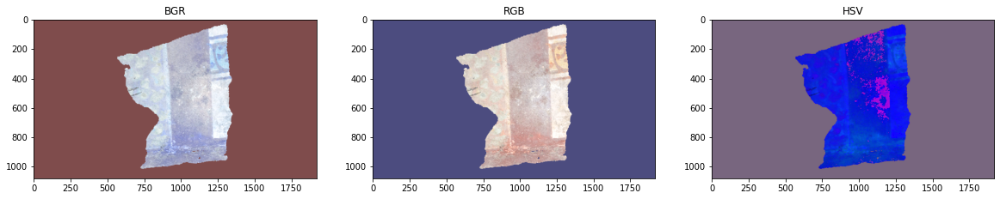

In [41]:
img_name = "RPf_00262_obj.png"
img = cv2.imread(f"images/raw/border/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
plot_images([img,img_rgb,img_hsv],["BGR","RGB","HSV"],1,3)

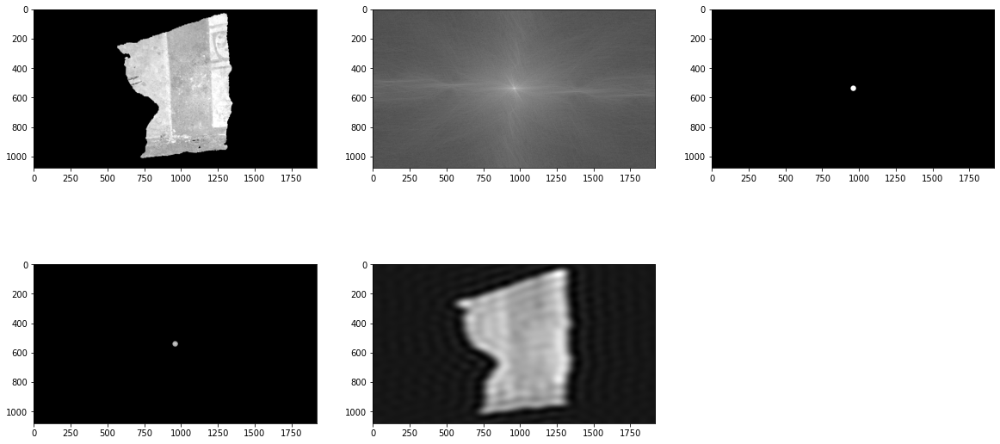

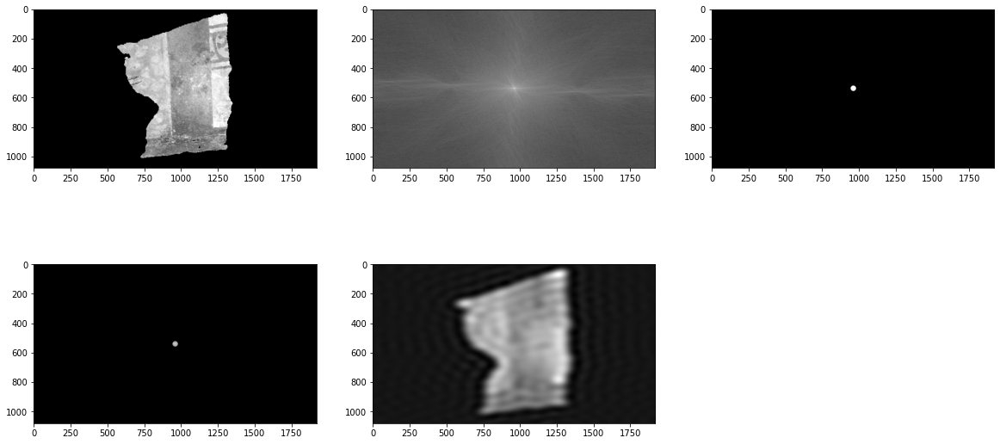

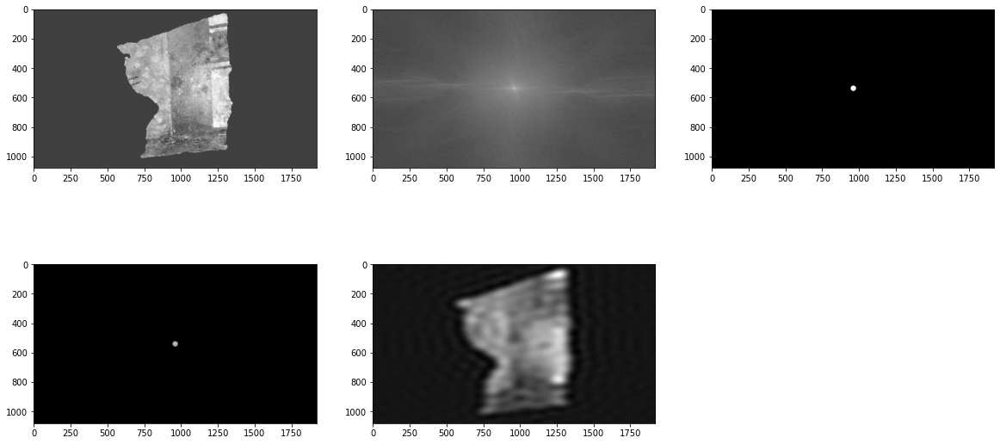

In [42]:
r,g,b = cv2.split(img_rgb)
rows,cols = r.shape
crow,ccol = rows//2,cols//2

gauss_kernel = (51,51)

fourier_img = mask_fourier([r,g,b],
                           [
                               cv2.GaussianBlur(build_circle_mask(20,ch),gauss_kernel,0)
                            for ch in [r,g,b]])


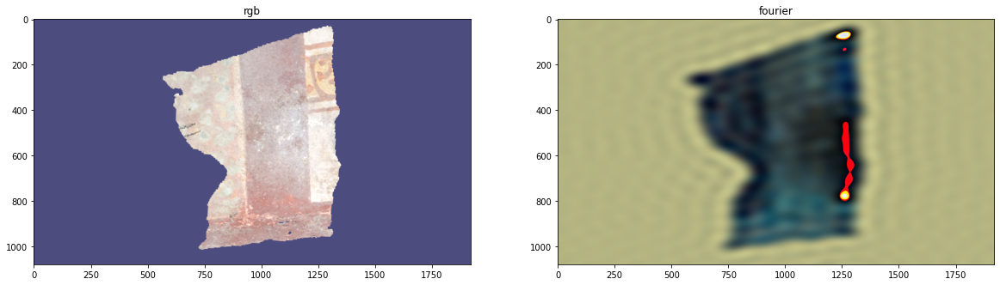

In [43]:
plot_images([img_rgb,(fourier_img*255).astype(np.uint8)],["rgb","fourier"],1,2)
img_rgb=(fourier_img*255).astype(np.uint8)

In [44]:
smoothed_img = cv2.bilateralFilter(img_rgb,9,75,75) #cv2.bilateralFilter(mean_smooth_rgb(img_rpf_000102_rgb,(100,100)),9,75,75)

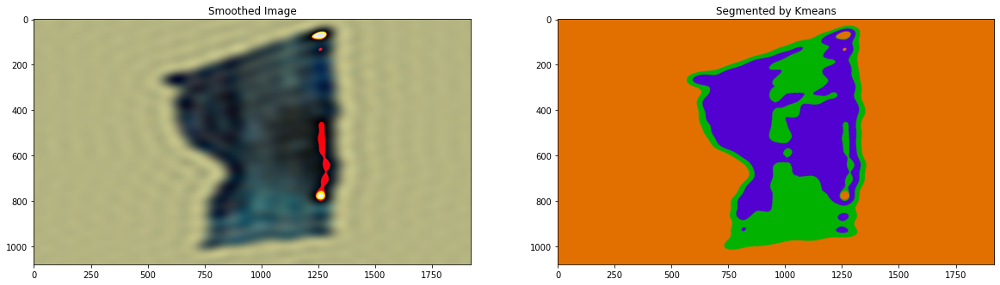

In [45]:
kmeans_img = segment_kmeans(smoothed_img,3)
plot_images([smoothed_img,(kmeans_img*255).astype(np.uint8)],["Smoothed Image","Segmented by Kmeans"],1,2)

[[436.0, 1.2391838], [444.0, 1.2566371], [424.0, 1.2566371]]
[]


C:\Users\yaniv\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: divide by zero encountered in true_divide


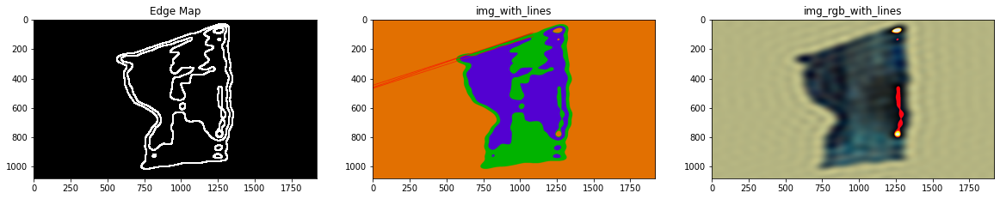

In [46]:
img_kmeans_gray = cv2.cvtColor((kmeans_img*255).astype(np.uint8),cv2.COLOR_RGB2GRAY)
img_edge_map = cv2.Canny(img_kmeans_gray,70,150)
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")

img_with_lines,out_lines = draw_hough_lines(
        (kmeans_img*255).astype(np.uint8),
        img_edge_map, #1/(1+np.abs(rpf_000102_gray_edge_map))
        1*np.pi/180,min_votes=100,
        lines_color=(255,0,0))
#plt.imshow(img_with_lines)
print(out_lines)
max_theta_thresh = 0.001
min_r_thresh = 30
parrallel_lines = find_parallel_lines(out_lines,
                                      max_theta_thresh=max_theta_thresh,
                                      min_r_thresh=min_r_thresh)
print(parrallel_lines)

img_rgb_with_lines = np.copy(img_rgb)
lines_color=(0,0,0)
for parralel_pair in parrallel_lines:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1])
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
    #second_line = parralel_pair[1]
#plt.imshow(img_rgb_with_lines)
figsize=(20,20)
fig,axes = plt.subplots(1,3,figsize=figsize)
axes[0].imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
axes[0].set_title("Edge Map")
for ax,image,title in zip(axes.flatten()[1:],[img_with_lines,img_rgb_with_lines],["img_with_lines","img_rgb_with_lines"]):
    ax.imshow(image)
    ax.set_title(title)

# RPf_00028

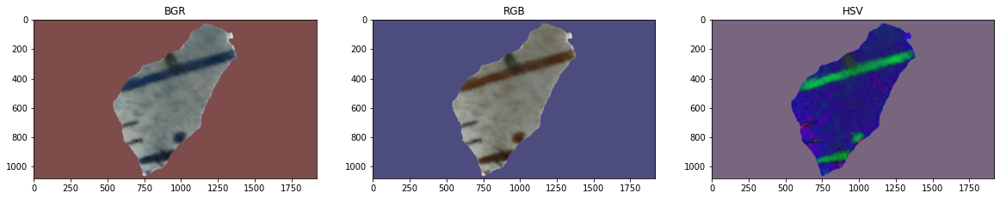

In [158]:
img_name = "RPf_00028.png"
img = cv2.imread(f"images/raw/border/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
plot_images([img,img_rgb,img_hsv],["BGR","RGB","HSV"],1,3)

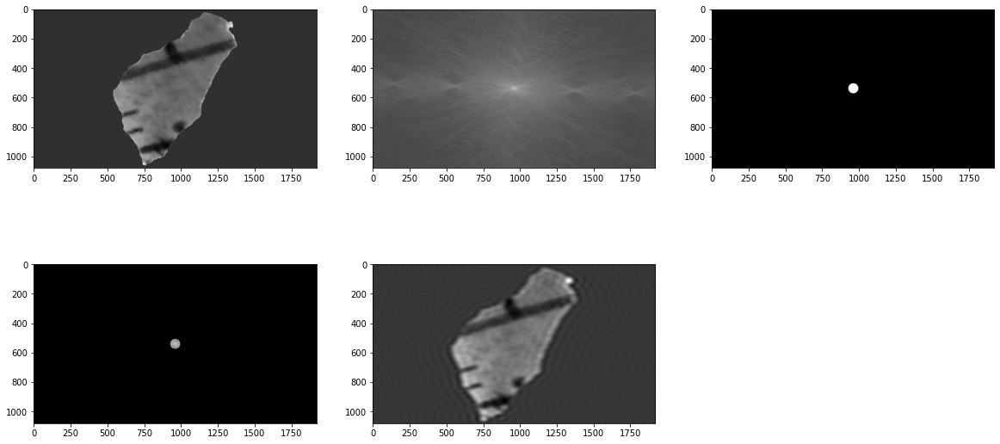

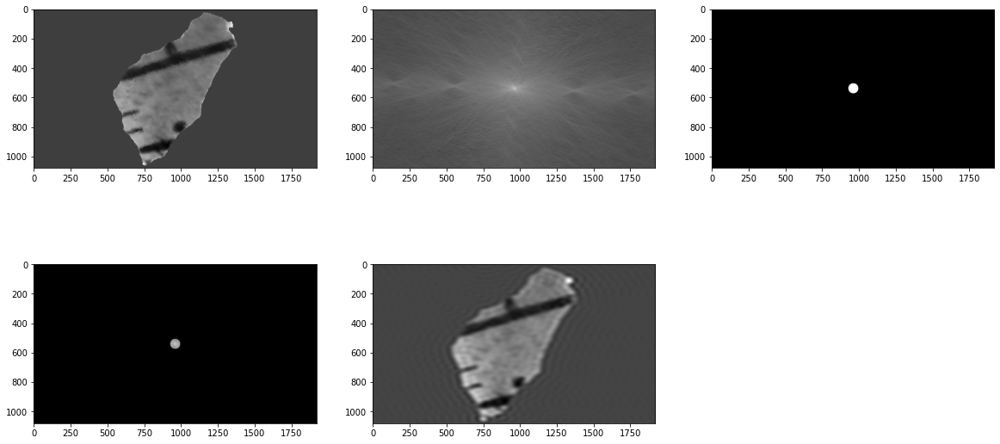

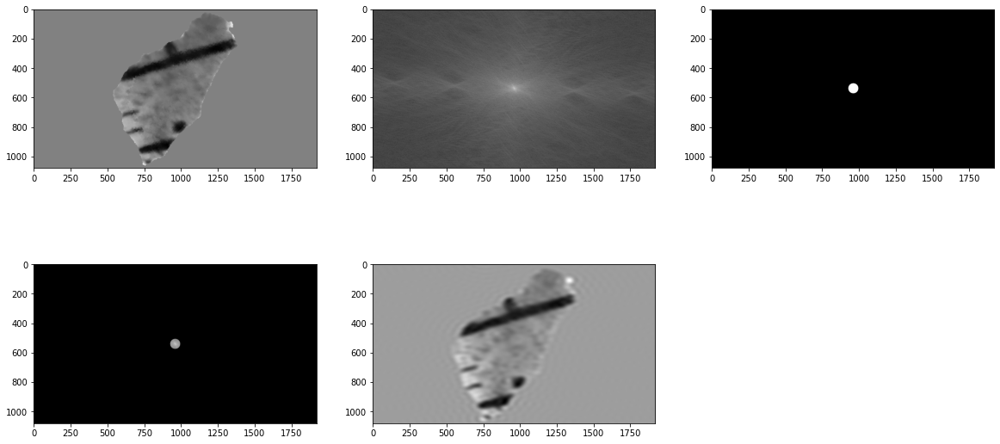

In [151]:
r,g,b = cv2.split(img_rgb)
rows,cols = r.shape
crow,ccol = rows//2,cols//2

gauss_kernel = (51,51)

fourier_img = mask_fourier([r,g,b],
                           [
                               cv2.GaussianBlur(build_circle_mask(35,ch),gauss_kernel,0)
                            for ch in [r,g,b]])


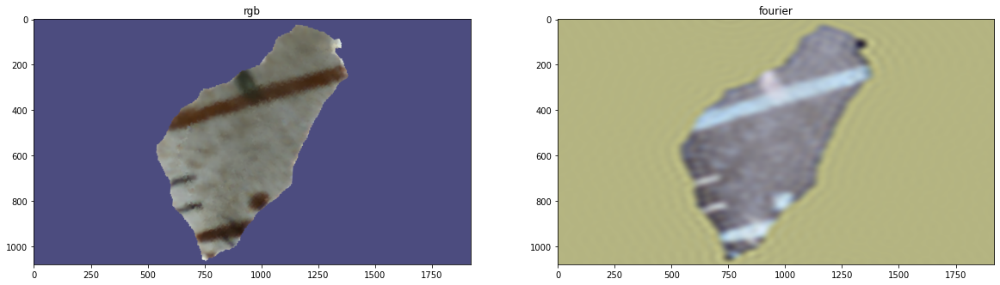

In [152]:
plot_images([img_rgb,(fourier_img*255).astype(np.uint8)],["rgb","fourier"],1,2)
img_rgb=(fourier_img*255).astype(np.uint8)

In [153]:
smoothed_img = cv2.bilateralFilter(img_rgb,9,15,15) #cv2.bilateralFilter(mean_smooth_rgb(img_rpf_000102_rgb,(100,100)),9,75,75)

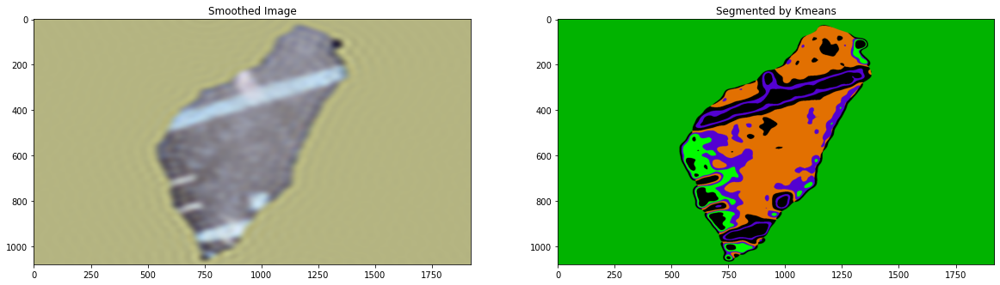

In [154]:
kmeans_img = segment_kmeans(smoothed_img,12)
plot_images([smoothed_img,(kmeans_img*255).astype(np.uint8)],["Smoothed Image","Segmented by Kmeans"],1,2)

[[644.0, 1.2740903], [1274.0, 0.57595867], [630.0, 1.2915436], [1308.0, 0.47123888], [1300.0, 0.5061455], [589.0, 1.2740903]]
[(0, 5)]


C:\Users\yaniv\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: divide by zero encountered in true_divide


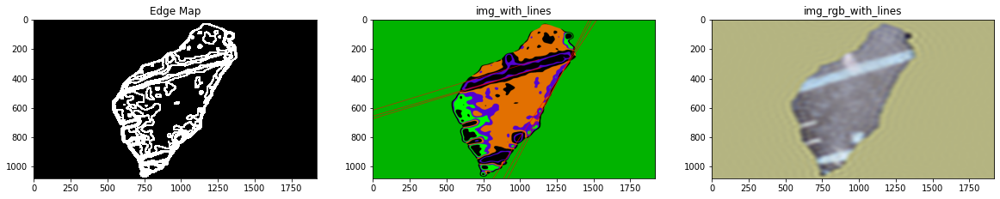

In [156]:
img_kmeans_gray = cv2.cvtColor((kmeans_img*255).astype(np.uint8),cv2.COLOR_RGB2GRAY)
img_edge_map = cv2.Canny(img_kmeans_gray,70,150)
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")

img_with_lines,out_lines = draw_hough_lines(
        (kmeans_img*255).astype(np.uint8),
        img_edge_map, #1/(1+np.abs(rpf_000102_gray_edge_map))
        1*np.pi/180,min_votes=120,
        lines_color=(255,0,0))
#plt.imshow(img_with_lines)
print(out_lines)
max_theta_thresh = 0.001
min_r_thresh = 30
parrallel_lines = find_parallel_lines(out_lines,
                                      max_theta_thresh=max_theta_thresh,
                                      min_r_thresh=min_r_thresh)
print(parrallel_lines)

img_rgb_with_lines = np.copy(img_rgb)
lines_color=(255,0,0)
for parralel_pair in parrallel_lines:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1])
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
    #second_line = parralel_pair[1]
#plt.imshow(img_rgb_with_lines)
figsize=(20,20)
fig,axes = plt.subplots(1,3,figsize=figsize)
axes[0].imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
axes[0].set_title("Edge Map")
for ax,image,title in zip(axes.flatten()[1:],[img_with_lines,img_rgb_with_lines],["img_with_lines","img_rgb_with_lines"]):
    ax.imshow(image)
    ax.set_title(title)

h


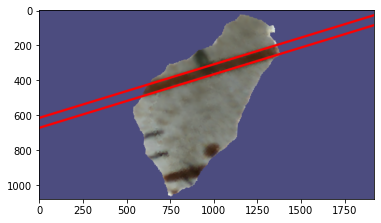

In [159]:
img_rgb_with_lines = np.copy(img_rgb)
lines_color=(255,0,0)
for parralel_pair in parrallel_lines[:1]:
    print("h")
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1],point_distance=2000)
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
plt.imshow(img_rgb_with_lines)

In [160]:
fragments_names.append(img_name)
print(fragments_names)

['RPf_00004.png', 'RPf_00006.png', 'RPf_00008.png', 'RPf_00018.png', 'RPf_00022.png', 'RPf_00025.png', 'RPf_00028.png']


In [161]:
for pl in parrallel_lines:
    print(str(out_lines[pl[0]]) + " ----" + str(out_lines[pl[1]]))

lines_diff = abs(out_lines[parrallel_lines[0][0]][0] - out_lines[parrallel_lines[0][1]][0])
print(lines_diff)

borders_widths.append(lines_diff)
print(borders_widths)

[644.0, 1.2740903] ----[589.0, 1.2740903]
55.0
[8.0, 8.0, 41.0, 235.0, 204.0, 76.0, 55.0]


In [ ]:
kmeans_labels = segment_kmeans_labels(smoothed_img,12)

[ 0  1  2  3  4  5  6  7  8  9 10 11]
1


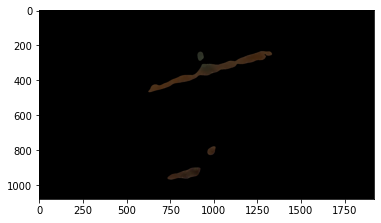

In [175]:
label_ = kmeans_labels[219,1000]
print(np.unique(kmeans_labels))
print(label_)

label_ = 11

label_mask = np.where(kmeans_labels == label_, 1,0)

# r_,g_,b_ = cv2.split(img_rgb)
# r_ = np.where(r_==label_,r_,0)
# b_ = np.bitwise_and(b_,label_mask)
# g_ = np.bitwise_and(g_,label_mask)
# img_rgb_masked = cv2.merge((r_,g_,b_))


img = cv2.imread(f"images/raw/border/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
new_img = np.copy(img_rgb)#.reshape(img_rgb.shape[0]*img_rgb.shape[1], img_rgb.shape[2])


for i in range(img_rgb.shape[0]):
    for j in range(img_rgb.shape[1]):
        if label_mask[i,j] != 1:
            new_img[i,j] = (0,0,0)
plt.imshow(new_img)

In [176]:
img_as_vec = new_img.reshape(img_rgb.shape[0]*img_rgb.shape[1], img_rgb.shape[2])
zeros = np.zeros((1,3))
#img_as_vec = img_as_vec[np.all()]
new_vector = []

for i_row in range(img_as_vec.shape[0]):
    if not np.all(img_as_vec[i_row] == zeros):
        new_vector.append(img_as_vec[i_row])

mean_ = np.mean(new_vector,axis=0)

In [177]:
averaged_colors.append(mean_)
print(len(new_vector))
print(mean_)

36780
[64.96979337 44.73969549 27.79698206]


In [178]:
r_val = []
g_val = []
b_val = []

for co in averaged_colors:
    r_val.append(co[0])
    g_val.append(co[1])
    b_val.append(co[2])

pd.DataFrame({
    "fragment": fragments_names,
    "width": borders_widths,
    "r":r_val,
    "g":g_val,
    "b":b_val
}).to_csv("1146.csv")

# RPf_00047

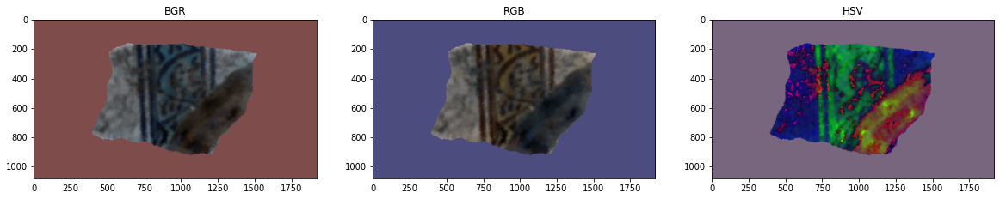

In [40]:
img_name = "RPf_00047.png"
img = cv2.imread(f"images/raw/border/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
plot_images([img,img_rgb,img_hsv],["BGR","RGB","HSV"],1,3)

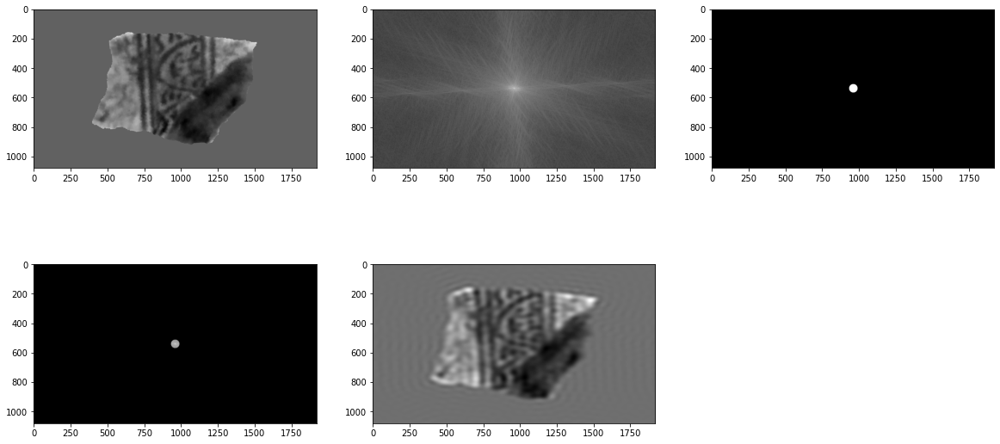

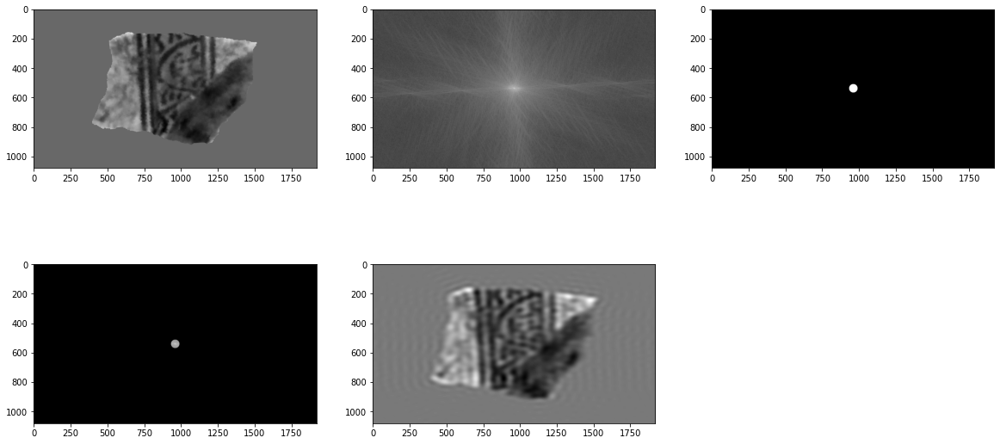

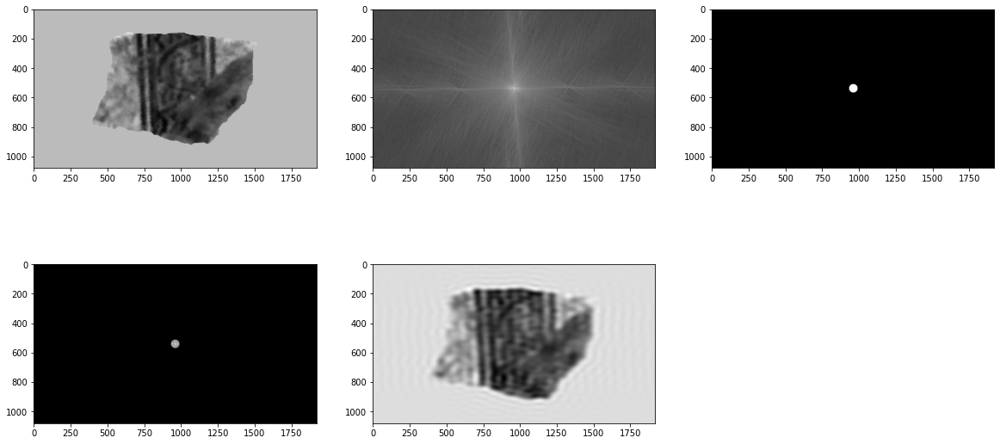

In [41]:
r,g,b = cv2.split(img_rgb)
rows,cols = r.shape
crow,ccol = rows//2,cols//2

gauss_kernel = (51,51)

fourier_img = mask_fourier([r,g,b],
                           [
                               cv2.GaussianBlur(build_circle_mask(30,ch),gauss_kernel,0)
                            for ch in [r,g,b]])


plot_images([img_rgb,(fourier_img*255).astype(np.uint8)],["rgb","fourier"],1,2)
img_rgb=(fourier_img*255).astype(np.uint8)

smoothed_img = cv2.bilateralFilter(img_rgb,9,75,75) #cv2.bilateralFilter(mean_smooth_rgb(img_rpf_000102_rgb,(100,100)),9,75,75)

kmeans_img = segment_kmeans(smoothed_img,6)
plot_images([smoothed_img,(kmeans_img*255).astype(np.uint8)],["Smoothed Image","Segmented by Kmeans"],1,2)

[[782.0, 0.034906585], [153.0, 1.5882496], [127.0, 1.6231562], [139.0, 1.6057029], [-728.0, 3.0368729], [65.0, 1.6755161], [734.0, 0.017453292], [-729.0, 3.106686], [117.0, 1.6406095], [880.0, 1.1519173], [941.0, 1.0821041], [125.0, 1.6231562], [-660.0, 3.054326], [892.0, 1.134464], [83.0, 1.6580628], [41.0, 1.6929693], [-663.0, 3.0717795], [-681.0, 3.0892327], [-747.0, 3.0717795], [-646.0, 3.0368729], [91.0, 1.6580628], [-640.0, 3.0368729], [-768.0, 3.106686], [824.0, 0.08726646], [901.0, 1.134464], [651.0, 1.7976891], [-646.0, 2.984513], [689.0, 0.4537856], [-677.0, 3.0717795], [-673.0, 3.0717795], [861.0, 1.1693705], [-641.0, 2.9496064], [1183.0, 0.82030475], [113.0, 1.6406095], [67.0, 1.7627826], [1206.0, 0.7853982], [929.0, 1.0995574], [659.0, 1.7976891], [-588.0, 2.9321532], [-647.0, 2.9670596], [-700.0, 3.0019662], [170.0, 1.5707964], [148.0, 1.6057029], [-667.0, 3.054326], [-655.0, 3.054326], [1176.0, 0.8552113], [-638.0, 3.0194197], [-701.0, 3.054326], [-759.0, 3.0892327], [77

C:\Users\yaniv\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: divide by zero encountered in true_divide


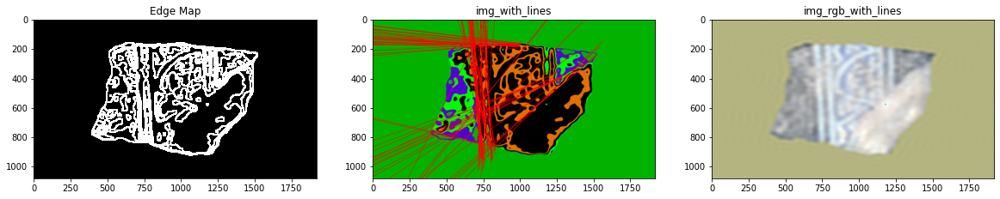

In [35]:
img_kmeans_gray = cv2.cvtColor((kmeans_img*255).astype(np.uint8),cv2.COLOR_RGB2GRAY)
img_edge_map = cv2.Canny(img_kmeans_gray,70,150)
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")

img_with_lines,out_lines = draw_hough_lines(
        (kmeans_img*255).astype(np.uint8),
        img_edge_map, #1/(1+np.abs(rpf_000102_gray_edge_map))
        1*np.pi/180,min_votes=100,
        lines_color=(255,0,0))
#plt.imshow(img_with_lines)
print(out_lines)
max_theta_thresh = 0.001
min_r_thresh = 30
parrallel_lines = find_parallel_lines(out_lines,
                                      max_theta_thresh=max_theta_thresh,
                                      min_r_thresh=min_r_thresh)
print(parrallel_lines)

img_rgb_with_lines = np.copy(img_rgb)
lines_color=(255,0,0)
for parralel_pair in parrallel_lines:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1])
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
    #second_line = parralel_pair[1]
#plt.imshow(img_rgb_with_lines)
figsize=(20,20)
fig,axes = plt.subplots(1,3,figsize=figsize)
axes[0].imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
axes[0].set_title("Edge Map")
for ax,image,title in zip(axes.flatten()[1:],[img_with_lines,img_rgb_with_lines],["img_with_lines","img_rgb_with_lines"]):
    ax.imshow(image)
    ax.set_title(title)

# RPf_00048

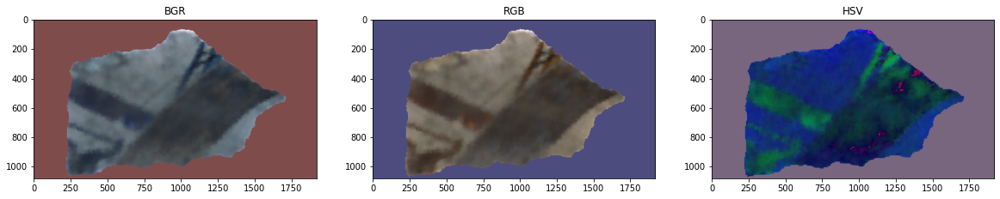

In [5]:
img_name = "RPf_00048.png"
img = cv2.imread(f"images/raw/border/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
plot_images([img,img_rgb,img_hsv],["BGR","RGB","HSV"],1,3)

r,g,b = cv2.split(img_rgb)
rows,cols = r.shape
crow,ccol = rows//2,cols//2

gauss_kernel = (51,51)

fourier_img = mask_fourier([r,g,b],
                           [
                               cv2.GaussianBlur(build_circle_mask(30,ch),gauss_kernel,0)
                            for ch in [r,g,b]])


plot_images([img_rgb,(fourier_img*255).astype(np.uint8)],["rgb","fourier"],1,2)
img_rgb=(fourier_img*255).astype(np.uint8)

smoothed_img = cv2.bilateralFilter(img_rgb,9,75,75) #cv2.bilateralFilter(mean_smooth_rgb(img_rpf_000102_rgb,(100,100)),9,75,75)

kmeans_img = segment_kmeans(smoothed_img,6)
plot_images([smoothed_img,(kmeans_img*255).astype(np.uint8)],["Smoothed Image","Segmented by Kmeans"],1,2)

[[1475.0, 0.7679449], [-545.0, 2.1991148], [1460.0, 0.7679449], [1037.0, 0.82030475], [1449.0, 0.82030475], [-568.0, 2.2165682], [-591.0, 2.2340214], [1467.0, 0.7853982], [-613.0, 2.2514746], [1051.0, 0.5934119], [-637.0, 2.268928], [1466.0, 0.75049156], [1027.0, 0.8552113], [1048.0, 1.4660766], [386.0, 2.0071287], [1447.0, 0.82030475], [1059.0, 0.5934119], [-522.0, 2.1816616]]
[(3, 4), (3, 15)]


C:\Users\yaniv\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: divide by zero encountered in true_divide


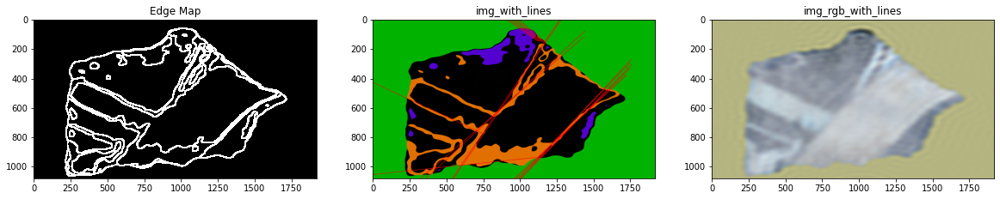

In [7]:
img_kmeans_gray = cv2.cvtColor((kmeans_img*255).astype(np.uint8),cv2.COLOR_RGB2GRAY)
img_edge_map = cv2.Canny(img_kmeans_gray,70,150)
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")

img_with_lines,out_lines = draw_hough_lines(
        (kmeans_img*255).astype(np.uint8),
        img_edge_map, #1/(1+np.abs(rpf_000102_gray_edge_map))
        1*np.pi/180,min_votes=100,
        lines_color=(255,0,0))
#plt.imshow(img_with_lines)
print(out_lines)
max_theta_thresh = 0.001
min_r_thresh = 30
parrallel_lines = find_parallel_lines(out_lines,
                                      max_theta_thresh=max_theta_thresh,
                                      min_r_thresh=min_r_thresh)
print(parrallel_lines)

img_rgb_with_lines = np.copy(img_rgb)
lines_color=(255,0,0)
for parralel_pair in parrallel_lines:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1])
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
    #second_line = parralel_pair[1]
#plt.imshow(img_rgb_with_lines)
figsize=(20,20)
fig,axes = plt.subplots(1,3,figsize=figsize)
axes[0].imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
axes[0].set_title("Edge Map")
for ax,image,title in zip(axes.flatten()[1:],[img_with_lines,img_rgb_with_lines],["img_with_lines","img_rgb_with_lines"]):
    ax.imshow(image)
    ax.set_title(title)

# RPf_00051

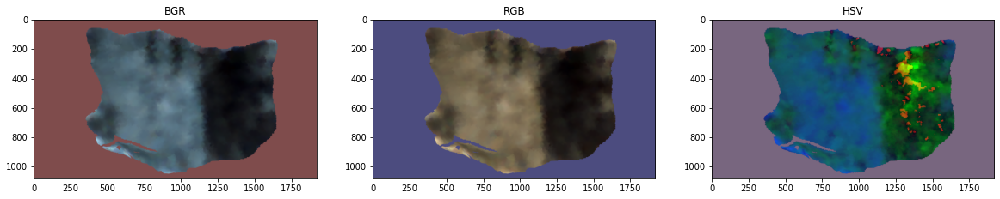

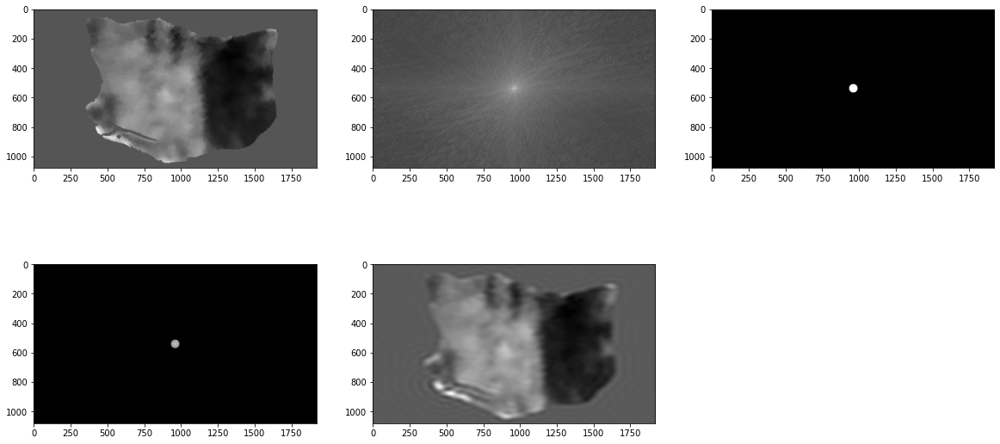

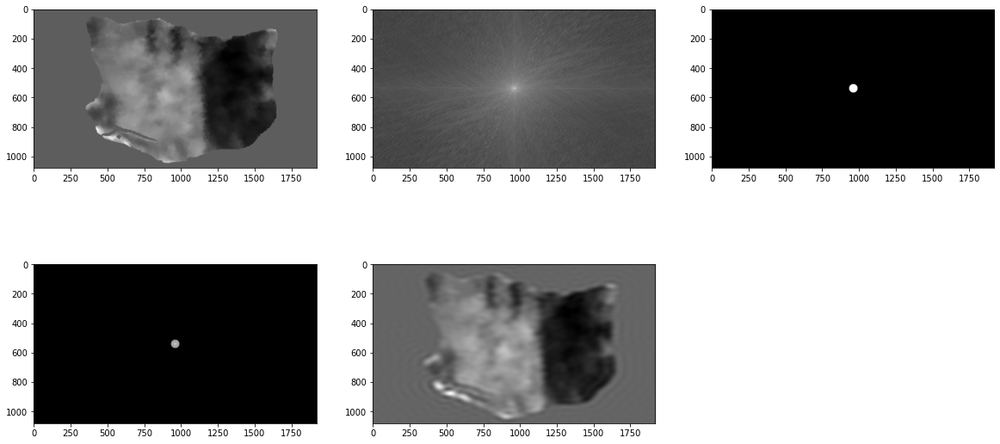

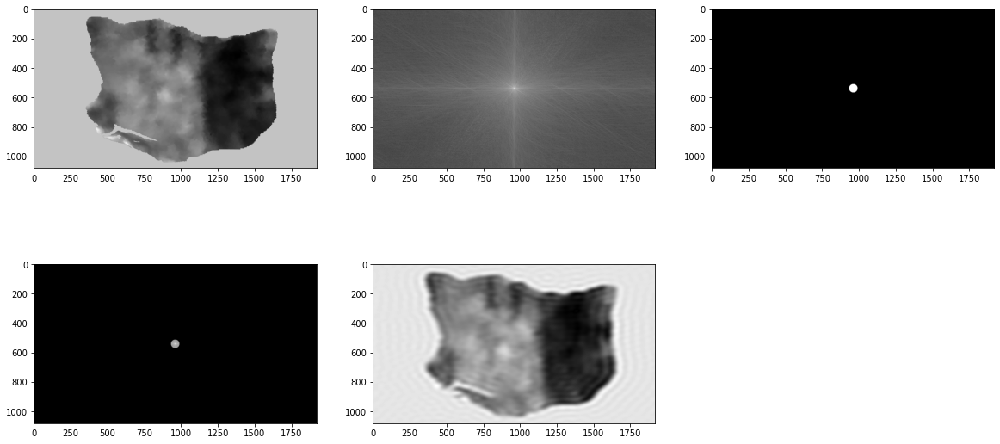

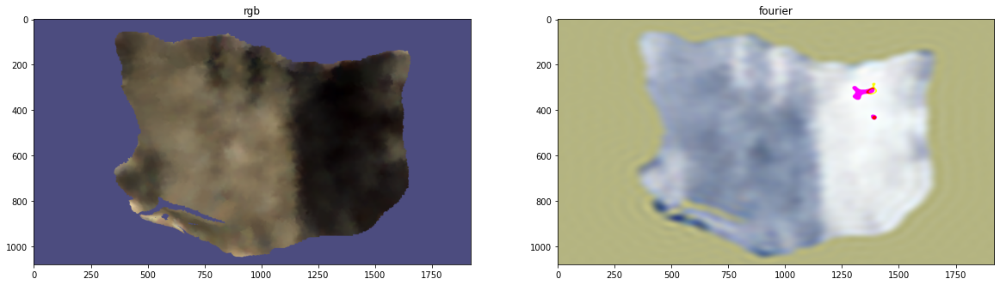

In [196]:
img_name = "RPf_00051.png"
img = cv2.imread(f"images/raw/border/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
plot_images([img,img_rgb,img_hsv],["BGR","RGB","HSV"],1,3)

r,g,b = cv2.split(img_rgb)
rows,cols = r.shape
crow,ccol = rows//2,cols//2

gauss_kernel = (51,51)

fourier_img = mask_fourier([r,g,b],
                           [
                               cv2.GaussianBlur(build_circle_mask(30,ch),gauss_kernel,0)
                            for ch in [r,g,b]])


plot_images([img_rgb,(fourier_img*255).astype(np.uint8)],["rgb","fourier"],1,2)
img_rgb=(fourier_img*255).astype(np.uint8)

smoothed_img = cv2.bilateralFilter(img_rgb,9,75,75) #cv2.bilateralFilter(mean_smooth_rgb(img_rpf_000102_rgb,(100,100)),9,75,75)

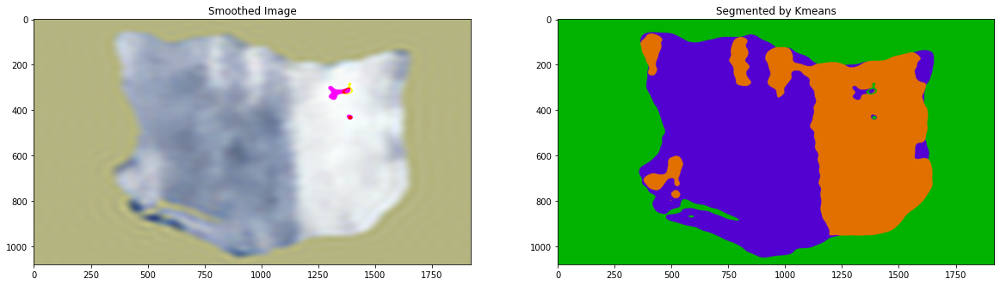

In [197]:
kmeans_img = segment_kmeans(smoothed_img,3)
plot_images([smoothed_img,(kmeans_img*255).astype(np.uint8)],["Smoothed Image","Segmented by Kmeans"],1,2)

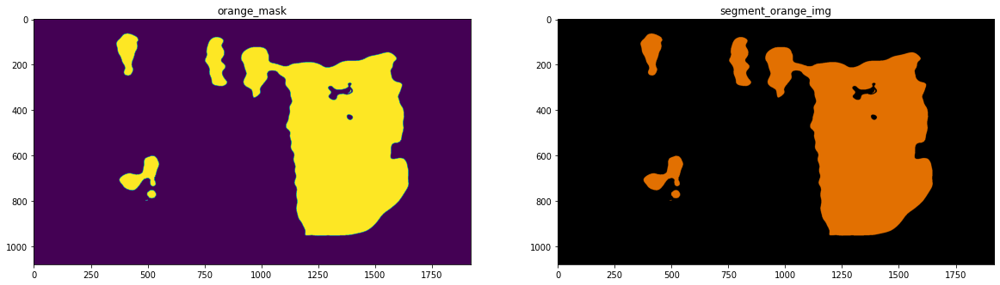

In [198]:
img_s_hsv = cv2.cvtColor((kmeans_img*255).astype(np.uint8),cv2.COLOR_RGB2HSV)
light_orange = (1, 190, 200)
dark_orange = (18, 255, 255)
orange_mask = cv2.inRange(img_s_hsv,light_orange,dark_orange)
segment_orange_img = cv2.bitwise_and((kmeans_img*255).astype(np.uint8),(kmeans_img*255).astype(np.uint8),mask=orange_mask)
plot_images([orange_mask,segment_orange_img],["orange_mask","segment_orange_img"],1,2)
# img_rpf_000102_segment_orange_img_gray = cv2.cvtColor((segment_orange_img*255).astype(np.uint8),cv2.COLOR_RGB2GRAY)
# rpf_000102_gray_edge_map = cv2.Canny(img_rpf_000102_segment_orange_img_gray,250,350)
# plt.imshow(1/(1+np.abs(rpf_000102_gray_edge_map)),cmap="gray")

[[952.0, 1.5707964], [1690.0, 0.80285144], [231.0, 1.5358897], [517.0, 1.3264502], [975.0, 1.553343], [1698.0, 0.7853982], [256.0, 1.5184364], [1621.0, 0.9075712], [492.0, 1.3439035], [930.0, 1.5882496], [-1098.0, 3.0717795], [314.0, 1.4660766], [-1078.0, 3.054326], [334.0, 1.4486233], [-1044.0, 3.0019662], [1634.0, 0.8901179], [542.0, 1.3089969], [467.0, 1.3613569], [-1111.0, 3.0892327], [442.0, 1.37881], [1782.0, 0.57595867], [998.0, 1.5358897], [-1504.0, 2.9670596], [-1066.0, 3.0368729], [-104.0, 1.850049], [-1085.0, 3.054326], [-1113.0, 3.0892327], [1786.0, 0.55850536], [1737.0, 0.6632251], [1733.0, 0.6806784], [-824.0, 2.8448865], [-1565.0, 3.0368729], [1646.0, 0.87266463], [-665.0, 2.687807], [-1591.0, 3.0717795]]
[(2, 21), (10, 34), (23, 31)]


C:\Users\yaniv\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: divide by zero encountered in true_divide


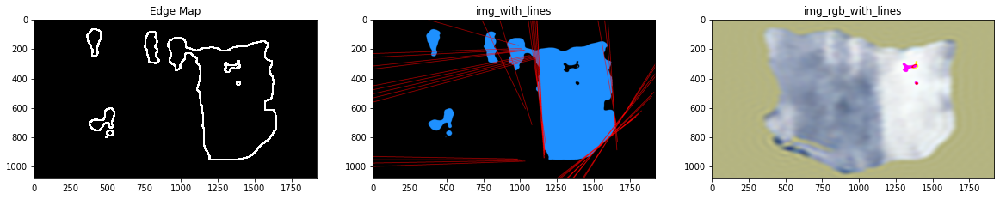

In [206]:
img_kmeans_gray = cv2.cvtColor((segment_orange_img*255).astype(np.uint8),cv2.COLOR_RGB2GRAY)
img_edge_map = cv2.Canny(img_kmeans_gray,70,150)
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")

img_with_lines,out_lines = draw_hough_lines(
        (segment_orange_img*255).astype(np.uint8),
        img_edge_map, #1/(1+np.abs(rpf_000102_gray_edge_map))
        1*np.pi/180,min_votes=50,
        lines_color=(255,0,0))
#plt.imshow(img_with_lines)
print(out_lines)
max_theta_thresh = 0.0000001
min_r_thresh = 300
parrallel_lines = find_parallel_lines(out_lines,
                                      max_theta_thresh=max_theta_thresh,
                                      min_r_thresh=min_r_thresh)
print(parrallel_lines)

img_rgb_with_lines = np.copy(img_rgb)
lines_color=(255,0,0)
for parralel_pair in parrallel_lines:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1])
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
    #second_line = parralel_pair[1]
#plt.imshow(img_rgb_with_lines)
figsize=(20,20)
fig,axes = plt.subplots(1,3,figsize=figsize)
axes[0].imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
axes[0].set_title("Edge Map")
for ax,image,title in zip(axes.flatten()[1:],[img_with_lines,img_rgb_with_lines],["img_with_lines","img_rgb_with_lines"]):
    ax.imshow(image)
    ax.set_title(title)

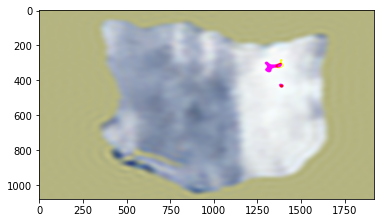

In [208]:
img_rgb_with_lines = np.copy(img_rgb)
lines_color=(0,0,0)
for parralel_pair in parrallel_lines:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1])
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
        
plt.imshow(img_rgb_with_lines)

# RPf_00059

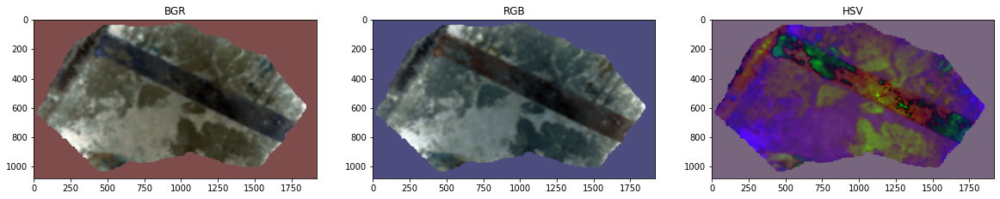

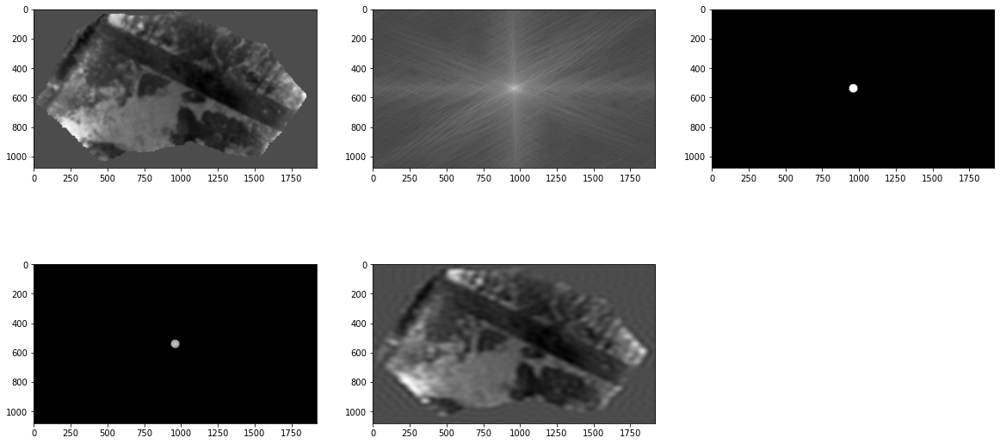

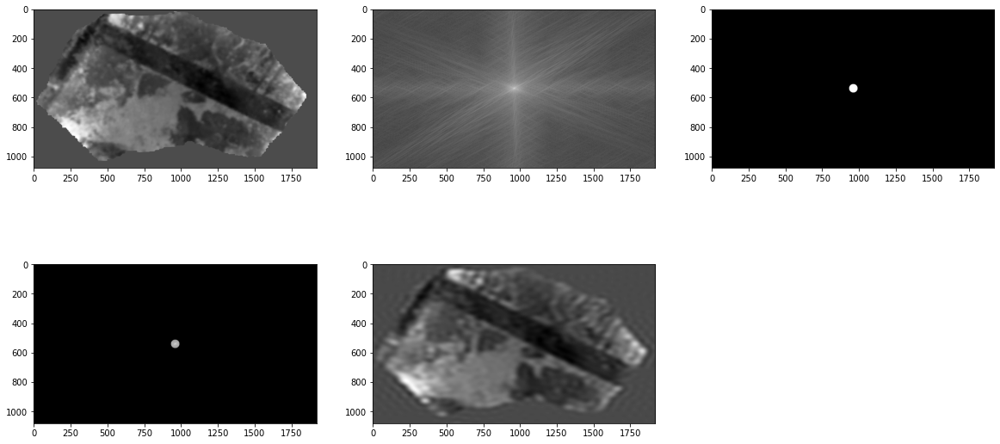

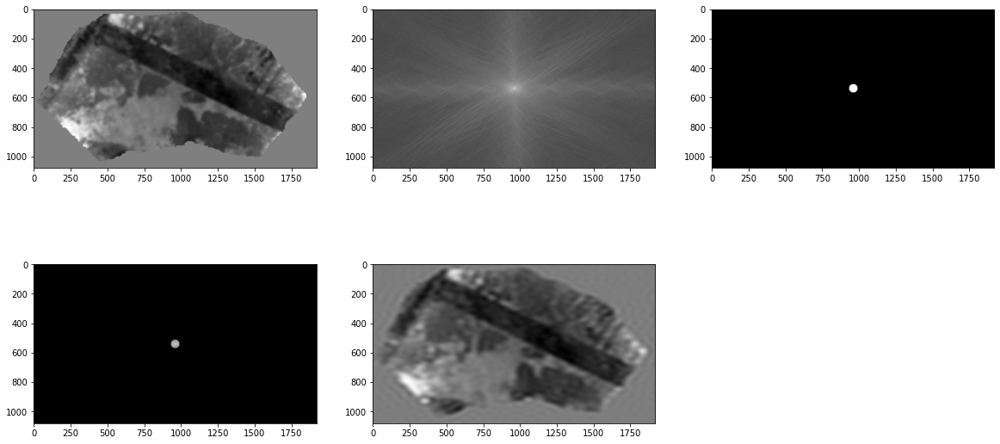

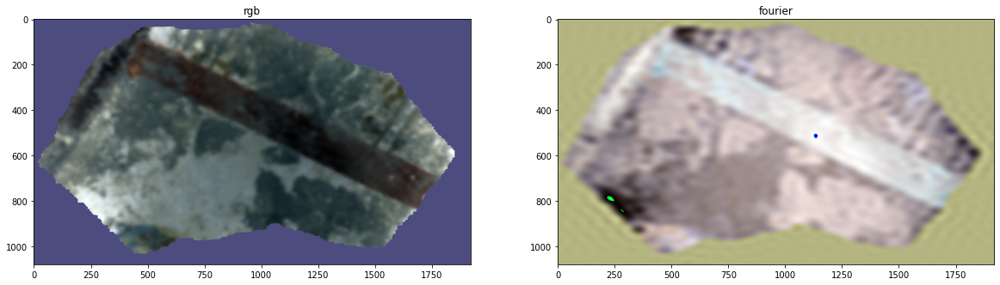

In [13]:
img_name = "RPf_00059.png"
img = cv2.imread(f"images/raw/border/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
plot_images([img,img_rgb,img_hsv],["BGR","RGB","HSV"],1,3)

r,g,b = cv2.split(img_rgb)
rows,cols = r.shape
crow,ccol = rows//2,cols//2

gauss_kernel = (51,51)

fourier_img = mask_fourier([r,g,b],
                           [
                               cv2.GaussianBlur(build_circle_mask(30,ch),gauss_kernel,0)
                            for ch in [r,g,b]])


plot_images([img_rgb,(fourier_img*255).astype(np.uint8)],["rgb","fourier"],1,2)
img_rgb=(fourier_img*255).astype(np.uint8)

smoothed_img = cv2.bilateralFilter(img_rgb,9,75,75) #cv2.bilateralFilter(mean_smooth_rgb(img_rpf_000102_rgb,(100,100)),9,75,75)

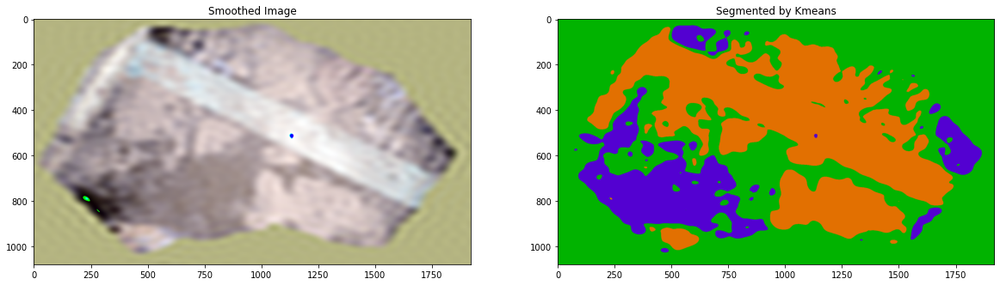

In [14]:
kmeans_img = segment_kmeans(smoothed_img,3)
plot_images([smoothed_img,(kmeans_img*255).astype(np.uint8)],["Smoothed Image","Segmented by Kmeans"],1,2)

[[27.0, 2.024582], [80.0, 1.9896753], [-123.0, 2.0071287], [54.0, 2.0071287]]
[(2, 3)]


C:\Users\yaniv\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: divide by zero encountered in true_divide


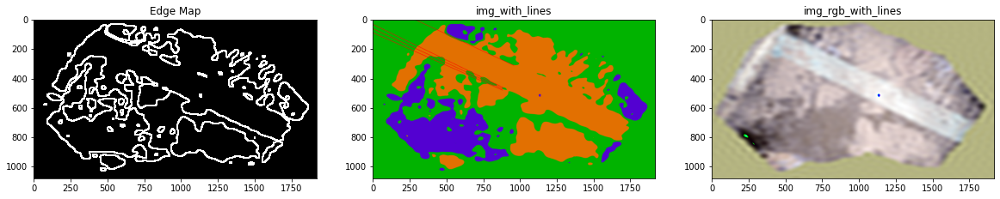

In [15]:
img_kmeans_gray = cv2.cvtColor((kmeans_img*255).astype(np.uint8),cv2.COLOR_RGB2GRAY)
img_edge_map = cv2.Canny(img_kmeans_gray,70,150)
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")

img_with_lines,out_lines = draw_hough_lines(
        (kmeans_img*255).astype(np.uint8),
        img_edge_map, #1/(1+np.abs(rpf_000102_gray_edge_map))
        1*np.pi/180,min_votes=100,
        lines_color=(255,0,0))
#plt.imshow(img_with_lines)
print(out_lines)
max_theta_thresh = 0.001
min_r_thresh = 30
parrallel_lines = find_parallel_lines(out_lines,
                                      max_theta_thresh=max_theta_thresh,
                                      min_r_thresh=min_r_thresh)
print(parrallel_lines)

img_rgb_with_lines = np.copy(img_rgb)
lines_color=(255,0,0)
for parralel_pair in parrallel_lines:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1])
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
    #second_line = parralel_pair[1]
#plt.imshow(img_rgb_with_lines)
figsize=(20,20)
fig,axes = plt.subplots(1,3,figsize=figsize)
axes[0].imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
axes[0].set_title("Edge Map")
for ax,image,title in zip(axes.flatten()[1:],[img_with_lines,img_rgb_with_lines],["img_with_lines","img_rgb_with_lines"]):
    ax.imshow(image)
    ax.set_title(title)

# RPf_00061

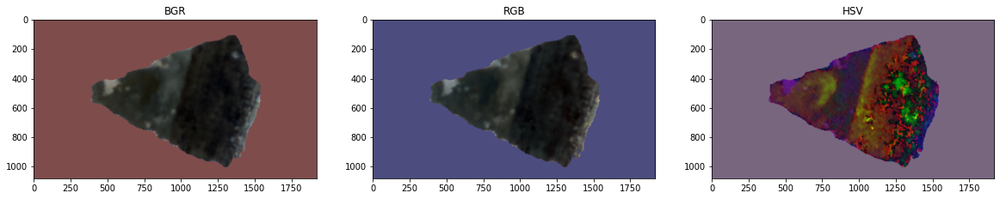

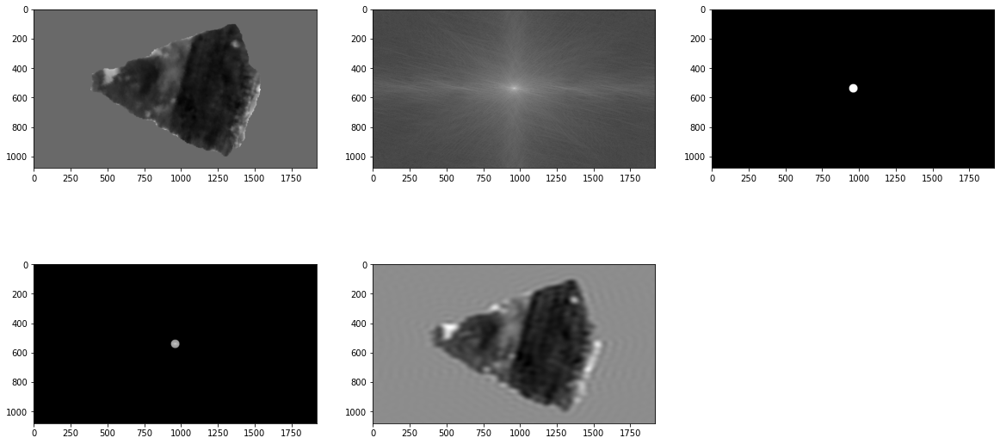

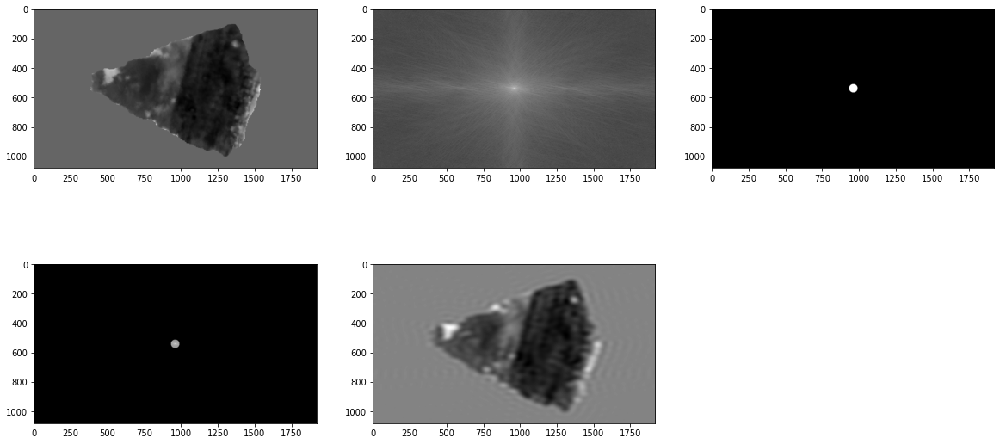

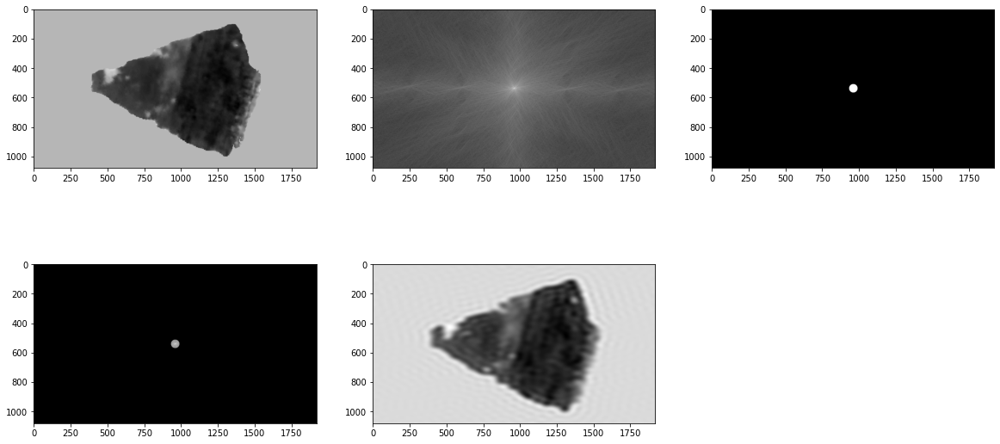

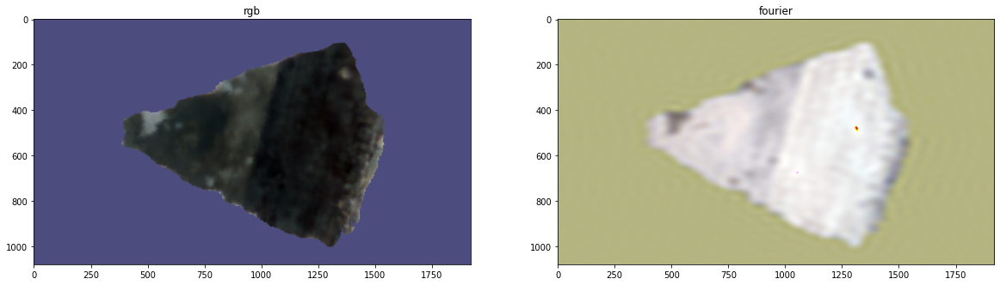

In [20]:
img_name = "RPf_00061.png"
img = cv2.imread(f"images/raw/border/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
plot_images([img,img_rgb,img_hsv],["BGR","RGB","HSV"],1,3)

r,g,b = cv2.split(img_rgb)
rows,cols = r.shape
crow,ccol = rows//2,cols//2

gauss_kernel = (51,51)

fourier_img = mask_fourier([r,g,b],
                           [
                               cv2.GaussianBlur(build_circle_mask(30,ch),gauss_kernel,0)
                            for ch in [r,g,b]])


plot_images([img_rgb,(fourier_img*255).astype(np.uint8)],["rgb","fourier"],1,2)
img_rgb=(fourier_img*255).astype(np.uint8)

In [21]:
smoothed_img = cv2.bilateralFilter(img_rgb,200,300,300) #cv2.bilateralFilter(mean_smooth_rgb(img_rpf_000102_rgb,(100,100)),9,75,75)

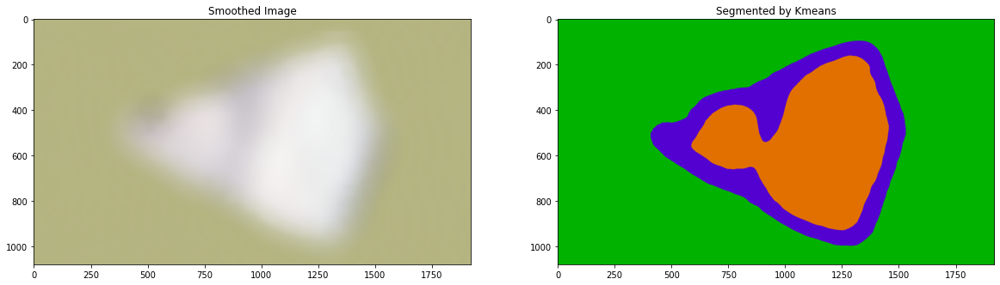

In [22]:
kmeans_img = segment_kmeans(smoothed_img,3)
plot_images([smoothed_img,(kmeans_img*255).astype(np.uint8)],["Smoothed Image","Segmented by Kmeans"],1,2)

[[1616.0, 0.33161256], [641.0, 1.0995574], [439.0, 1.9373155], [-1267.0, 2.7750735], [1610.0, 0.31415927], [251.0, 2.146755], [-1281.0, 2.7925267], [1560.0, 0.40142572], [569.0, 1.8849555], [264.0, 2.1293018], [487.0, 1.2566371], [657.0, 1.0821041], [414.0, 1.9547688], [196.0, 2.1642082], [310.0, 2.0769417], [-1252.0, 2.75762], [-400.0, 2.6005406], [456.0, 1.9198622], [-1293.0, 2.8099802], [219.0, 2.146755], [281.0, 2.1118484], [159.0, 2.146755], [174.0, 2.1816616], [1619.0, 0.34906584], [560.0, 1.1868238], [587.0, 1.2217305], [1065.0, 0.2617994], [627.0, 1.1170107], [240.0, 2.1293018], [945.0, 0.7853982], [287.0, 2.0943952], [-784.0, 2.9670596], [1561.0, 0.41887903], [955.0, 0.7679449], [-381.0, 2.5830872]]
[(5, 19), (5, 21), (19, 21)]


C:\Users\yaniv\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: divide by zero encountered in true_divide


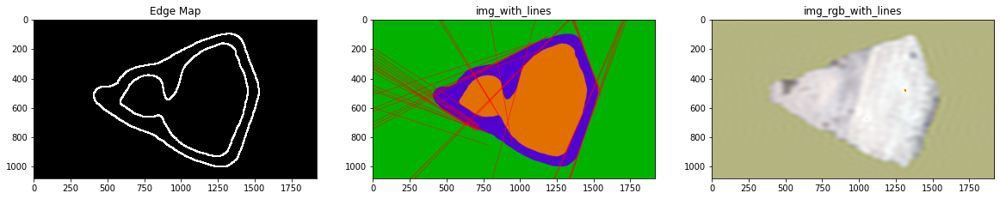

In [23]:
img_kmeans_gray = cv2.cvtColor((kmeans_img*255).astype(np.uint8),cv2.COLOR_RGB2GRAY)
img_edge_map = cv2.Canny(img_kmeans_gray,70,150)
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")

img_with_lines,out_lines = draw_hough_lines(
        (kmeans_img*255).astype(np.uint8),
        img_edge_map, #1/(1+np.abs(rpf_000102_gray_edge_map))
        1*np.pi/180,min_votes=70,
        lines_color=(255,0,0))
#plt.imshow(img_with_lines)
print(out_lines)
max_theta_thresh = 0.001
min_r_thresh = 30
parrallel_lines = find_parallel_lines(out_lines,
                                      max_theta_thresh=max_theta_thresh,
                                      min_r_thresh=min_r_thresh)
print(parrallel_lines)

img_rgb_with_lines = np.copy(img_rgb)
lines_color=(255,0,0)
for parralel_pair in parrallel_lines:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1])
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
    #second_line = parralel_pair[1]
#plt.imshow(img_rgb_with_lines)
figsize=(20,20)
fig,axes = plt.subplots(1,3,figsize=figsize)
axes[0].imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
axes[0].set_title("Edge Map")
for ax,image,title in zip(axes.flatten()[1:],[img_with_lines,img_rgb_with_lines],["img_with_lines","img_rgb_with_lines"]):
    ax.imshow(image)
    ax.set_title(title)

# RPf_00065

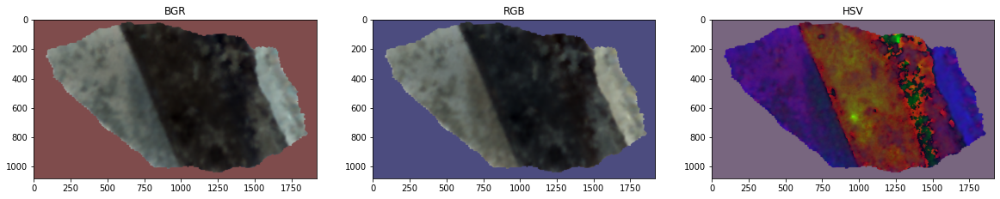

In [216]:
img_name = "RPf_00065.png"
img = cv2.imread(f"images/raw/border/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
plot_images([img,img_rgb,img_hsv],["BGR","RGB","HSV"],1,3)

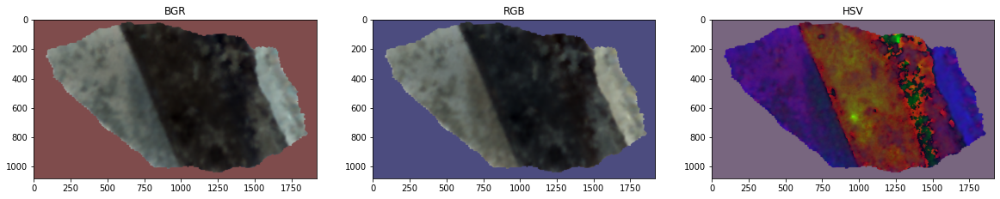

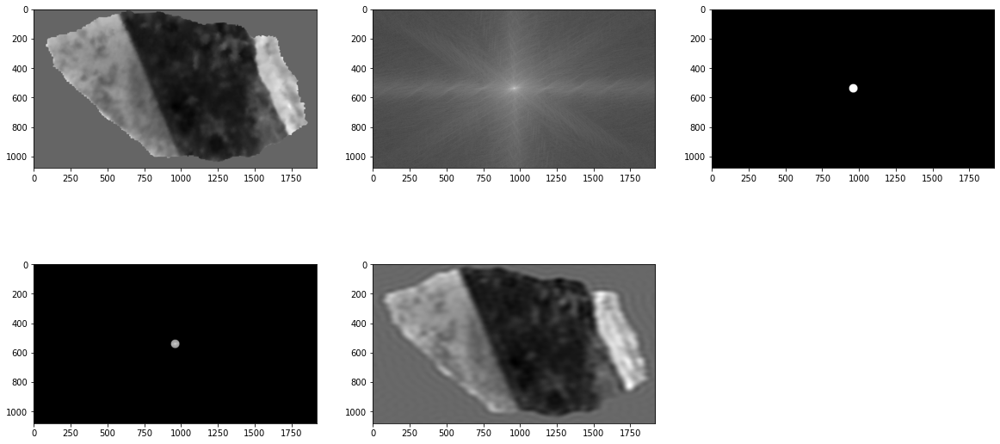

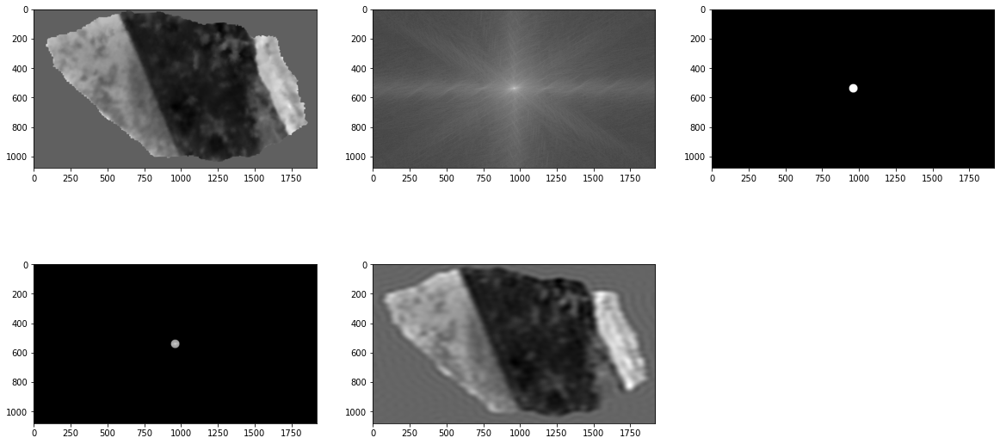

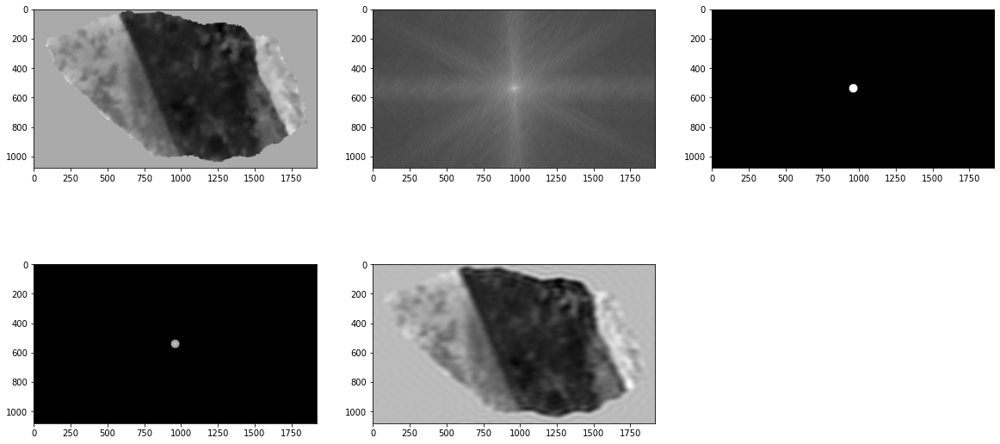

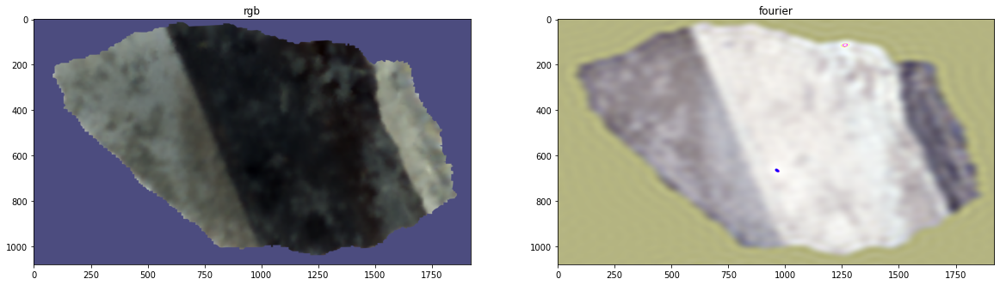

In [209]:
r,g,b = cv2.split(img_rgb)
rows,cols = r.shape
crow,ccol = rows//2,cols//2

gauss_kernel = (51,51)

fourier_img = mask_fourier([r,g,b],
                           [
                               cv2.GaussianBlur(build_circle_mask(30,ch),gauss_kernel,0)
                            for ch in [r,g,b]])


plot_images([img_rgb,(fourier_img*255).astype(np.uint8)],["rgb","fourier"],1,2)
img_rgb=(fourier_img*255).astype(np.uint8)

In [210]:
smoothed_img = cv2.bilateralFilter(img_rgb,9,75,75) #cv2.bilateralFilter(mean_smooth_rgb(img_rpf_000102_rgb,(100,100)),9,75,75)

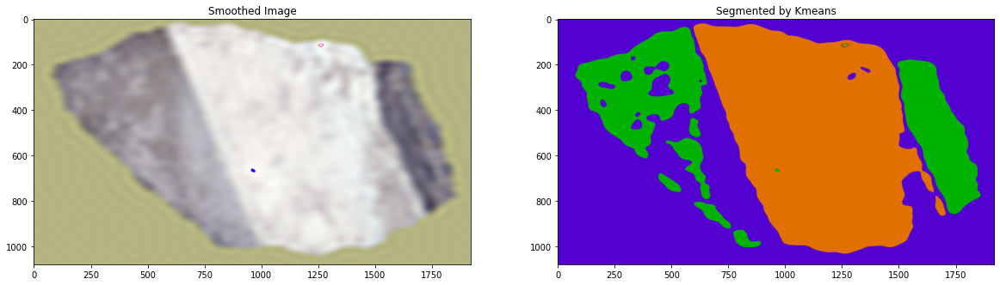

In [211]:
kmeans_img = segment_kmeans(smoothed_img,3)
plot_images([smoothed_img,(kmeans_img*255).astype(np.uint8)],["Smoothed Image","Segmented by Kmeans"],1,2)

[[-550.0, 2.7925267], [-540.0, 2.7750735], [-538.0, 2.7750735], [261.0, 2.2165682], [-63.0, 2.4958208], [-1361.0, 2.8448865], [-508.0, 2.740167], [-533.0, 2.75762], [-560.0, 2.8099802], [-1357.0, 2.8274333], [-71.0, 1.7104226], [-1372.0, 2.8797932], [7.0, 1.6057029], [-1404.0, 2.9321532], [-216.0, 1.850049], [278.0, 1.0297443], [171.0, 2.3736477], [-512.0, 2.740167], [218.0, 1.3089969], [-76.0, 2.5132742], [-548.0, 2.8099802], [273.0, 1.0471976], [-1199.0, 2.7052603], [-1380.0, 2.86234], [282.0, 1.012291], [267.0, 1.43117], [206.0, 1.4835298], [216.0, 1.3264502], [292.0, 2.1816616], [185.0, 2.3561945], [-91.0, 2.5307274], [-481.0, 2.7052603], [-525.0, 2.740167], [-524.0, 2.9670596]]
[(22, 31)]


C:\Users\yaniv\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: divide by zero encountered in true_divide


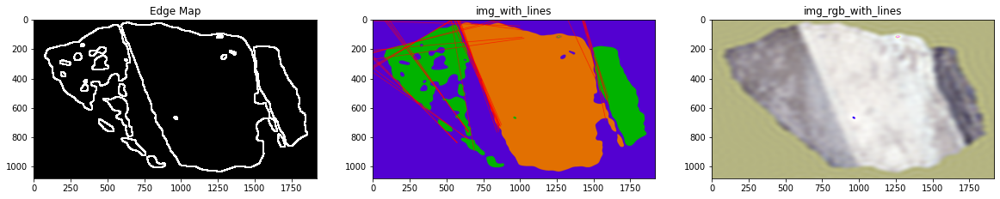

In [212]:
img_kmeans_gray = cv2.cvtColor((kmeans_img*255).astype(np.uint8),cv2.COLOR_RGB2GRAY)
img_edge_map = cv2.Canny(img_kmeans_gray,70,150)
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")

img_with_lines,out_lines = draw_hough_lines(
        (kmeans_img*255).astype(np.uint8),
        img_edge_map, #1/(1+np.abs(rpf_000102_gray_edge_map))
        1*np.pi/180,min_votes=70,
        lines_color=(255,0,0))
#plt.imshow(img_with_lines)
print(out_lines)
max_theta_thresh = 0.001
min_r_thresh = 30
parrallel_lines = find_parallel_lines(out_lines,
                                      max_theta_thresh=max_theta_thresh,
                                      min_r_thresh=min_r_thresh)
print(parrallel_lines)

img_rgb_with_lines = np.copy(img_rgb)
lines_color=(255,0,0)
for parralel_pair in parrallel_lines:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1])
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
    #second_line = parralel_pair[1]
#plt.imshow(img_rgb_with_lines)
figsize=(20,20)
fig,axes = plt.subplots(1,3,figsize=figsize)
axes[0].imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
axes[0].set_title("Edge Map")
for ax,image,title in zip(axes.flatten()[1:],[img_with_lines,img_rgb_with_lines],["img_with_lines","img_rgb_with_lines"]):
    ax.imshow(image)
    ax.set_title(title)

h


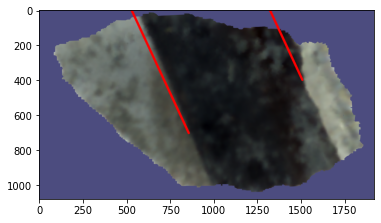

In [218]:
img_rgb_with_lines = np.copy(img_rgb)
lines_color=(255,0,0)
for parralel_pair in parrallel_lines:
    print("h")
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1])
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
plt.imshow(img_rgb_with_lines)

In [219]:
fragments_names.append(img_name)
print(fragments_names)

['RPf_00004.png', 'RPf_00006.png', 'RPf_00008.png', 'RPf_00018.png', 'RPf_00022.png', 'RPf_00025.png', 'RPf_00028.png', 'RPf_00065.png']


In [220]:
for pl in parrallel_lines:
    print(str(out_lines[pl[0]]) + " ----" + str(out_lines[pl[1]]))

lines_diff = abs(out_lines[parrallel_lines[0][0]][0] - out_lines[parrallel_lines[0][1]][0])
print(lines_diff)

[-1199.0, 2.7052603] ----[-481.0, 2.7052603]
718.0


In [221]:
borders_widths.append(lines_diff)
print(borders_widths)

[8.0, 8.0, 41.0, 235.0, 204.0, 76.0, 55.0, 718.0]


In [222]:
kmeans_labels = segment_kmeans_labels(smoothed_img,3)

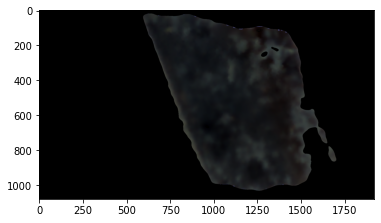

In [229]:

label_ = 1

label_mask = np.where(kmeans_labels == label_, 1,0)

# r_,g_,b_ = cv2.split(img_rgb)
# r_ = np.where(r_==label_,r_,0)
# b_ = np.bitwise_and(b_,label_mask)
# g_ = np.bitwise_and(g_,label_mask)
# img_rgb_masked = cv2.merge((r_,g_,b_))


img = cv2.imread(f"images/raw/border/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
new_img = np.copy(img_rgb)#.reshape(img_rgb.shape[0]*img_rgb.shape[1], img_rgb.shape[2])


for i in range(img_rgb.shape[0]):
    for j in range(img_rgb.shape[1]):
        if label_mask[i,j] != 1:
            new_img[i,j] = (0,0,0)
plt.imshow(new_img)

In [230]:
img_as_vec = new_img.reshape(img_rgb.shape[0]*img_rgb.shape[1], img_rgb.shape[2])
zeros = np.zeros((1,3))
#img_as_vec = img_as_vec[np.all()]
new_vector = []

for i_row in range(img_as_vec.shape[0]):
    if not np.all(img_as_vec[i_row] == zeros):
        new_vector.append(img_as_vec[i_row])

mean_ = np.mean(new_vector,axis=0)
averaged_colors.append(mean_)
print(len(new_vector))
print(mean_)


688399
[27.26543763 28.64456514 30.47817908]


# RPf_00067

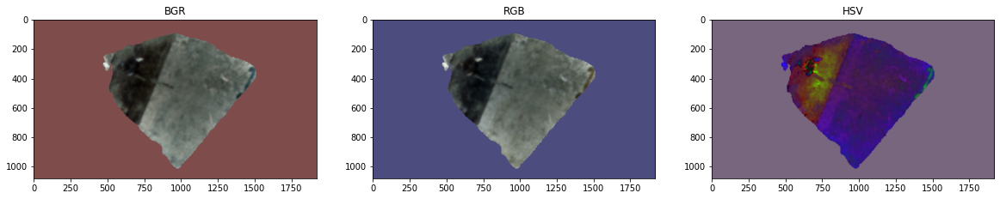

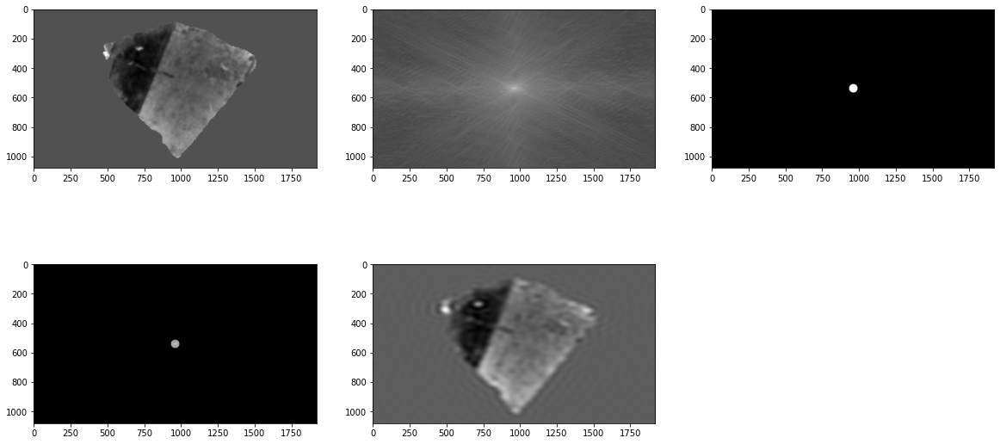

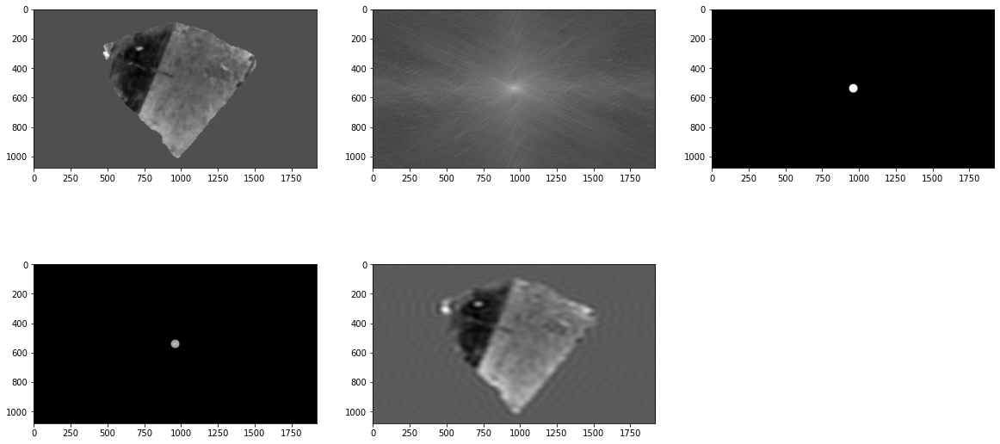

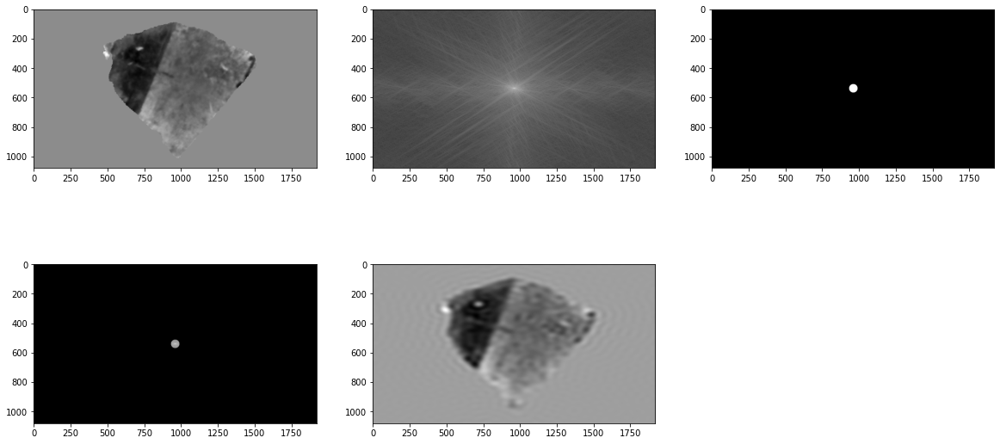

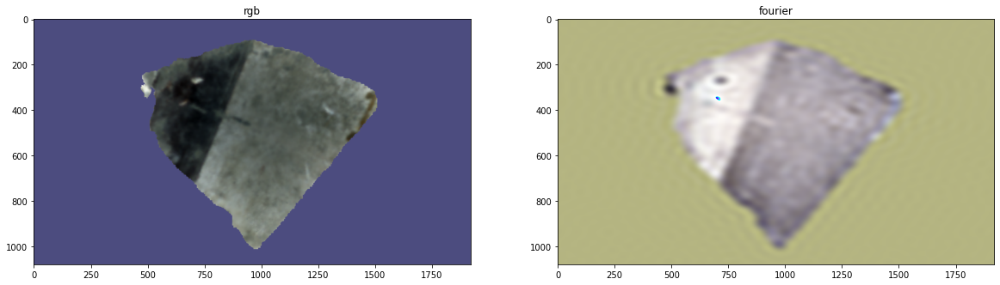

In [231]:
img_name = "RPf_00067.png"
img = cv2.imread(f"images/raw/border/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
plot_images([img,img_rgb,img_hsv],["BGR","RGB","HSV"],1,3)

r,g,b = cv2.split(img_rgb)
rows,cols = r.shape
crow,ccol = rows//2,cols//2

gauss_kernel = (51,51)

fourier_img = mask_fourier([r,g,b],
                           [
                               cv2.GaussianBlur(build_circle_mask(30,ch),gauss_kernel,0)
                            for ch in [r,g,b]])


plot_images([img_rgb,(fourier_img*255).astype(np.uint8)],["rgb","fourier"],1,2)
img_rgb=(fourier_img*255).astype(np.uint8)

In [29]:
smoothed_img = cv2.bilateralFilter(img_rgb,100,300,300) #cv2.bilateralFilter(mean_smooth_rgb(img_rpf_000102_rgb,(100,100)),9,75,75)

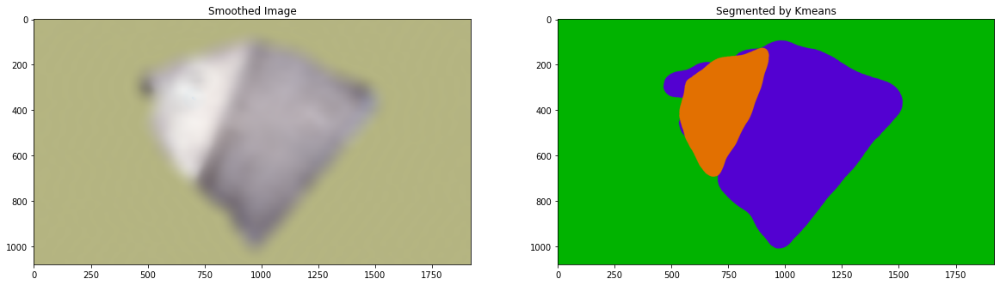

In [30]:
kmeans_img = segment_kmeans(smoothed_img,3)
plot_images([smoothed_img,(kmeans_img*255).astype(np.uint8)],["Smoothed Image","Segmented by Kmeans"],1,2)

[[1416.0, 0.6981317], [1419.0, 0.6806784], [1411.0, 0.715585], [1393.0, 0.7330383], [1438.0, 0.62831855], [1382.0, 0.75049156], [1418.0, 0.75049156], [938.0, 0.31415927], [1420.0, 0.6457718], [-78.0, 2.443461], [1404.0, 0.715585], [-31.0, 2.4085543], [948.0, 0.4886922], [451.0, 1.1868238], [374.0, 1.2740903], [25.0, 2.3561945], [-185.0, 1.8849555], [-249.0, 2.6529005], [1443.0, 0.61086524], [-235.0, 2.6354473], [-101.0, 2.4609141], [1371.0, 0.7679449], [552.0, 0.94247776], [941.0, 0.34906584], [941.0, 0.43633232], [946.0, 0.4886922], [558.0, 0.9250245], [464.0, 1.1693705], [1433.0, 0.6457718], [360.0, 1.2915436], [242.0, 1.4660766], [-360.0, 2.0071287]]
[(5, 6)]


C:\Users\yaniv\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: divide by zero encountered in true_divide


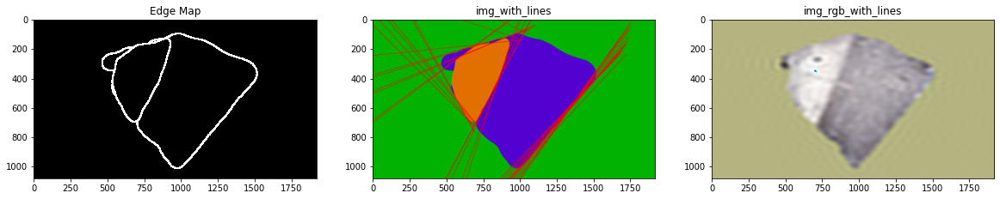

In [31]:
img_kmeans_gray = cv2.cvtColor((kmeans_img*255).astype(np.uint8),cv2.COLOR_RGB2GRAY)
img_edge_map = cv2.Canny(img_kmeans_gray,70,150)
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")

img_with_lines,out_lines = draw_hough_lines(
        (kmeans_img*255).astype(np.uint8),
        img_edge_map, #1/(1+np.abs(rpf_000102_gray_edge_map))
        1*np.pi/180,min_votes=70,
        lines_color=(255,0,0))
#plt.imshow(img_with_lines)
print(out_lines)
max_theta_thresh = 0.001
min_r_thresh = 30
parrallel_lines = find_parallel_lines(out_lines,
                                      max_theta_thresh=max_theta_thresh,
                                      min_r_thresh=min_r_thresh)
print(parrallel_lines)

img_rgb_with_lines = np.copy(img_rgb)
lines_color=(255,0,0)
for parralel_pair in parrallel_lines:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1])
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
    #second_line = parralel_pair[1]
#plt.imshow(img_rgb_with_lines)
figsize=(20,20)
fig,axes = plt.subplots(1,3,figsize=figsize)
axes[0].imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
axes[0].set_title("Edge Map")
for ax,image,title in zip(axes.flatten()[1:],[img_with_lines,img_rgb_with_lines],["img_with_lines","img_rgb_with_lines"]):
    ax.imshow(image)
    ax.set_title(title)

# RPf_00068

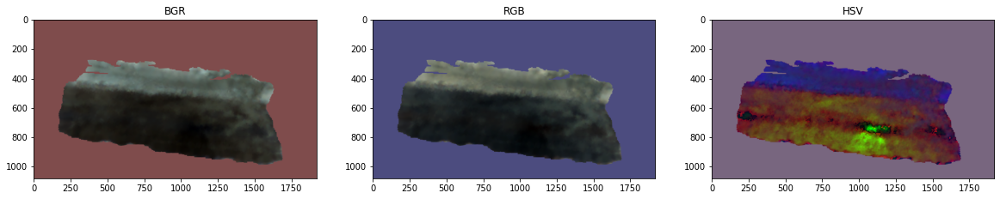

In [241]:
img_name = "RPf_00068.png"
img = cv2.imread(f"images/raw/border/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
plot_images([img,img_rgb,img_hsv],["BGR","RGB","HSV"],1,3)

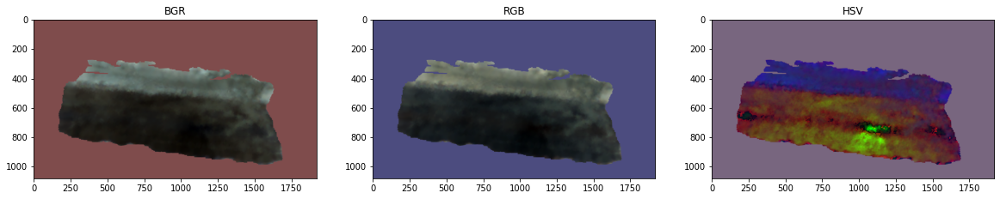

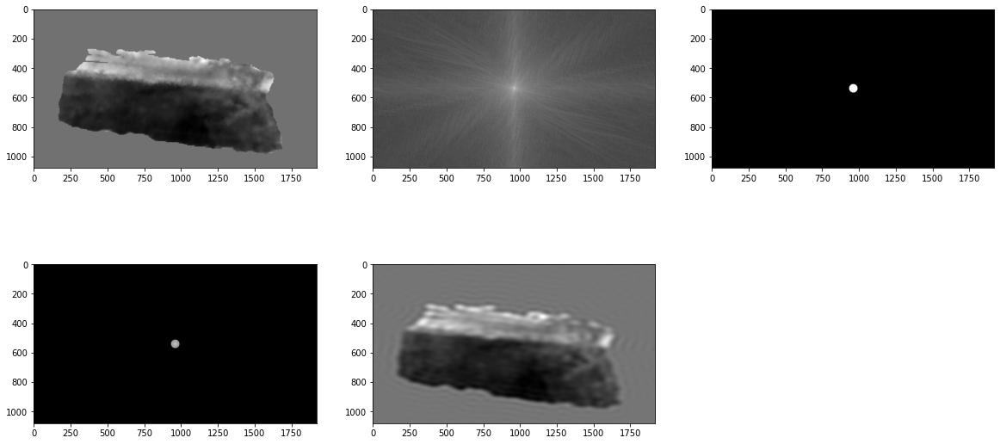

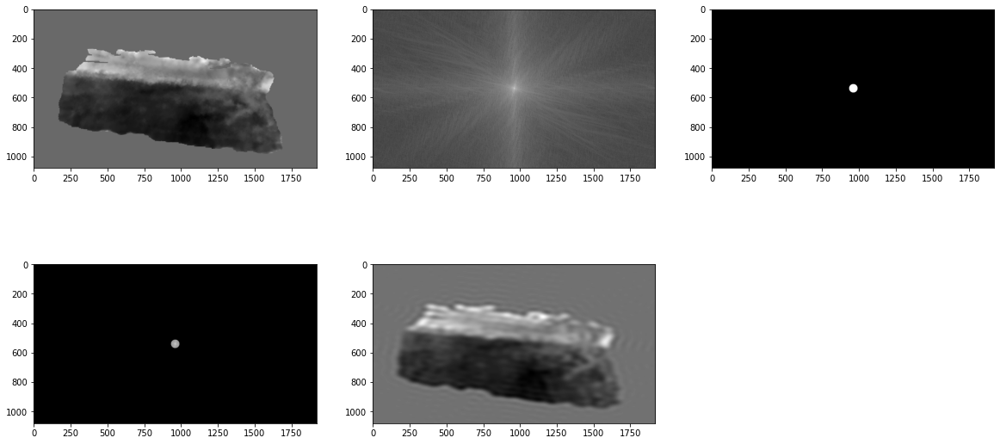

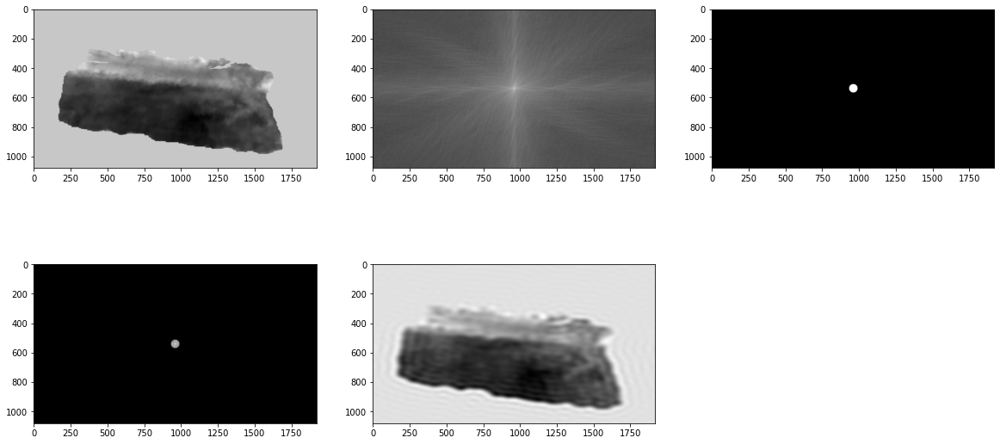

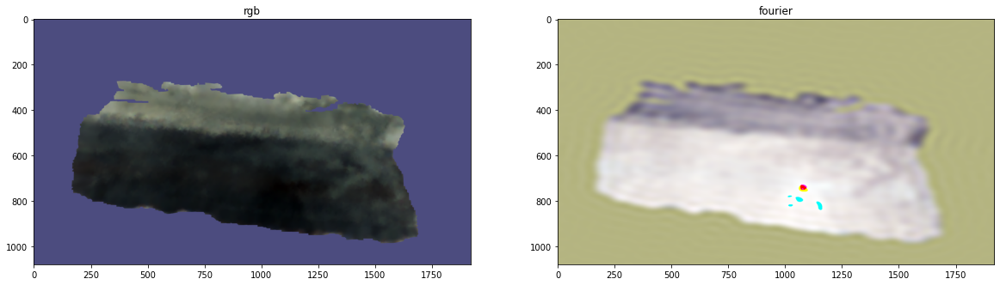

In [236]:
r,g,b = cv2.split(img_rgb)
rows,cols = r.shape
crow,ccol = rows//2,cols//2

gauss_kernel = (51,51)

fourier_img = mask_fourier([r,g,b],
                           [
                               cv2.GaussianBlur(build_circle_mask(30,ch),gauss_kernel,0)
                            for ch in [r,g,b]])


plot_images([img_rgb,(fourier_img*255).astype(np.uint8)],["rgb","fourier"],1,2)
img_rgb=(fourier_img*255).astype(np.uint8)

In [237]:
smoothed_img = cv2.bilateralFilter(img_rgb,50,200,200) #cv2.bilateralFilter(mean_smooth_rgb(img_rpf_000102_rgb,(100,100)),9,75,75)

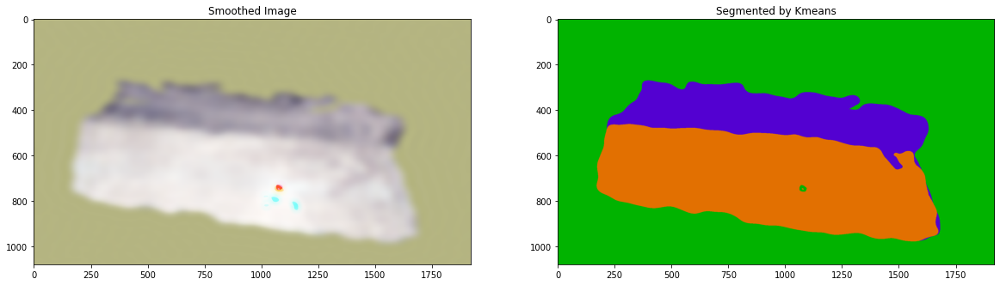

In [238]:
kmeans_img = segment_kmeans(smoothed_img,3)
plot_images([smoothed_img,(kmeans_img*255).astype(np.uint8)],["Smoothed Image","Segmented by Kmeans"],1,2)

[[439.0, 1.6406095], [453.0, 1.6231562], [415.0, 1.6755161], [751.0, 1.727876], [805.0, 1.6755161]]
[(0, 3), (0, 4), (1, 2), (1, 4), (2, 3), (2, 4), (3, 4)]


C:\Users\yaniv\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: RuntimeWarning: divide by zero encountered in true_divide


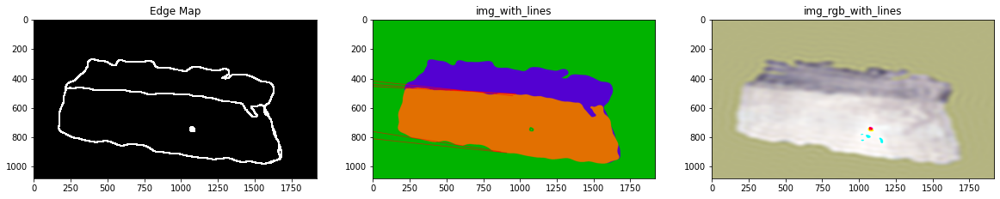

In [239]:
img_kmeans_gray = cv2.cvtColor((kmeans_img*255).astype(np.uint8),cv2.COLOR_RGB2GRAY)
img_edge_map = cv2.Canny(img_kmeans_gray,70,150)
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")

img_with_lines,out_lines = draw_hough_lines(
        (kmeans_img*255).astype(np.uint8),
        img_edge_map, #1/(1+np.abs(rpf_000102_gray_edge_map))
        1*np.pi/180,min_votes=100,
        lines_color=(255,0,0))
#plt.imshow(img_with_lines)
print(out_lines)
max_theta_thresh = 0.1
min_r_thresh = 30
parrallel_lines = find_parallel_lines(out_lines,
                                      max_theta_thresh=max_theta_thresh,
                                      min_r_thresh=min_r_thresh)
print(parrallel_lines)

img_rgb_with_lines = np.copy(img_rgb)
lines_color=(255,0,0)
for parralel_pair in parrallel_lines:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1])
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
    #second_line = parralel_pair[1]
#plt.imshow(img_rgb_with_lines)
figsize=(20,20)
fig,axes = plt.subplots(1,3,figsize=figsize)
axes[0].imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
axes[0].set_title("Edge Map")
for ax,image,title in zip(axes.flatten()[1:],[img_with_lines,img_rgb_with_lines],["img_with_lines","img_rgb_with_lines"]):
    ax.imshow(image)
    ax.set_title(title)

h
h


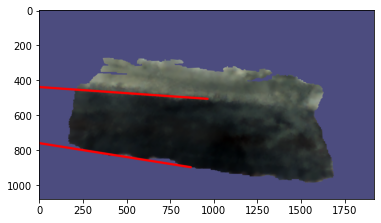

In [242]:
img_rgb_with_lines = np.copy(img_rgb)
plt.imshow(img_rgb_with_lines)

for parralel_pair in parrallel_lines[:1]:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1])
        print("h")
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
        
plt.imshow(img_rgb_with_lines)

In [243]:
fragments_names.append(img_name)
print(fragments_names)

['RPf_00004.png', 'RPf_00006.png', 'RPf_00008.png', 'RPf_00018.png', 'RPf_00022.png', 'RPf_00025.png', 'RPf_00028.png', 'RPf_00065.png', 'RPf_00068.png']


In [244]:
for pl in parrallel_lines:
    print(str(out_lines[pl[0]]) + " ----" + str(out_lines[pl[1]]))

lines_diff = abs(out_lines[parrallel_lines[0][0]][0] - out_lines[parrallel_lines[0][1]][0])
print(lines_diff)

[439.0, 1.6406095] ----[751.0, 1.727876]
[439.0, 1.6406095] ----[805.0, 1.6755161]
[453.0, 1.6231562] ----[415.0, 1.6755161]
[453.0, 1.6231562] ----[805.0, 1.6755161]
[415.0, 1.6755161] ----[751.0, 1.727876]
[415.0, 1.6755161] ----[805.0, 1.6755161]
[751.0, 1.727876] ----[805.0, 1.6755161]
312.0


In [245]:
borders_widths.append(lines_diff)
print(borders_widths)

[8.0, 8.0, 41.0, 235.0, 204.0, 76.0, 55.0, 718.0, 312.0]


In [246]:
kmeans_labels = segment_kmeans_labels(smoothed_img,3)

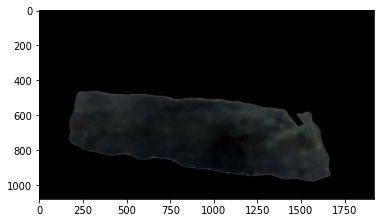

In [248]:

label_ = 1

label_mask = np.where(kmeans_labels == label_, 1,0)

# r_,g_,b_ = cv2.split(img_rgb)
# r_ = np.where(r_==label_,r_,0)
# b_ = np.bitwise_and(b_,label_mask)
# g_ = np.bitwise_and(g_,label_mask)
# img_rgb_masked = cv2.merge((r_,g_,b_))


img = cv2.imread(f"images/raw/border/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
new_img = np.copy(img_rgb)#.reshape(img_rgb.shape[0]*img_rgb.shape[1], img_rgb.shape[2])


for i in range(img_rgb.shape[0]):
    for j in range(img_rgb.shape[1]):
        if label_mask[i,j] != 1:
            new_img[i,j] = (0,0,0)
plt.imshow(new_img)

In [249]:
img_as_vec = new_img.reshape(img_rgb.shape[0]*img_rgb.shape[1], img_rgb.shape[2])
zeros = np.zeros((1,3))
#img_as_vec = img_as_vec[np.all()]
new_vector = []

for i_row in range(img_as_vec.shape[0]):
    if not np.all(img_as_vec[i_row] == zeros):
        new_vector.append(img_as_vec[i_row])

mean_ = np.mean(new_vector,axis=0)
averaged_colors.append(mean_)
print(len(new_vector))
print(mean_)


540882
[26.81694898 31.57458928 32.45745098]


In [250]:
r_val = []
g_val = []
b_val = []

for co in averaged_colors:
    r_val.append(co[0])
    g_val.append(co[1])
    b_val.append(co[2])

pd.DataFrame({
    "fragment": fragments_names,
    "width": borders_widths,
    "r":r_val,
    "g":g_val,
    "b":b_val
}).to_csv("1237.csv")

# RPf_00079

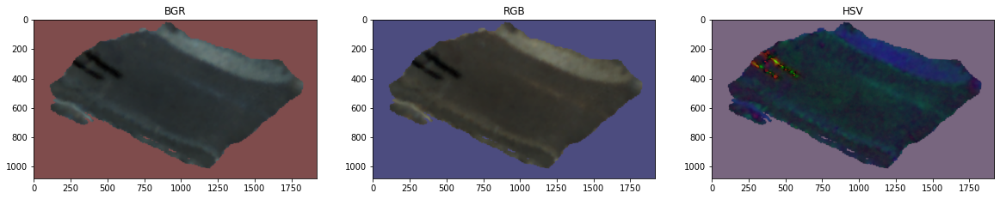

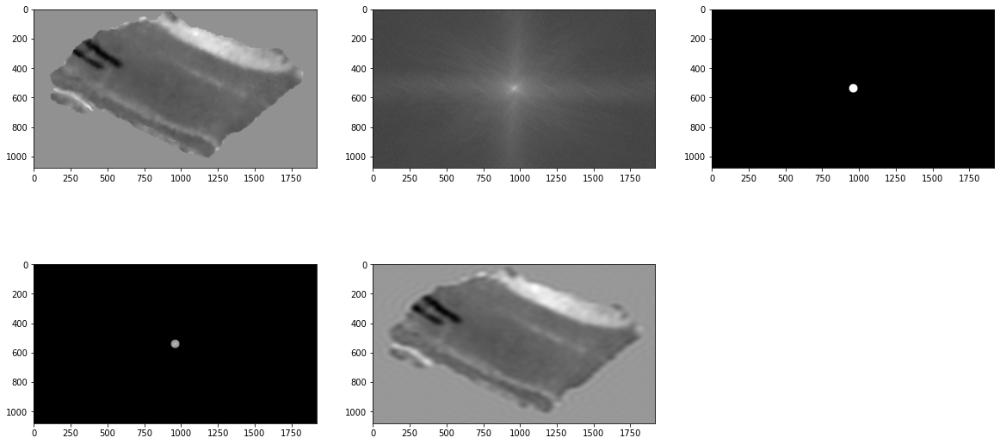

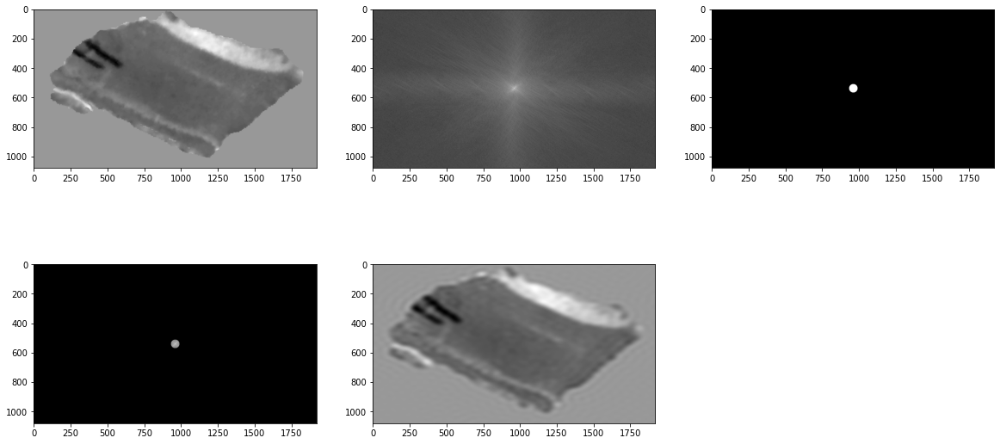

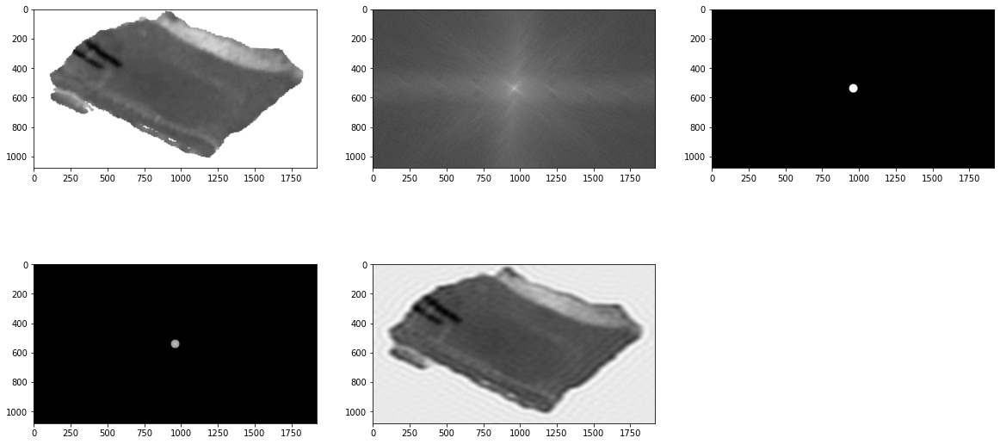

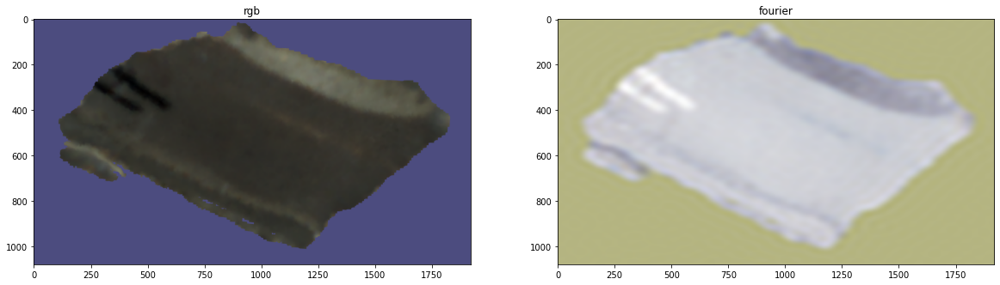

In [251]:
img_name = "RPf_00079.png"
img = cv2.imread(f"images/raw/border/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
plot_images([img,img_rgb,img_hsv],["BGR","RGB","HSV"],1,3)

r,g,b = cv2.split(img_rgb)
rows,cols = r.shape
crow,ccol = rows//2,cols//2

gauss_kernel = (51,51)

fourier_img = mask_fourier([r,g,b],
                           [
                               cv2.GaussianBlur(build_circle_mask(30,ch),gauss_kernel,0)
                            for ch in [r,g,b]])


plot_images([img_rgb,(fourier_img*255).astype(np.uint8)],["rgb","fourier"],1,2)
img_rgb=(fourier_img*255).astype(np.uint8)

In [256]:
smoothed_img = cv2.bilateralFilter(img_rgb,100,400,400) #cv2.bilateralFilter(mean_smooth_rgb(img_rpf_000102_rgb,(100,100)),9,75,75)

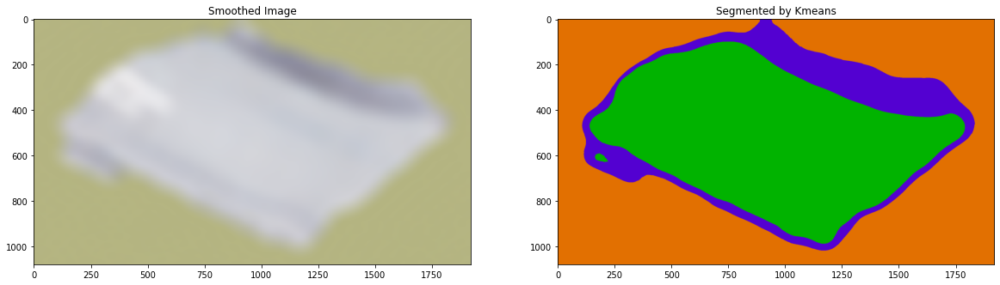

In [257]:
k=3
kmeans_img = segment_kmeans(smoothed_img,k)
plot_images([smoothed_img,(kmeans_img*255).astype(np.uint8)],["Smoothed Image","Segmented by Kmeans"],1,2)

In [ ]:
img_kmeans_gray = cv2.cvtColor((kmeans_img*255).astype(np.uint8),cv2.COLOR_RGB2GRAY)
img_edge_map = cv2.Canny(img_kmeans_gray,70,150)
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
#plt.imshow(1/(1+np.abs(img_edge_map)),cmap="gray")

img_with_lines,out_lines = draw_hough_lines(
        (kmeans_img*255).astype(np.uint8),
        img_edge_map, #1/(1+np.abs(rpf_000102_gray_edge_map))
        1*np.pi/180,min_votes=70,
        lines_color=(255,0,0))
#plt.imshow(img_with_lines)
print(out_lines)
max_theta_thresh = 0.001
min_r_thresh = 30
parrallel_lines = find_parallel_lines(out_lines,
                                      max_theta_thresh=max_theta_thresh,
                                      min_r_thresh=min_r_thresh)
print(parrallel_lines)

img_rgb_with_lines = np.copy(img_rgb)
lines_color=(255,0,0)
for parralel_pair in parrallel_lines:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1])
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
    #second_line = parralel_pair[1]
#plt.imshow(img_rgb_with_lines)
figsize=(20,20)
fig,axes = plt.subplots(1,3,figsize=figsize)
axes[0].imshow(1/(1+np.abs(img_edge_map)),cmap="gray")
axes[0].set_title("Edge Map")
for ax,image,title in zip(axes.flatten()[1:],[img_with_lines,img_rgb_with_lines],["img_with_lines","img_rgb_with_lines"]):
    ax.imshow(image)
    ax.set_title(title)

In [ ]:
img_rgb_with_lines = np.copy(img_rgb)
lines_color=(0,0,0)
for parralel_pair in parrallel_lines:
    for ln_i in range(2):
        line_ = out_lines[parralel_pair[ln_i]]
        (x11,y11),(x12,y12) = r_theta_to_points(line_[0],line_[1])
        cv2.line(img_rgb_with_lines,(x11,y11),(x12,y12),lines_color,12)
plt.imshow(img_rgb_with_lines)

In [ ]:
fragments_names.append(img_name)
print(fragments_names)

In [ ]:
for pl in parrallel_lines:
    print(str(out_lines[pl[0]]) + " ----" + str(out_lines[pl[1]]))

lines_diff = abs(out_lines[parrallel_lines[0][0]][0] - out_lines[parrallel_lines[0][1]][0])
print(lines_diff)

In [ ]:
borders_widths.append(lines_diff)
print(borders_widths)

In [ ]:
kmeans_labels = segment_kmeans_labels(smoothed_img,)

In [ ]:

label_ = 2

label_mask = np.where(kmeans_labels == label_, 1,0)

# r_,g_,b_ = cv2.split(img_rgb)
# r_ = np.where(r_==label_,r_,0)
# b_ = np.bitwise_and(b_,label_mask)
# g_ = np.bitwise_and(g_,label_mask)
# img_rgb_masked = cv2.merge((r_,g_,b_))


img = cv2.imread(f"images/raw/border/{img_name}") #cv2.imread("C:\\Users\\yaniv\\Desktop\\MSCBenGurion\\Courses\\Vision - Ohad Ben Shahar\\borders_detection\\RPf_00102.png")
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
new_img = np.copy(img_rgb)#.reshape(img_rgb.shape[0]*img_rgb.shape[1], img_rgb.shape[2])


for i in range(img_rgb.shape[0]):
    for j in range(img_rgb.shape[1]):
        if label_mask[i,j] != 1:
            new_img[i,j] = (0,0,0)
plt.imshow(new_img)

In [ ]:
img_as_vec = new_img.reshape(img_rgb.shape[0]*img_rgb.shape[1], img_rgb.shape[2])
zeros = np.zeros((1,3))
#img_as_vec = img_as_vec[np.all()]
new_vector = []

for i_row in range(img_as_vec.shape[0]):
    if not np.all(img_as_vec[i_row] == zeros):
        new_vector.append(img_as_vec[i_row])

mean_ = np.mean(new_vector,axis=0)
averaged_colors.append(mean_)
print(len(new_vector))
print(mean_)
